In [3]:
#!pip install bayesian-optimization  # for google collab
#!pip install git+https://github.com/slremy/netsapi --user --upgrade


In [4]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import mlab
from matplotlib import gridspec
%matplotlib inline

In [5]:
#challenge import
from netsapi.challenge import *
 
from sys import exit, exc_info, argv
from multiprocessing import Pool, current_process
import random as rand
import json
import requests
import numpy as np
import pandas as pd


import statistics
from IPython.display import clear_output

from contextlib import contextmanager
import sys, os
@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
import math
print("done")

done


# Utility : Neural net

In [ ]:

# action val in
x_start = 0.0
x_end = 1.0

old_action = np.array([0.0 , 0.0])
weight = np.array([0.0 , 0.0 , 0.0 , 0.0]) # todo init rand

def nn_sum(w0, w1, x1):
    return w0 + w1*x1
def nn_mul(a,b):
    return a*b
def nn_Modified_sigmoid(x):
    return nn_sigmoid(x)/2 + 0.5
def nn_sigmoid(x):
    return (math.exp( 2.0*x ) - 1.0 ) / (math.exp( 2.0*x ) + 1.0)
def nn_porte(x, mn, mx):
    return max(mn , min(x,mx) )

def nn(action):
    global old_action
    a1 = nn_sum(weight[0], weight[1], old_action)
    a2 = nn_sum(weight[0], weight[1], action)
    a3 = nn_mul(a1,a2)
    a3 = nn_Modified_sigmoid(a3)
    a4 = nn_porte(a3, x_start, x_end)
    

In [6]:
envSeqDec = ChallengeSeqDecEnvironment()
x_start = 0.0
x_end = 1.0

VAL_Max = 1.2 # fel heat map

def target1(x, y):
    x = np.asscalar(x)
    y = np.asscalar(y)
    envSeqDec.reset()
    action = [x , y]
    print("action",action)
    s,r,d,_ = envSeqDec.evaluateAction(action)
    return r/90.0    

def target(x,y):
    if type(x) is np.ndarray:
        result = []
        for a,b in zip(x,y):
            reward = target1(a,b)
            result.append( reward )
            #print((len(result) % 30 ) )
            #if ((len(result) % 30 ) > 25) : 
            #    global envSeqDec
            #    envSeqDec = ChallengeSeqDecEnvironment()
        return result
    else:
        return target1(x,y)


In [7]:
# for the training
n = 1e5
x = y = np.linspace(x_start, x_end, 300)# was 300
X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]

In [8]:
def posterior(bo, X):
    #ur = unique_rows(bo.X)
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    y_obs = np.array([res["target"] for res in bo.res])
    
    bo._gp.fit(x_obs, y_obs)
    
    mu, sigma = bo._gp.predict(X, return_std=True)
    return mu, sigma

def plot_2d(name=None):

    #mu, s, ut = posterior(bo, X)
    mu, s = posterior(bo, X)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10))
    gridsize=150

    # fig.suptitle('Bayesian Optimization in Action', fontdict={'size':30})
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    # GP regression output
    ax[0][0].set_title('Gausian Process Predicted Mean; max='+str(round(np.amax(mu)*90,0))+" min="+str(round(np.amin(mu)*90,0)), fontdict={'size':15})
    im00 = ax[0][0].hexbin(x, y, C=mu, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][0].axis([x.min(), x.max(), y.min(), y.max()])
    ax[0][0].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k', label='Observations')

    ax[0][1].set_title('Target Function', fontdict={'size':15})
    """
    im10 = ax[0][1].hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][1].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][1].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k')
    ax[0][1].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k')
    """

    ax[1][0].set_title('Gausian Process Variance', fontdict={'size':15})
    im01 = ax[1][0].hexbin(x, y, C=s, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=1)
    ax[1][0].axis([x.min(), x.max(), y.min(), y.max()])

    ax[1][1].set_title('Acquisition Function', fontdict={'size':15})
    # acquisition func
    """
    im11 = ax[1][1].hexbin(x, y, C=ut, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=8)

    np.where(ut.reshape((300, 300)) == ut.max())[0]
    np.where(ut.reshape((300, 300)) == ut.max())[1]

    ax[1][1].plot([np.where(ut.reshape((300, 300)) == ut.max())[1]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[1]/50.], 
                  [0, 6], 
                  'k-', lw=2, color='k')

    ax[1][1].plot([0, 6],
                  [np.where(ut.reshape((300, 300)) == ut.max())[0]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[0]/50.], 
                  'k-', lw=2, color='k')

    ax[1][1].axis([x.min(), x.max(), y.min(), y.max()])
    """
    for im, axis in zip([im00, im01], ax.flatten()):#, im10, im11
        cb = fig.colorbar(im, ax=axis)
        # cb.set_label('Value')

    if name is None:
        name = '_'

    plt.tight_layout()

    # Save or show figure?
    # fig.savefig('bo_eg_' + name + '.png')
    plt.show()
    plt.close(fig)


|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5665539165981627, 0.11008505159892779]
105  Evaluations Remaining
|  1        |  0.5164   |  0.5666   |  0.1101   |
action [0.2550646060657892, 0.8679509307781125]
104  Evaluations Remaining
|  2        |  0.05172  |  0.2551   |  0.868    |
action [0.6692770917471511, 0.5594494199642508]
103  Evaluations Remaining
|  3        |  0.0297   |  0.6693   |  0.5594   |
action [0.25741110520086585, 0.6107479637491672]
102  Evaluations Remaining
|  4        |  0.1696   |  0.2574   |  0.6107   |
action [0.7652389592764027, 0.5991208382113109]
101  Evaluations Remaining
|  5        |  0.04016  |  0.7652   |  0.5991   |


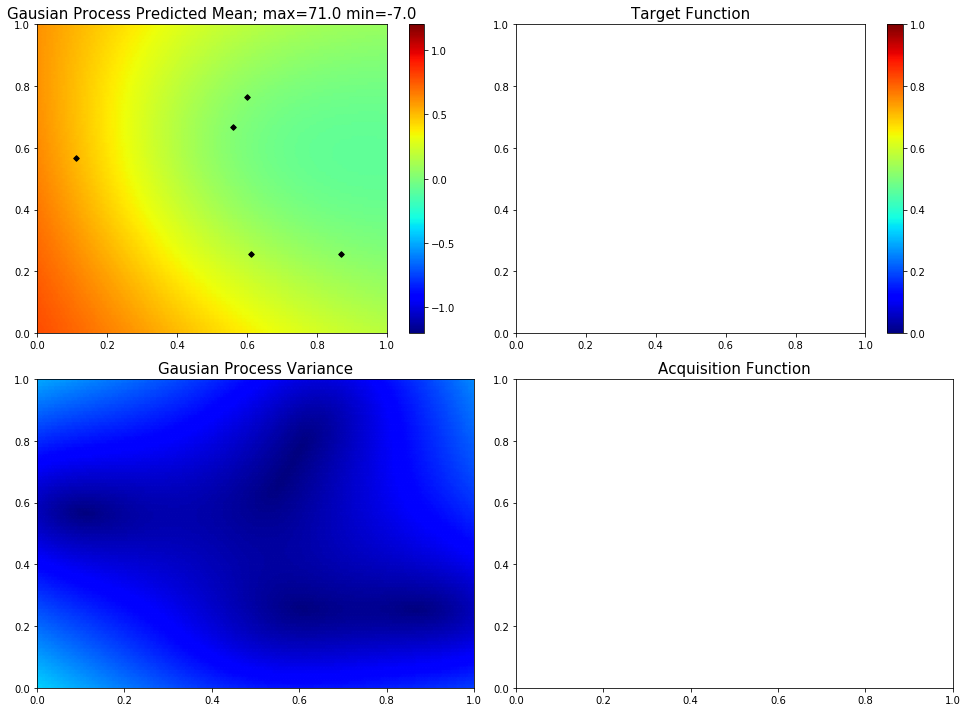

In [9]:
bo = BayesianOptimization(target, {'x': (x_start, x_end), 'y': (x_start, x_end)})

used_kappa = 10

bo.maximize(init_points=5, n_iter=0, acq='ucb', kappa=used_kappa)

plot_2d()

In [52]:
from math import sqrt
def invRL(policy):
    old_policy = [0.0, 0.0]
    seq = [] # 0.0
    for year in range(5):
        trans_policy = policy[year]
        trans_policy[0] *= (1.0 - old_policy[0])
        trans_policy[1] *= (1.0 - old_policy[1])

        r_mu, r_sigma = bo._gp.predict([trans_policy], return_std=True)
        print("invRL y", year+1 , ": ",round(r_mu[0]*90.0)," +- ", round(sqrt(r_sigma[0]*90.0) ) ) # ben lezem +- el racine bte3ha
        old_policy = policy[year]
        seq.append(r_mu*90) 
    return seq, np.sum(seq)


def testHolePolicy(policy):
    global envSeqDec
    envSeqDec.reset()
    year=0
    tot=0.0
    seq=[]
    while True:
        action =  policy[year]
        nextstate, reward, done, _ = envSeqDec.evaluateAction(list(action))
        print("test y", year+1 , ": ",round(reward))
        seq.append(reward)
        tot += reward
        if done:
            break
        year+=1
    return seq,tot

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.0]
100  Evaluations Remaining
|  6        |  0.03194  |  0.0      |  0.0      |
myplot:  006


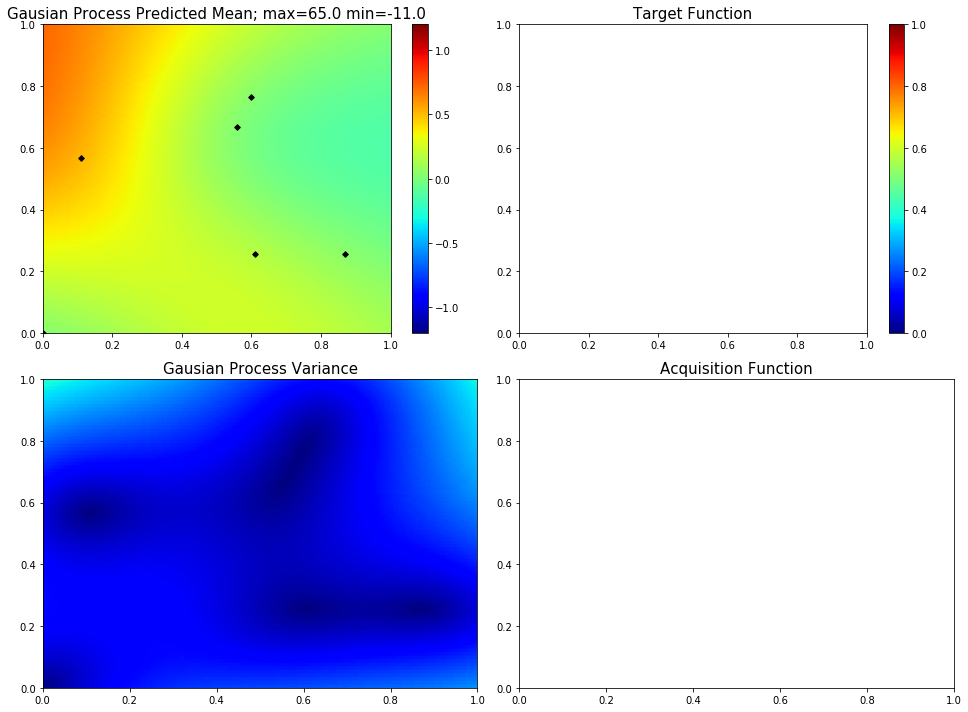

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.0]
99  Evaluations Remaining
|  7        |  1.147    |  1.0      |  0.0      |
myplot:  007


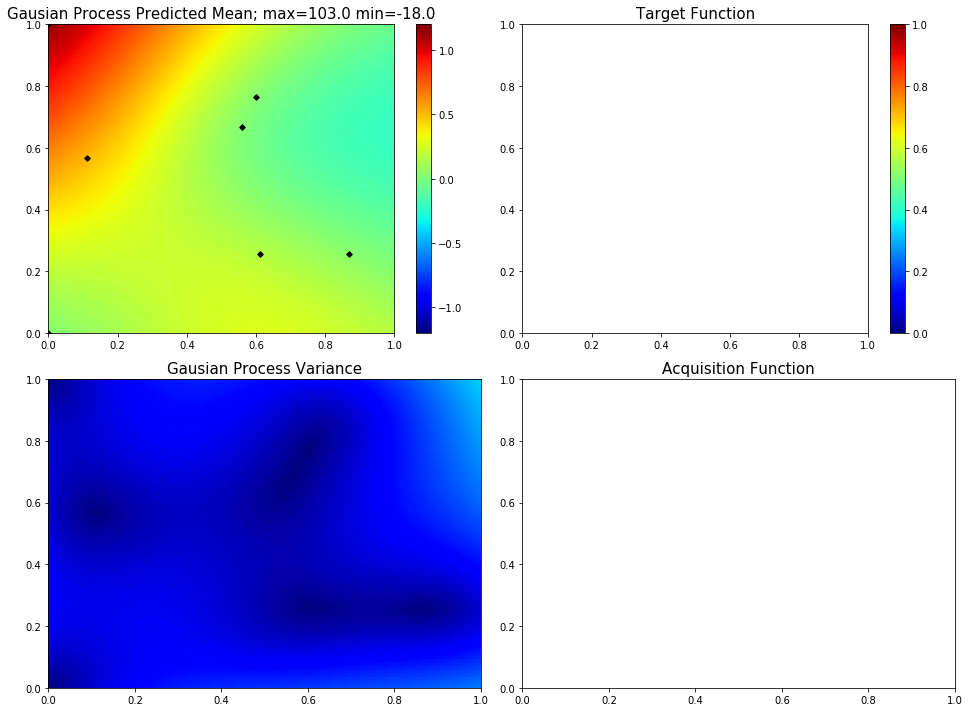

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 1.0]
98  Evaluations Remaining
|  8        |  0.1726   |  1.0      |  1.0      |
myplot:  008


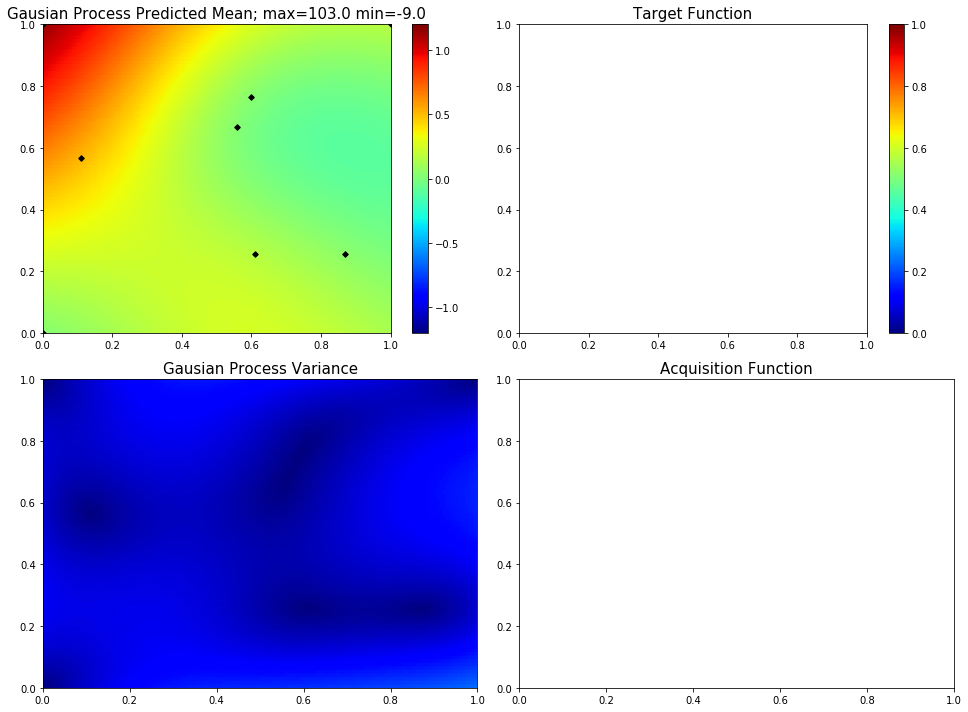

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 1.0]
97  Evaluations Remaining
|  9        |  1.055    |  0.0      |  1.0      |
myplot:  009


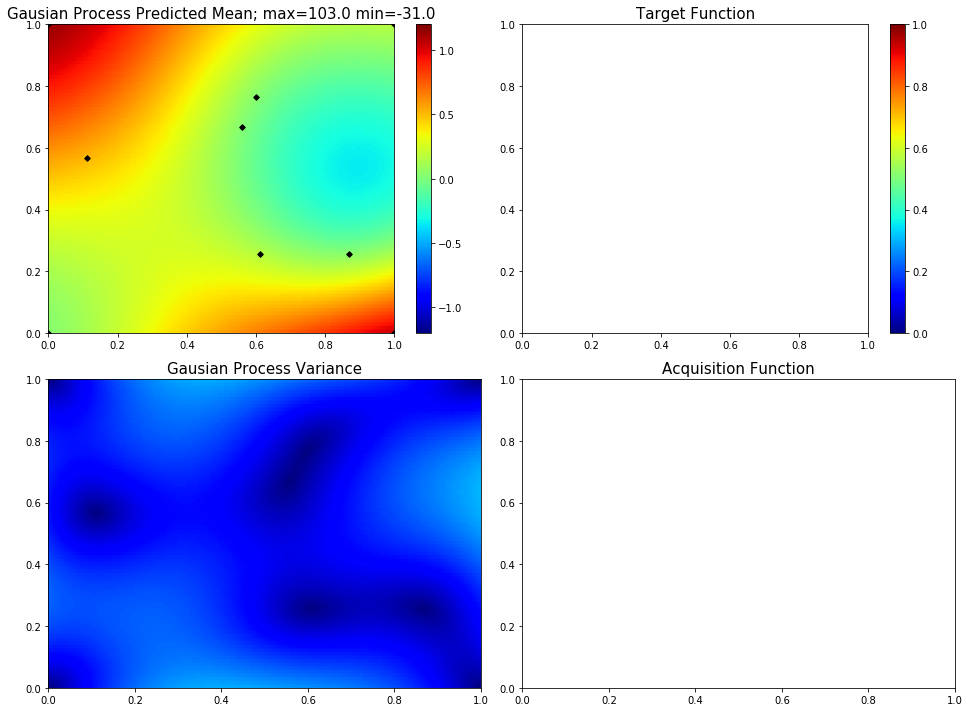

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.3227923565449877]
96  Evaluations Remaining
|  10       |  0.4656   |  1.0      |  0.3228   |
myplot:  010


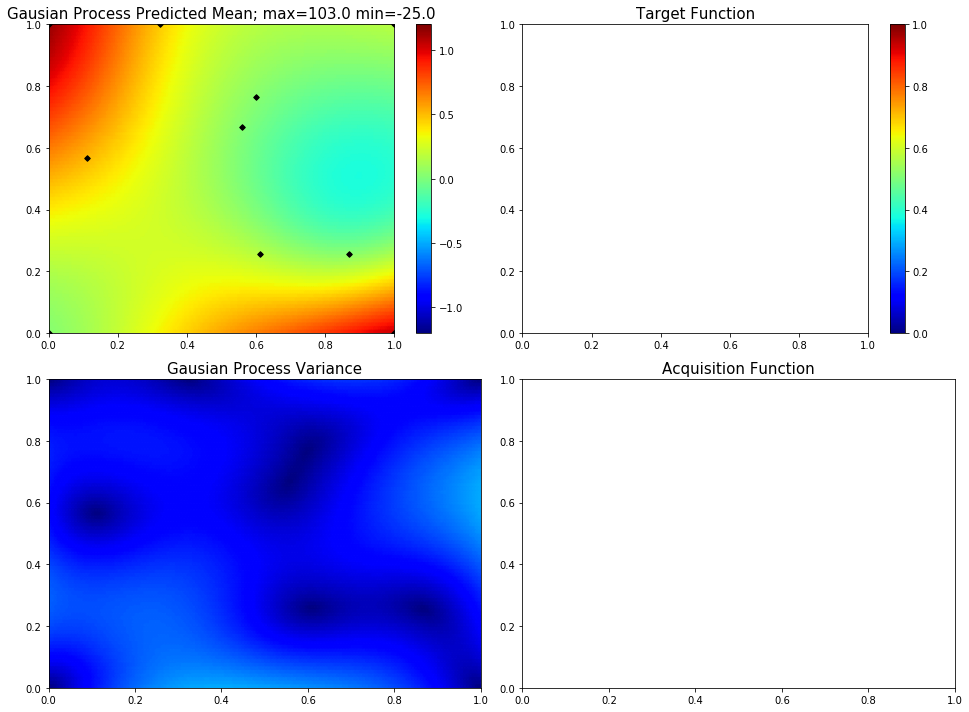

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.4507394972954348]
95  Evaluations Remaining
|  11       |  0.2246   |  0.0      |  0.4507   |
myplot:  011


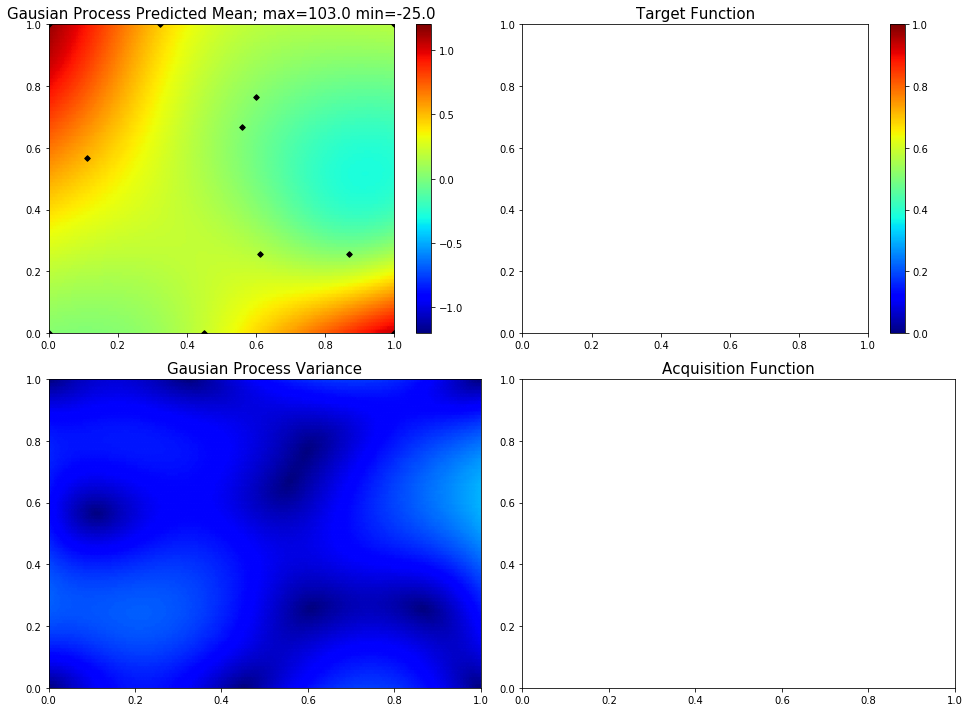

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6374900269608833, 1.0]
94  Evaluations Remaining
|  12       |  0.1605   |  0.6375   |  1.0      |
myplot:  012


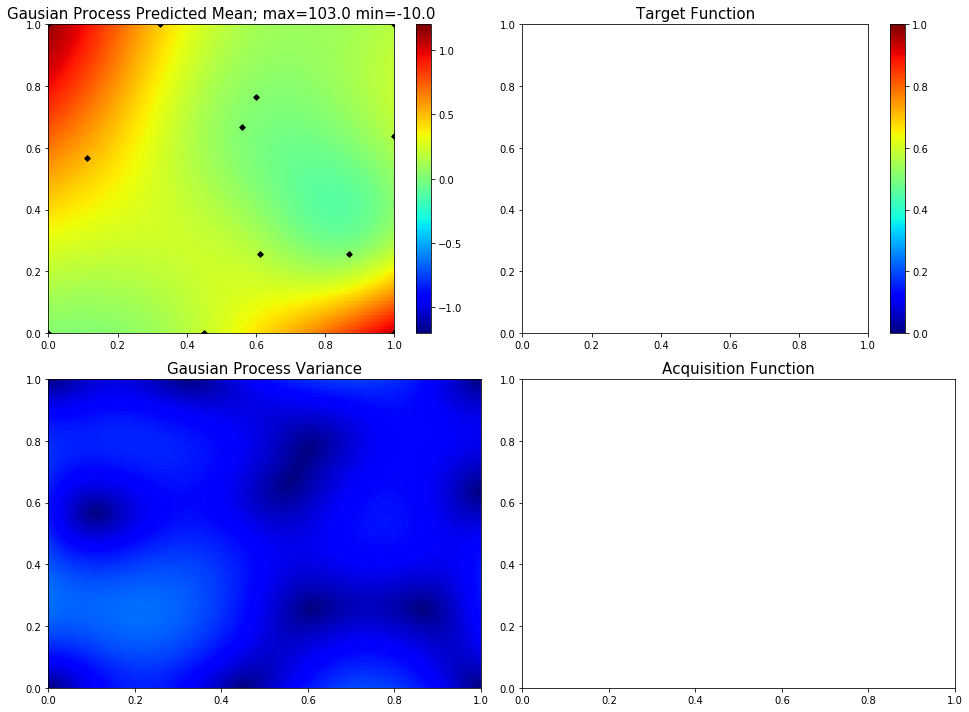

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.31480879471486634, 0.0]
93  Evaluations Remaining
|  13       |  0.07448  |  0.3148   |  0.0      |
myplot:  013


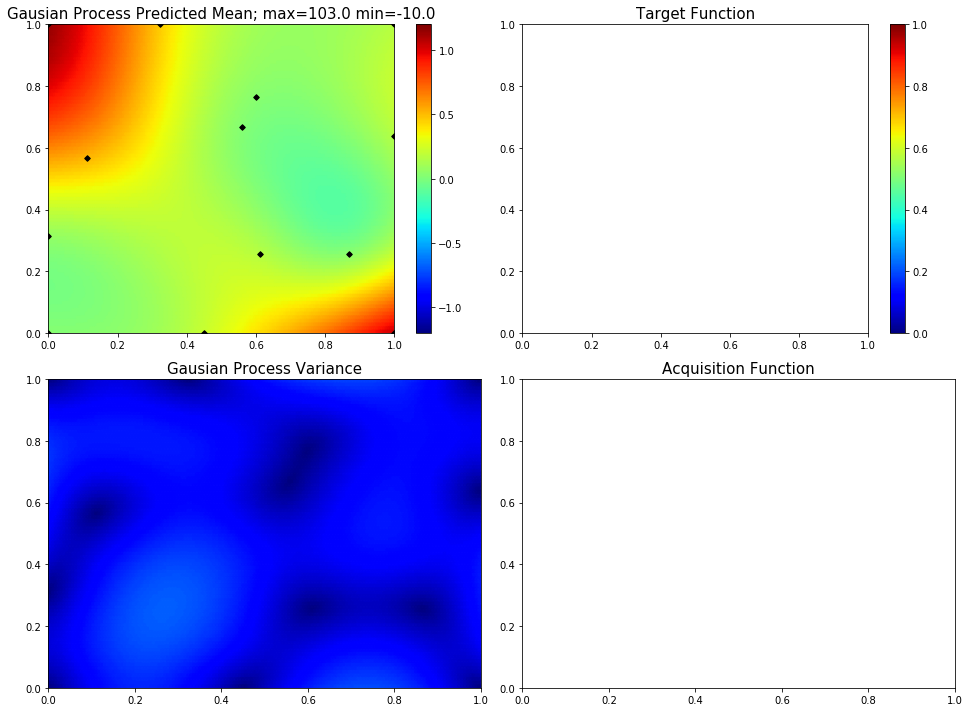

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7777268191265759, 0.0]
92  Evaluations Remaining
|  14       |  0.6187   |  0.7777   |  0.0      |
myplot:  014


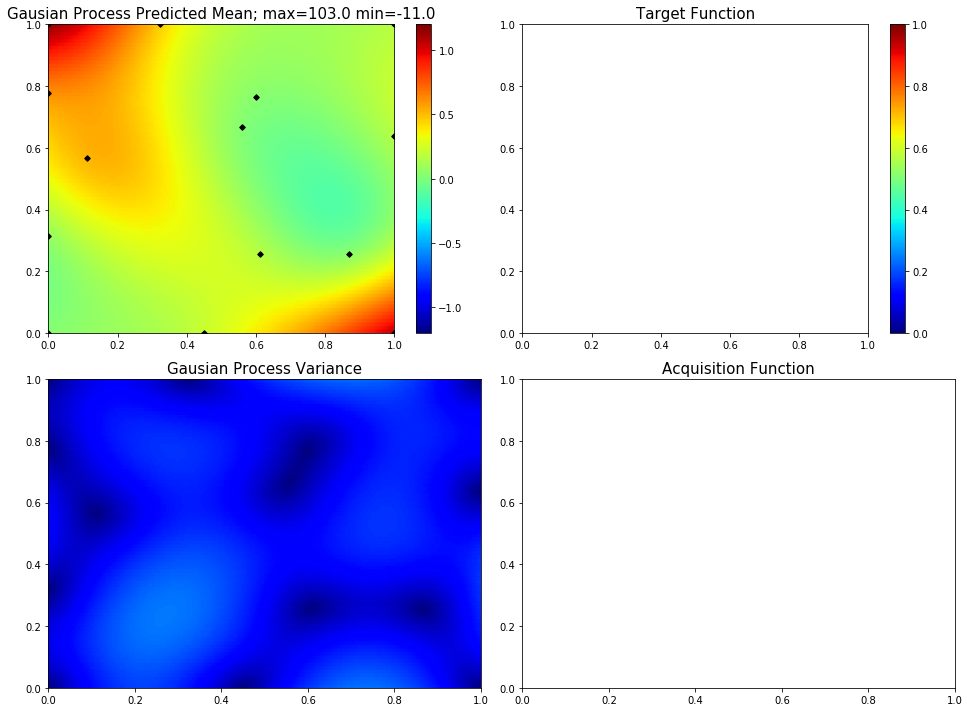

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.75890264354705]
91  Evaluations Remaining
|  15       |  1.201    |  0.0      |  0.7589   |
myplot:  015


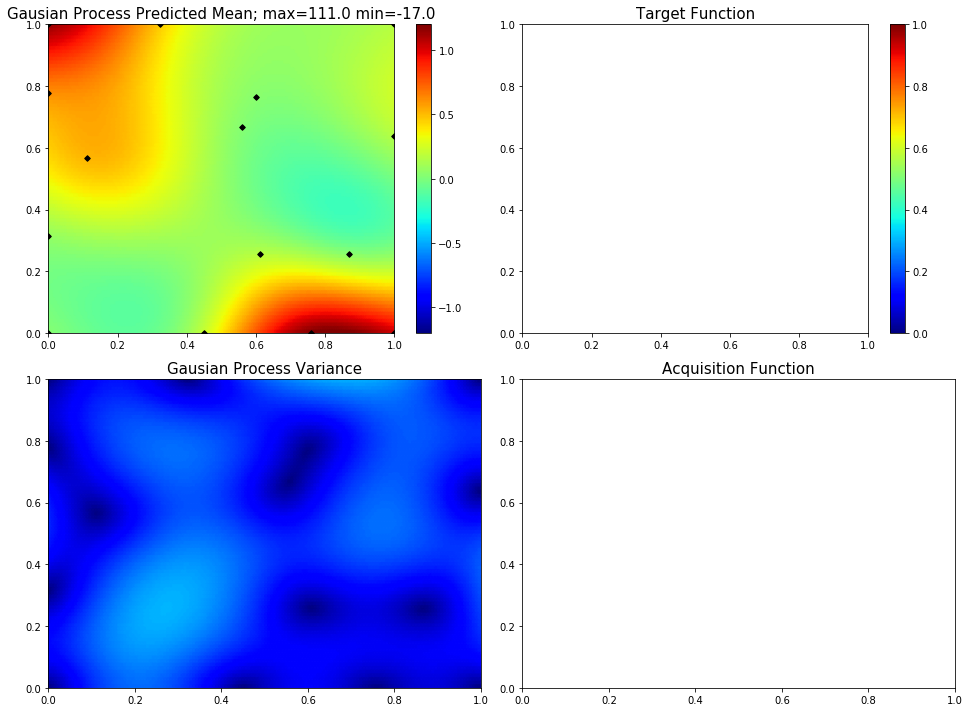

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3056401874002493, 0.2865476188073189]
90  Evaluations Remaining
|  16       | -0.2341   |  0.3056   |  0.2865   |
myplot:  016


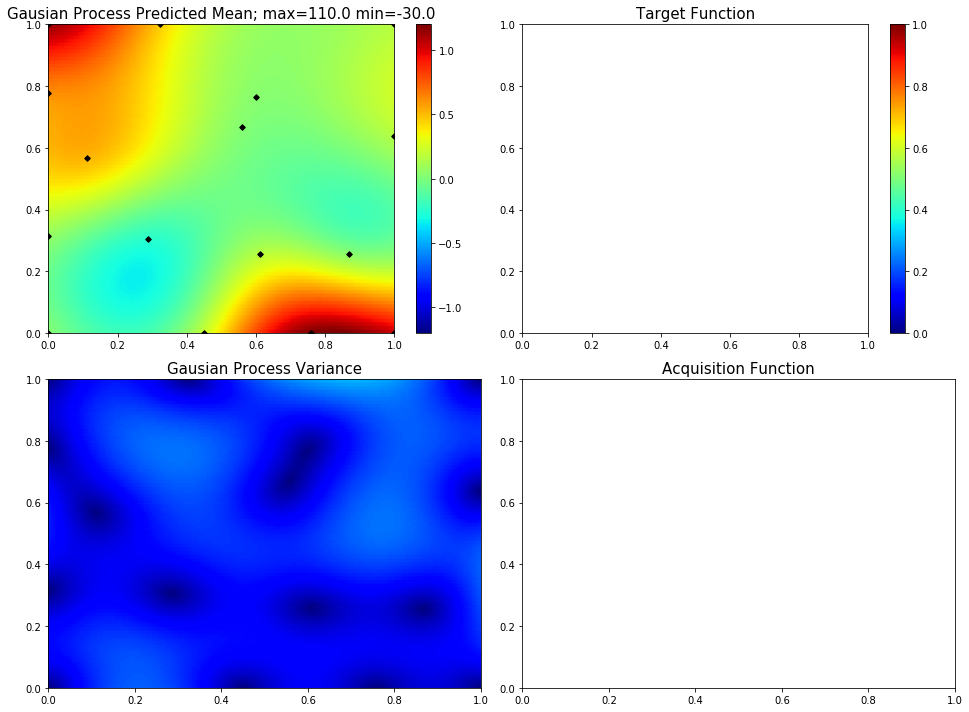

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.7063864490366042]
89  Evaluations Remaining
|  17       | -0.2868   |  1.0      |  0.7064   |
myplot:  017


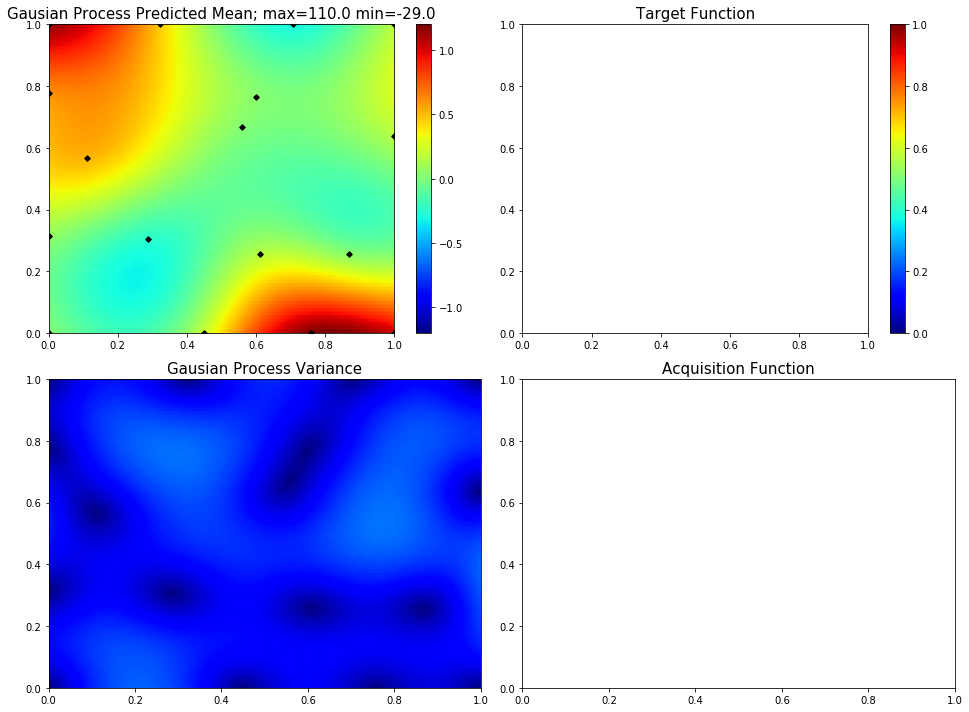

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7716525408748998, 0.25817946908613704]
88  Evaluations Remaining
|  18       |  0.3251   |  0.7717   |  0.2582   |
myplot:  018


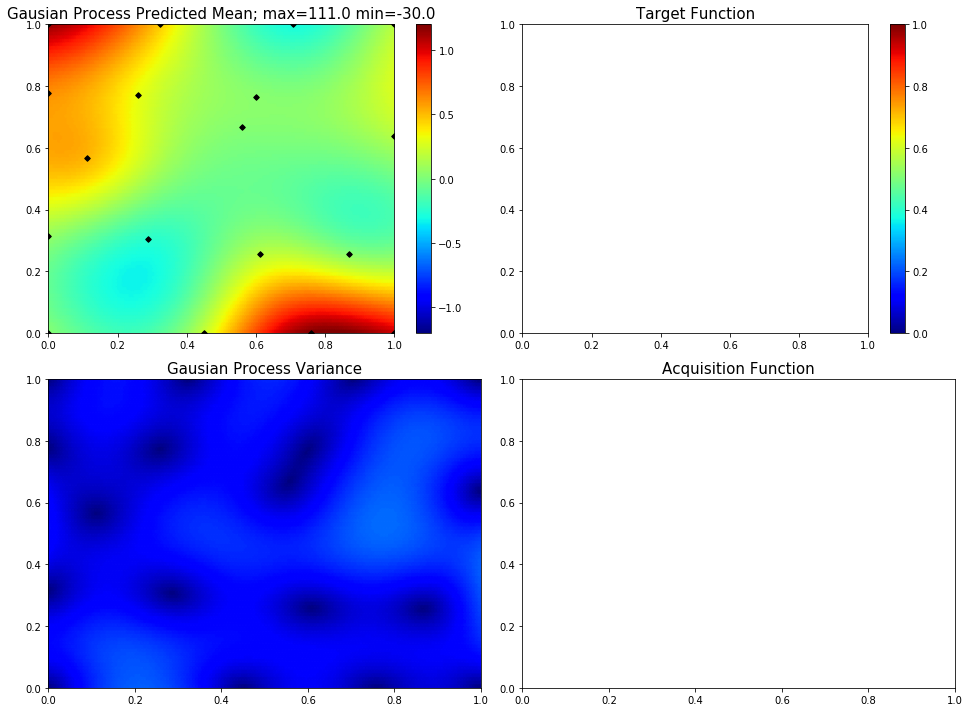

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.1364113292799097]
87  Evaluations Remaining
|  19       |  0.04201  |  1.0      |  0.1364   |
myplot:  019


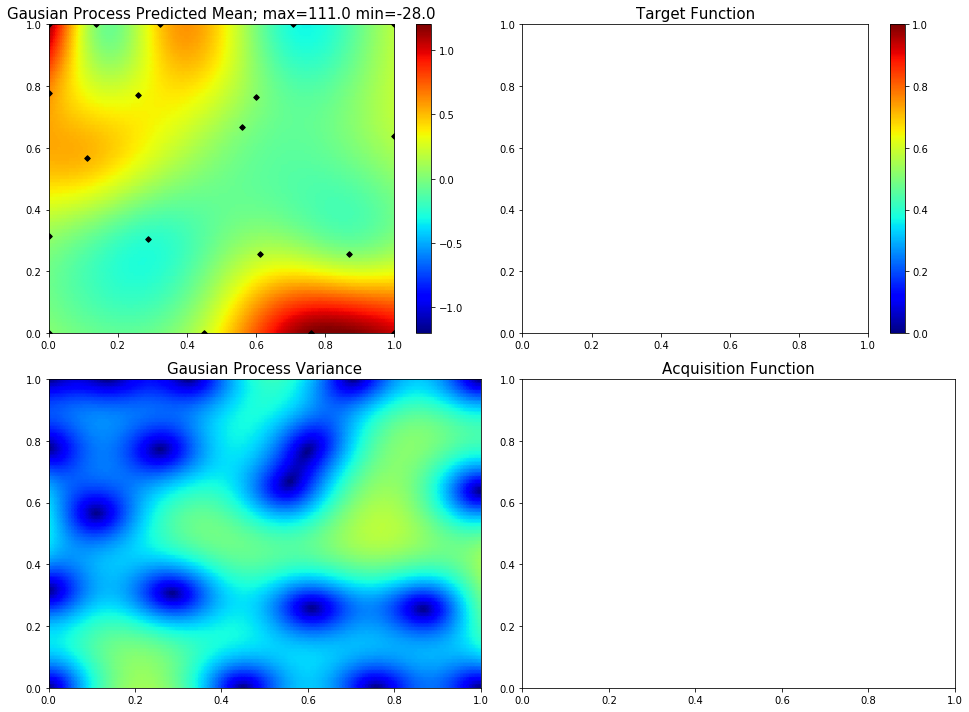

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5231162392668942, 0.7722778553428804]
86  Evaluations Remaining
|  20       |  0.3642   |  0.5231   |  0.7723   |
myplot:  020


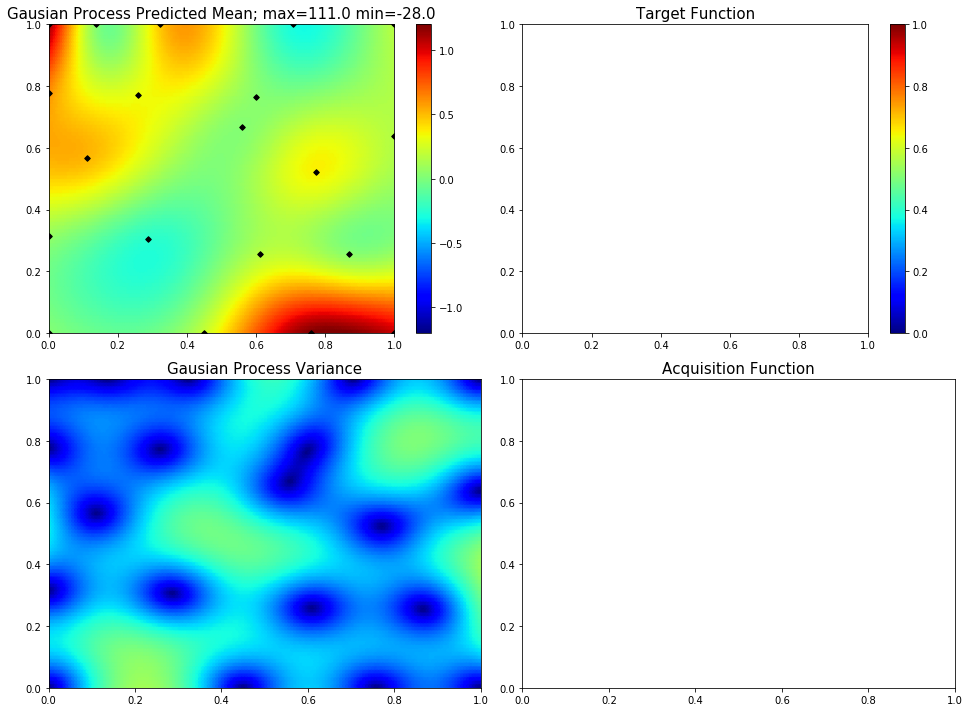

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.21967575968116673]
85  Evaluations Remaining
|  21       |  0.3107   |  0.0      |  0.2197   |
myplot:  021


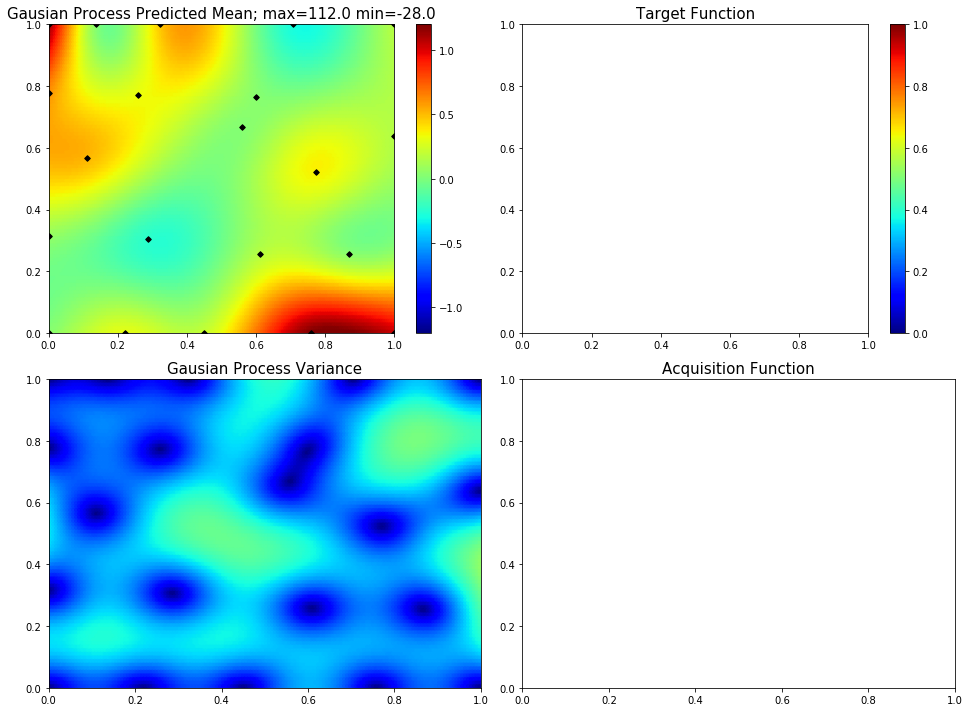

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.40554684228620286, 1.0]
84  Evaluations Remaining
|  22       |  0.4723   |  0.4055   |  1.0      |
myplot:  022


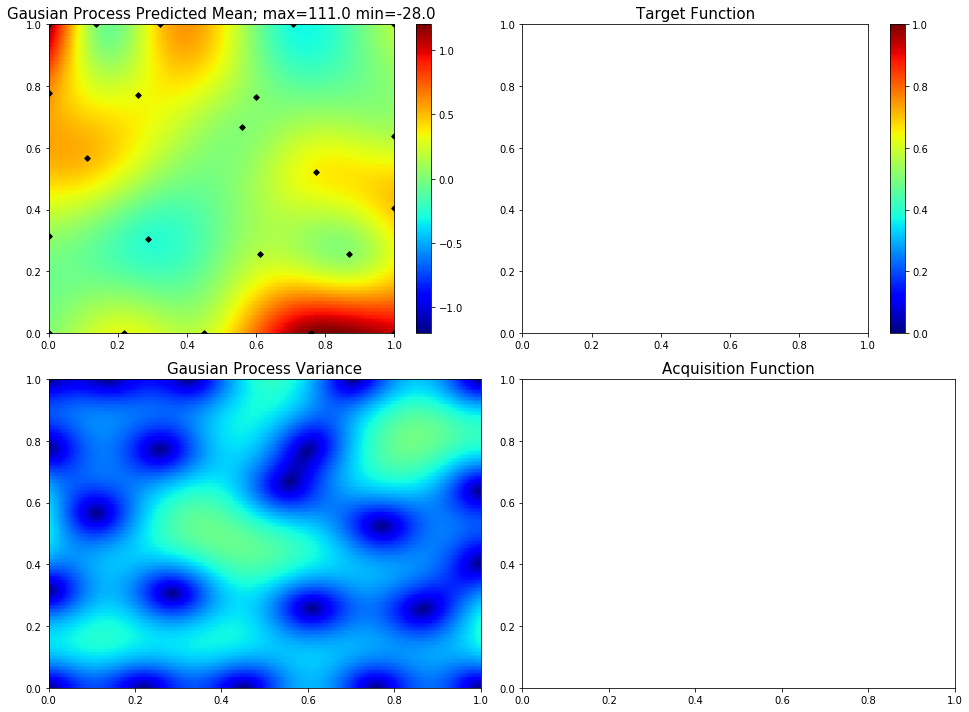

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5243760465566971, 0.361016838856005]
83  Evaluations Remaining
|  23       |  0.04107  |  0.5244   |  0.361    |
myplot:  023


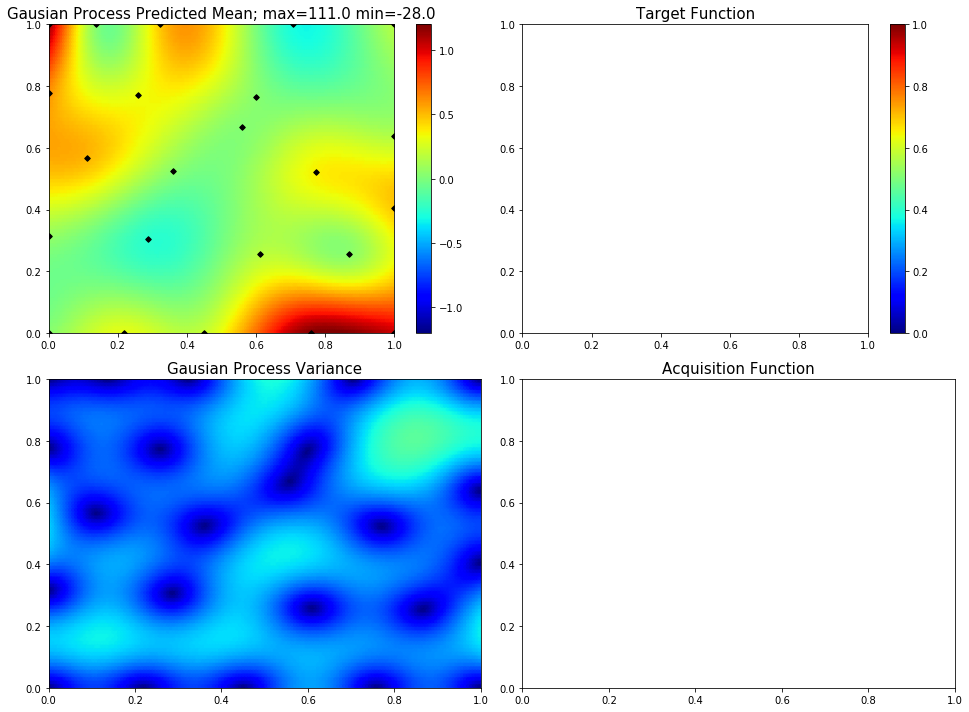

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8038238585558694, 0.8514193433785308]
82  Evaluations Remaining
|  24       | -0.08578  |  0.8038   |  0.8514   |
myplot:  024


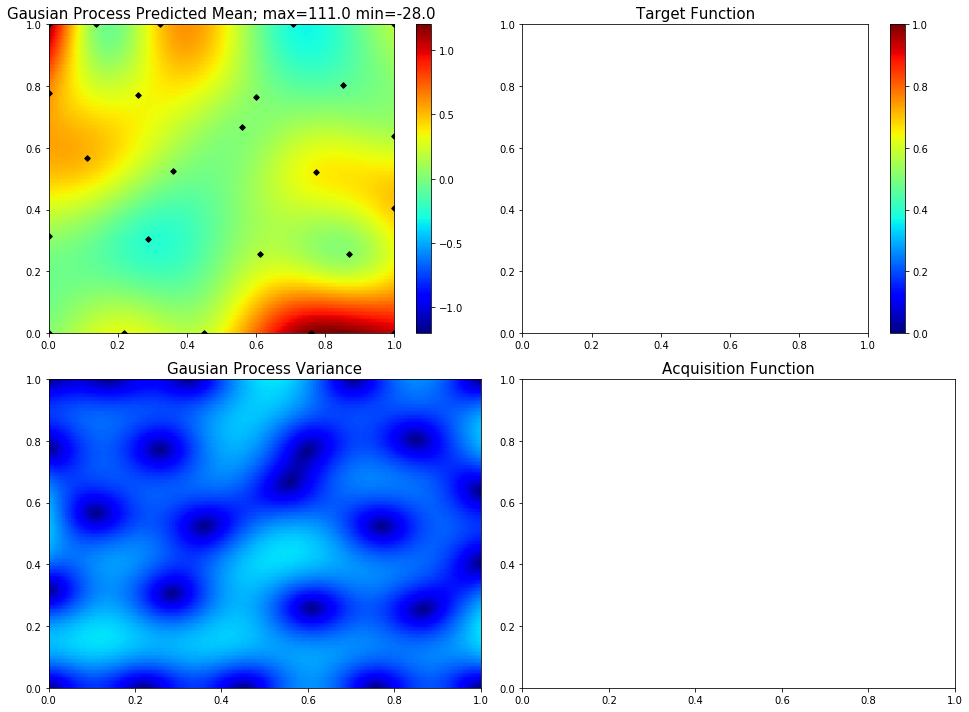

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.5029829319049569]
81  Evaluations Remaining
|  25       |  0.5292   |  1.0      |  0.503    |
myplot:  025


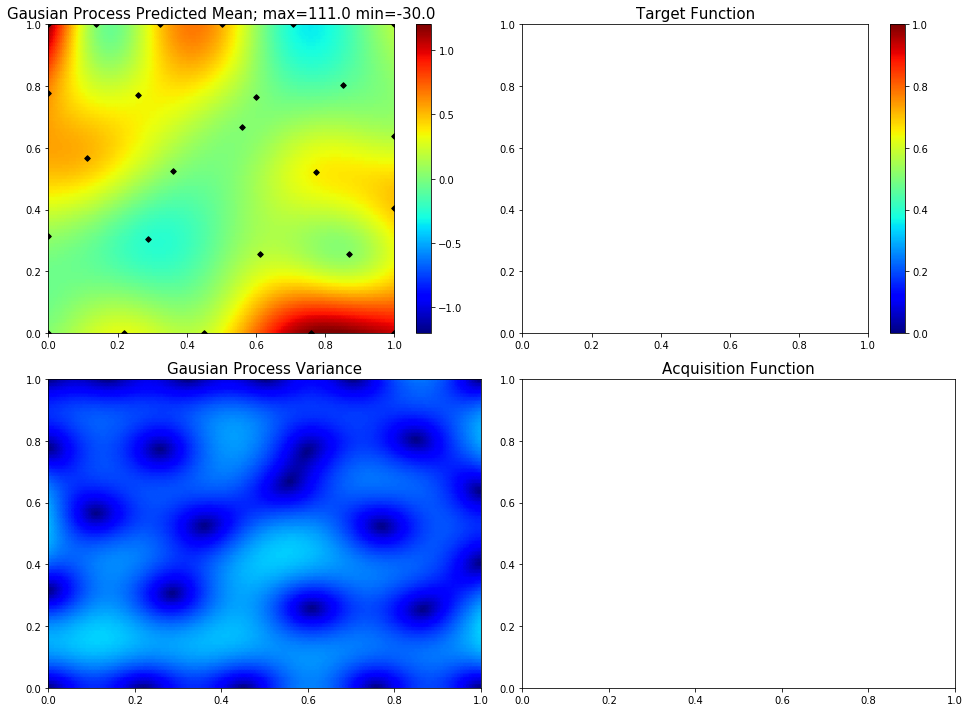

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16498001544649146, 1.0]
80  Evaluations Remaining
|  26       |  0.7581   |  0.165    |  1.0      |
myplot:  026


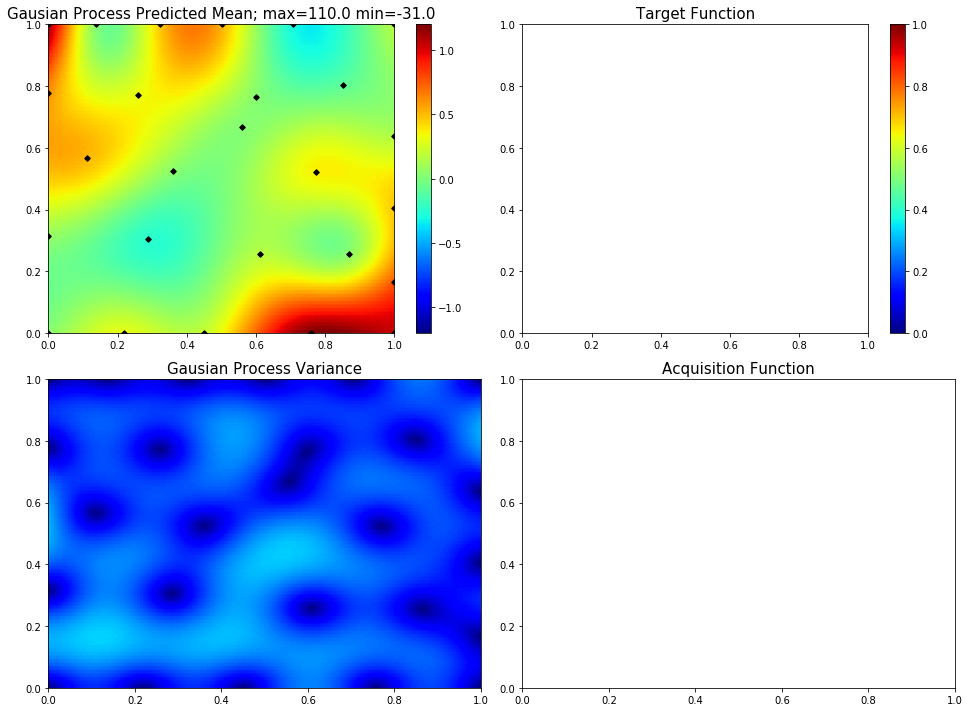

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5301325959855033, 0.0]
79  Evaluations Remaining
|  27       |  0.3041   |  0.5301   |  0.0      |
myplot:  027


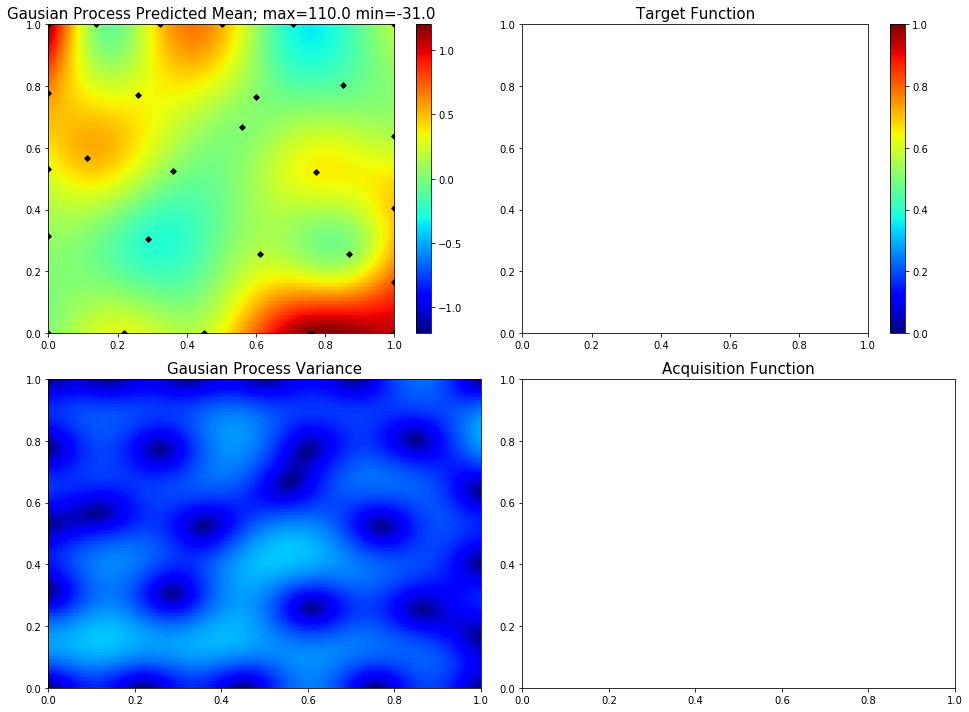

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.6215092497893518]
78  Evaluations Remaining
|  28       |  0.4192   |  0.0      |  0.6215   |
myplot:  028


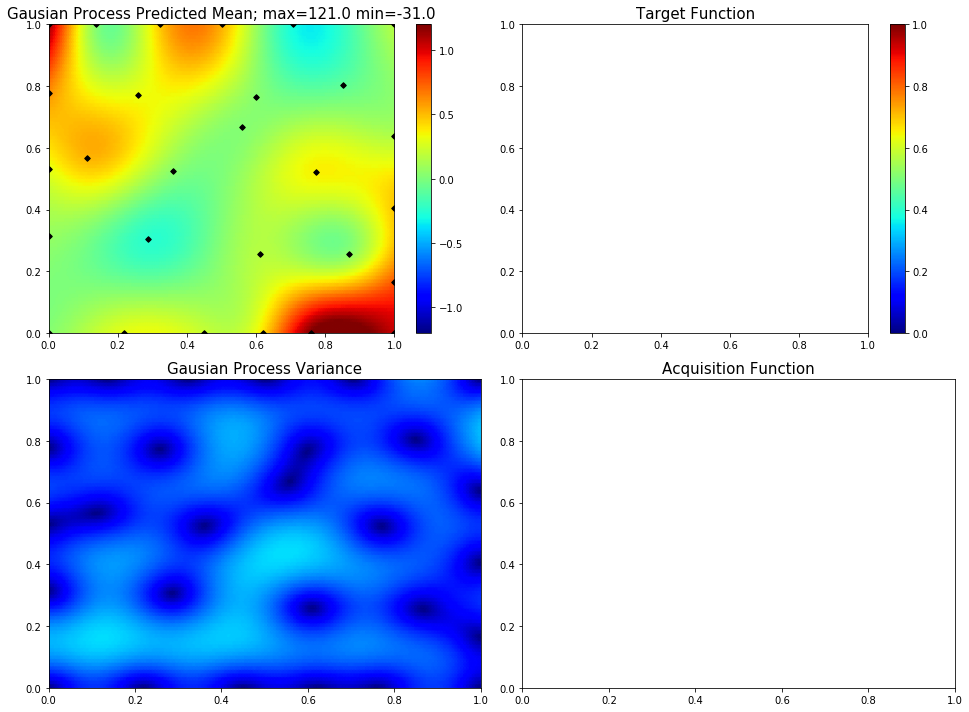

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4410456840438204, 0.5667536288539374]
77  Evaluations Remaining
|  29       |  0.04835  |  0.441    |  0.5668   |
myplot:  029


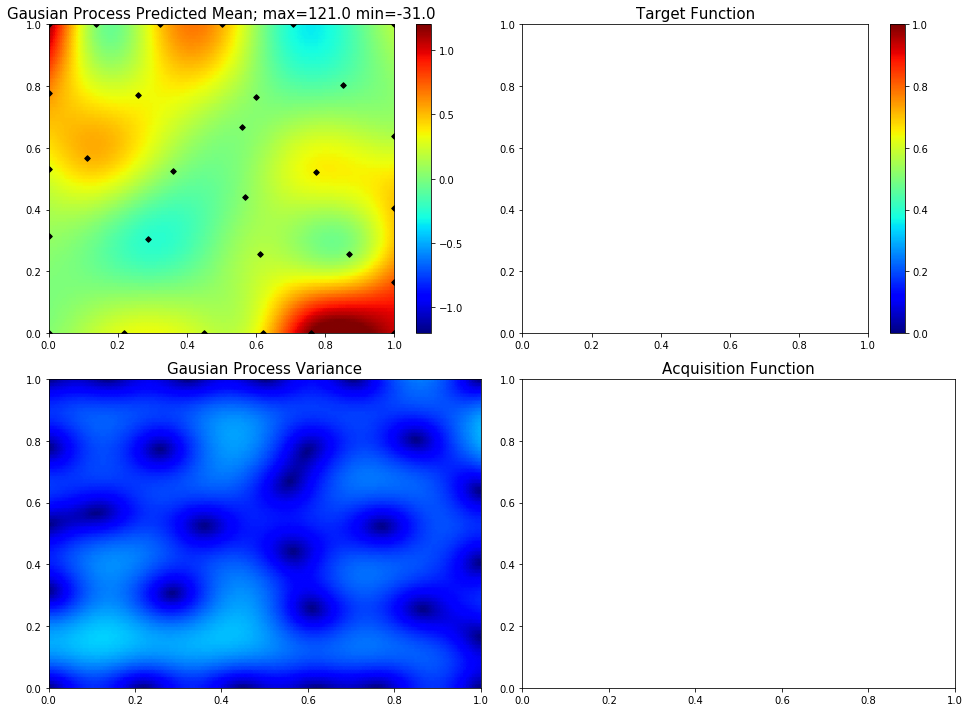

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.15506220843635704, 0.1212103787059005]
76  Evaluations Remaining
|  30       | -0.01661  |  0.1551   |  0.1212   |
myplot:  030


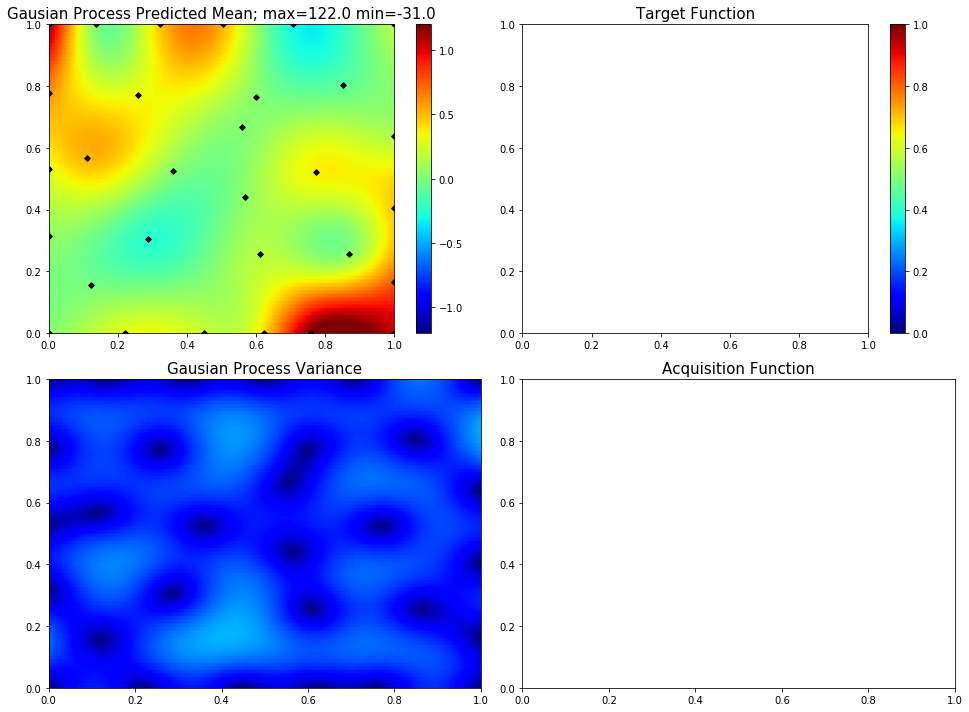

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.84058373093811, 0.42610429565349495]
75  Evaluations Remaining
|  31       |  0.2664   |  0.8406   |  0.4261   |
myplot:  031


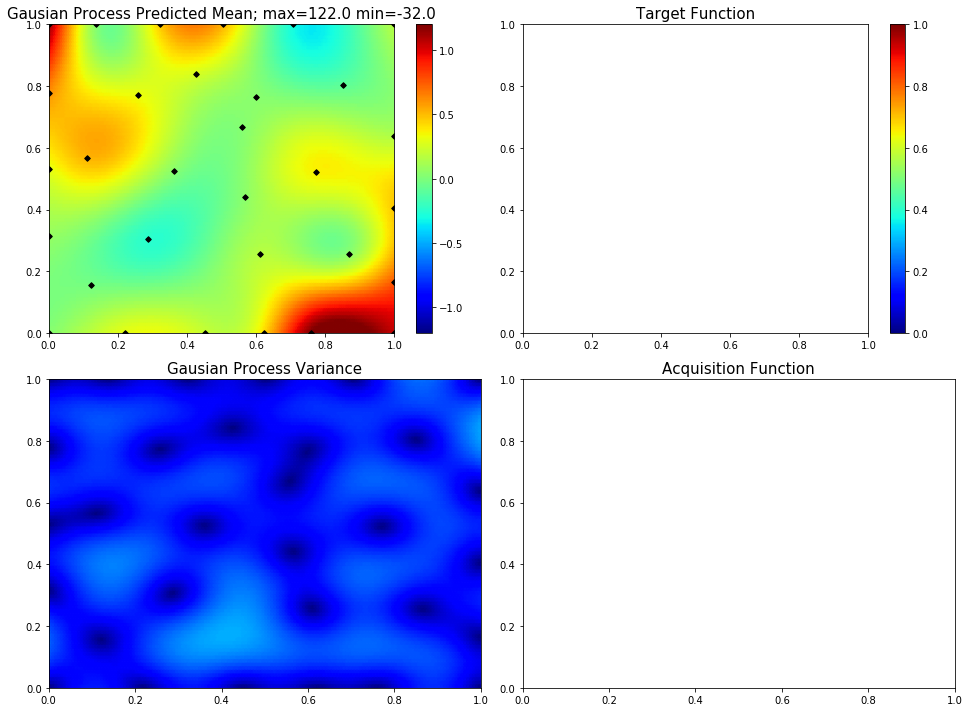

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.06297104514812432, 0.8783698983388886]
74  Evaluations Remaining
|  32       |  0.8572   |  0.06297  |  0.8784   |
myplot:  032


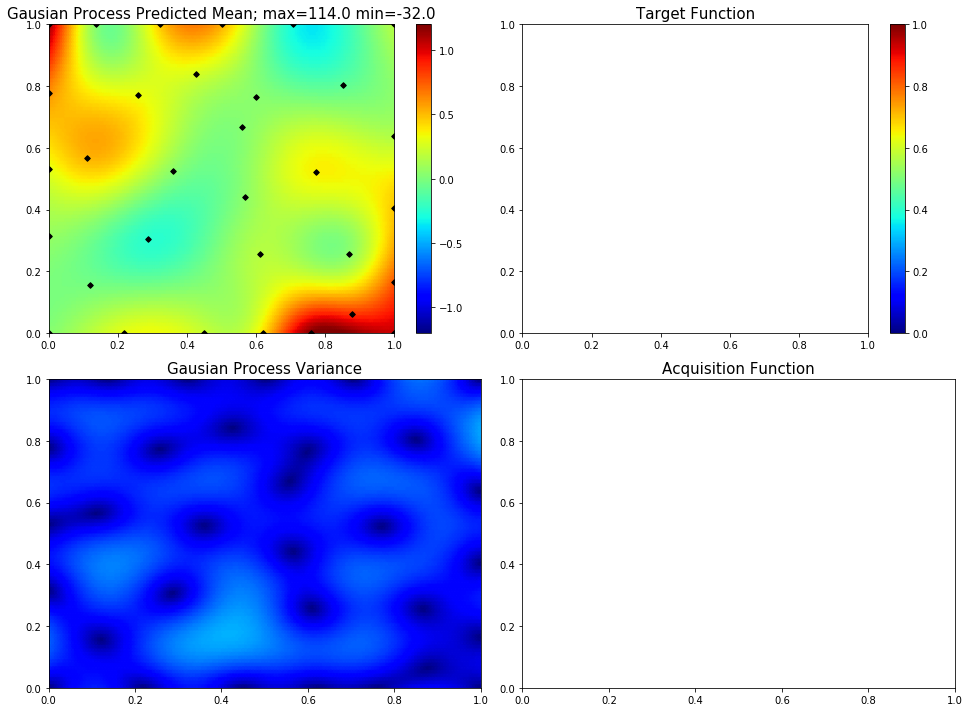

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16646095638566571, 0.42218691035451844]
73  Evaluations Remaining
|  33       |  0.09661  |  0.1665   |  0.4222   |
myplot:  033


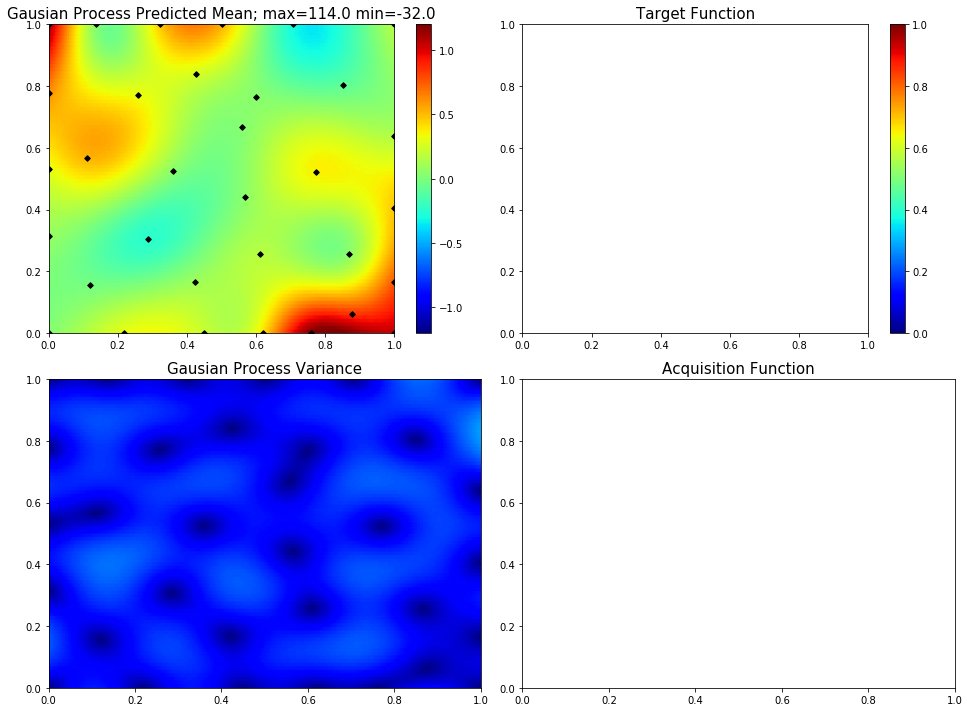

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8325237998469873, 1.0]
72  Evaluations Remaining
|  34       |  0.07586  |  0.8325   |  1.0      |
myplot:  034


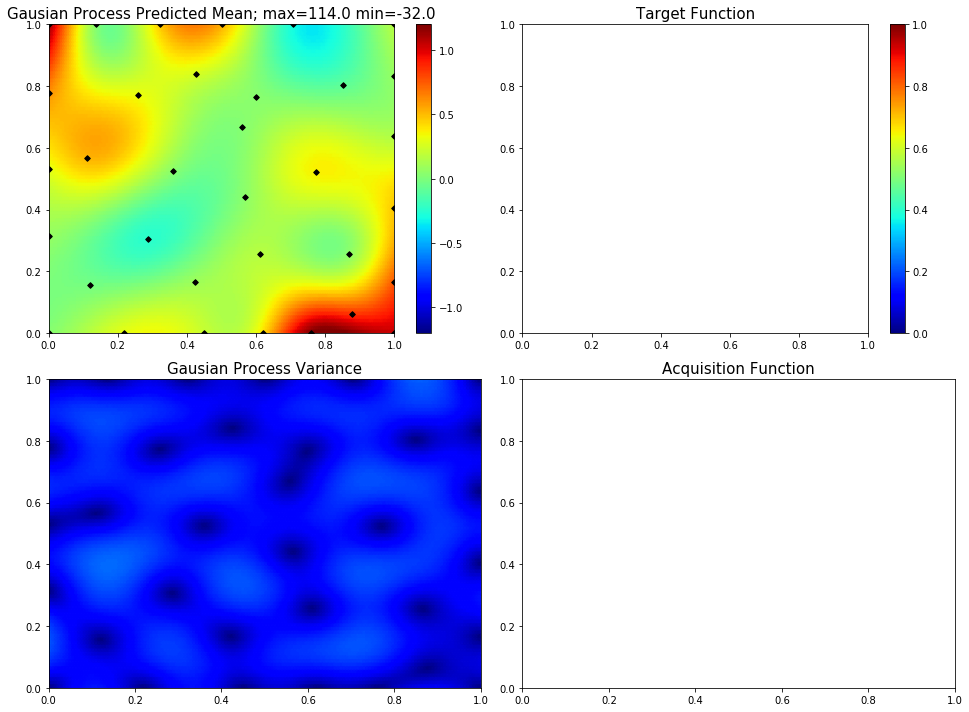

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.11505214656831034, 0.7228228875657575]
71  Evaluations Remaining
|  35       |  0.471    |  0.1151   |  0.7228   |
myplot:  035


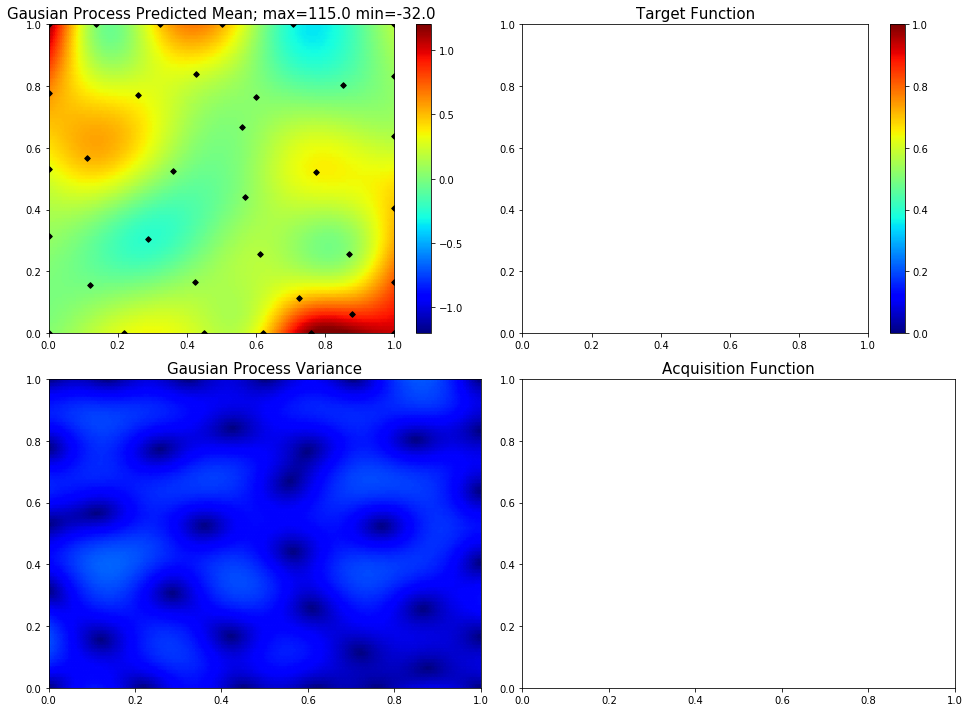

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.903704203369571, 0.0]
70  Evaluations Remaining
|  36       |  0.8265   |  0.9037   |  0.0      |
myplot:  036


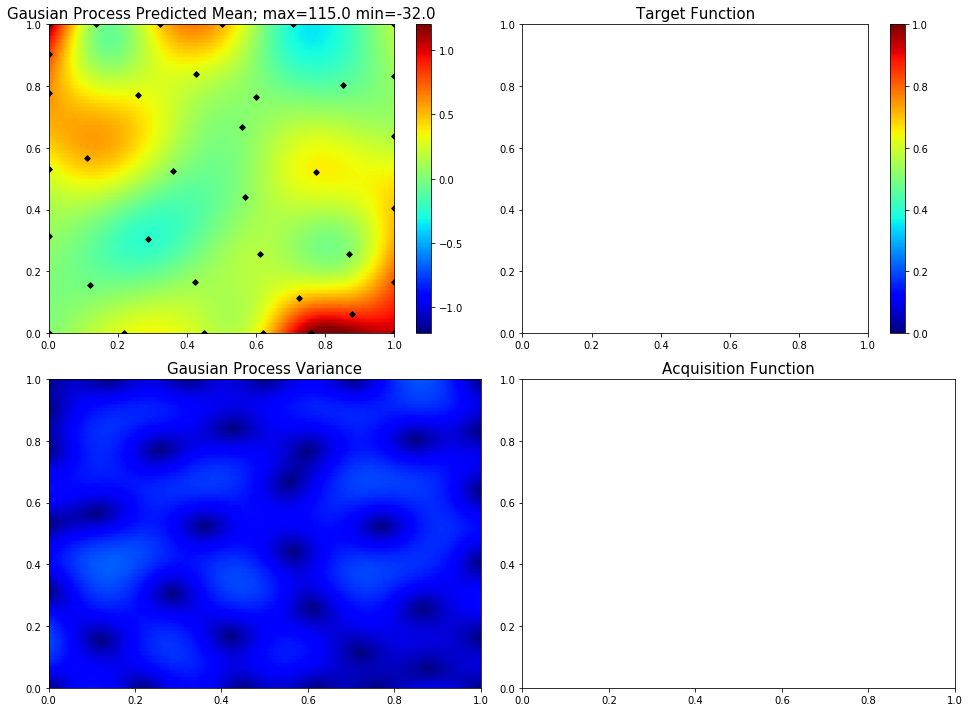

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4143225069167034, 0.135942791529503]
69  Evaluations Remaining
|  37       | -0.3108   |  0.4143   |  0.1359   |
myplot:  037


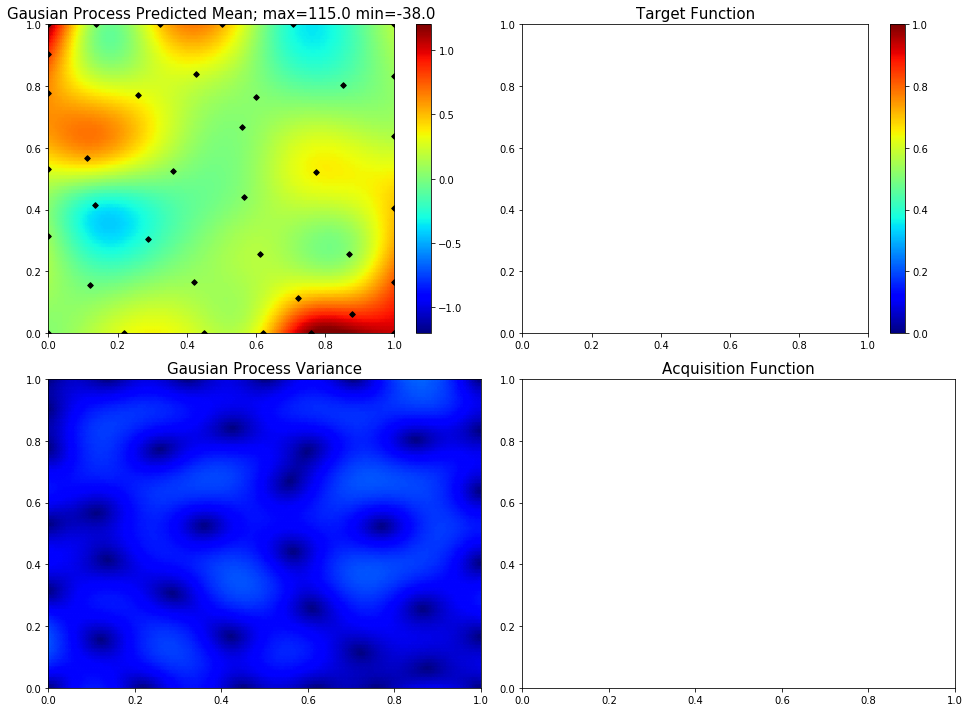

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6630948144031131, 0.7495532064336831]
68  Evaluations Remaining
|  38       |  0.4309   |  0.6631   |  0.7496   |
myplot:  038


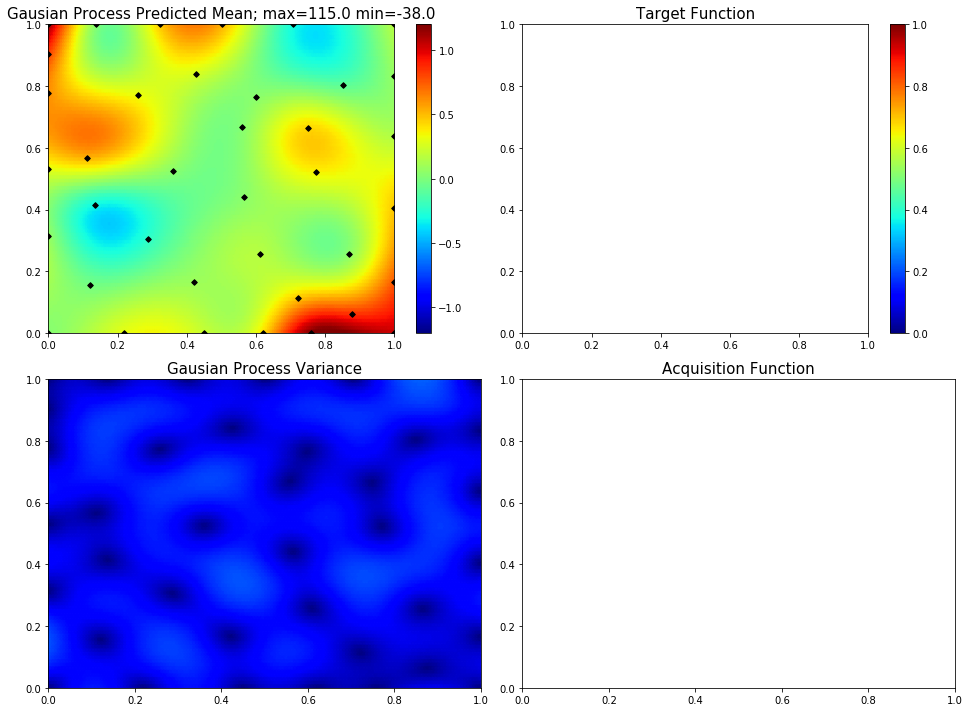

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7176141050017639, 0.11900886383638158]
67  Evaluations Remaining
|  39       |  0.6693   |  0.7176   |  0.119    |
myplot:  039


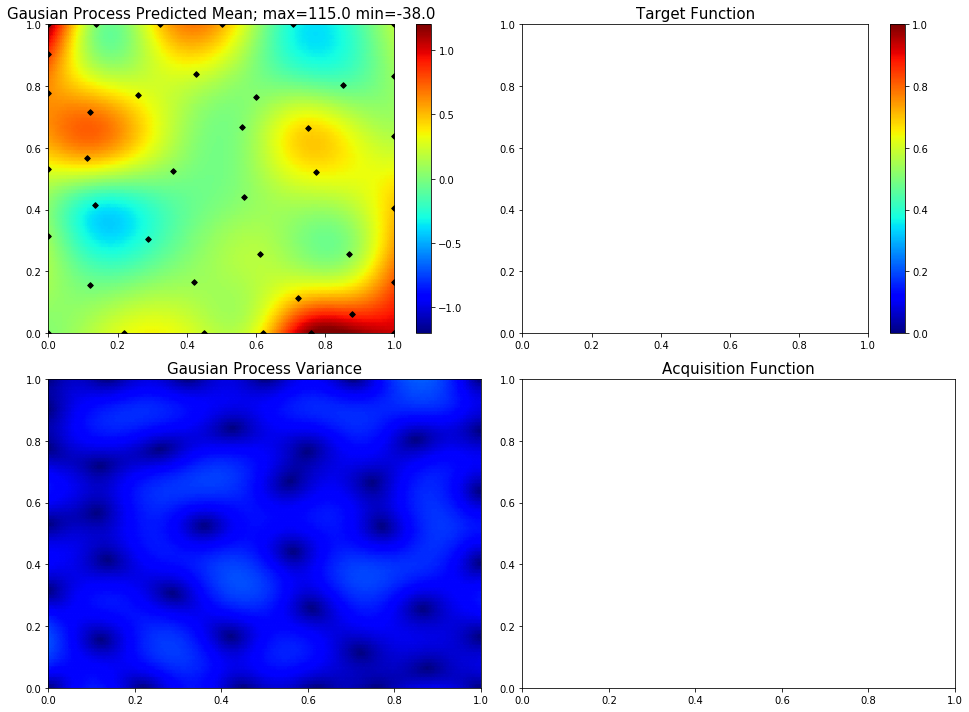

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.634121967893749, 0.25124648312973435]
66  Evaluations Remaining
|  40       |  0.2871   |  0.6341   |  0.2512   |
myplot:  040


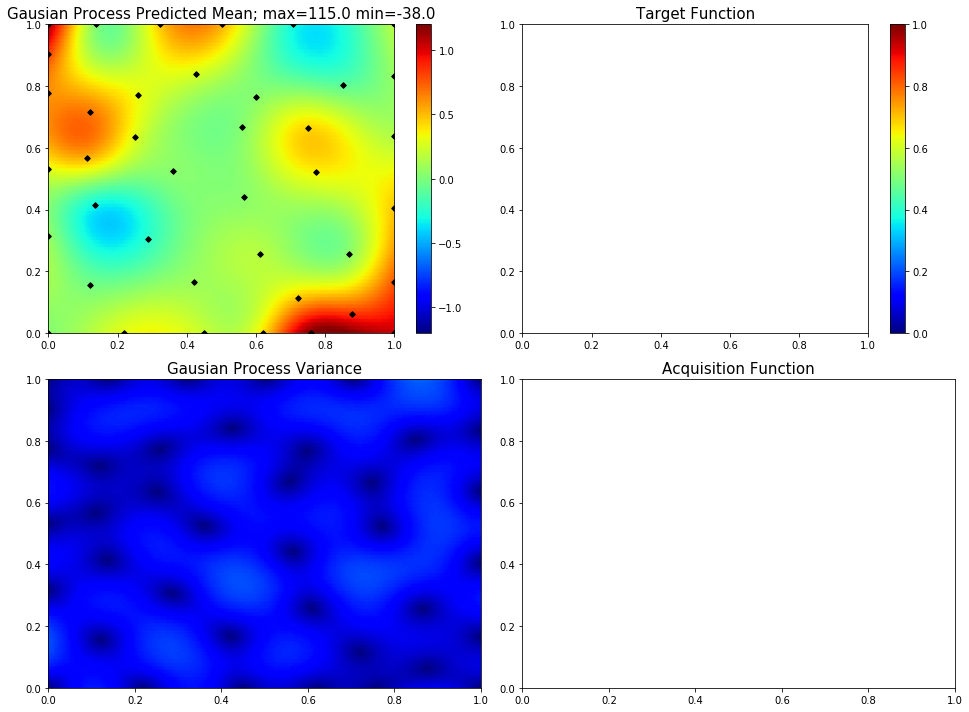

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8787723282732461]
65  Evaluations Remaining
|  41       |  1.001    |  0.0      |  0.8788   |
myplot:  041


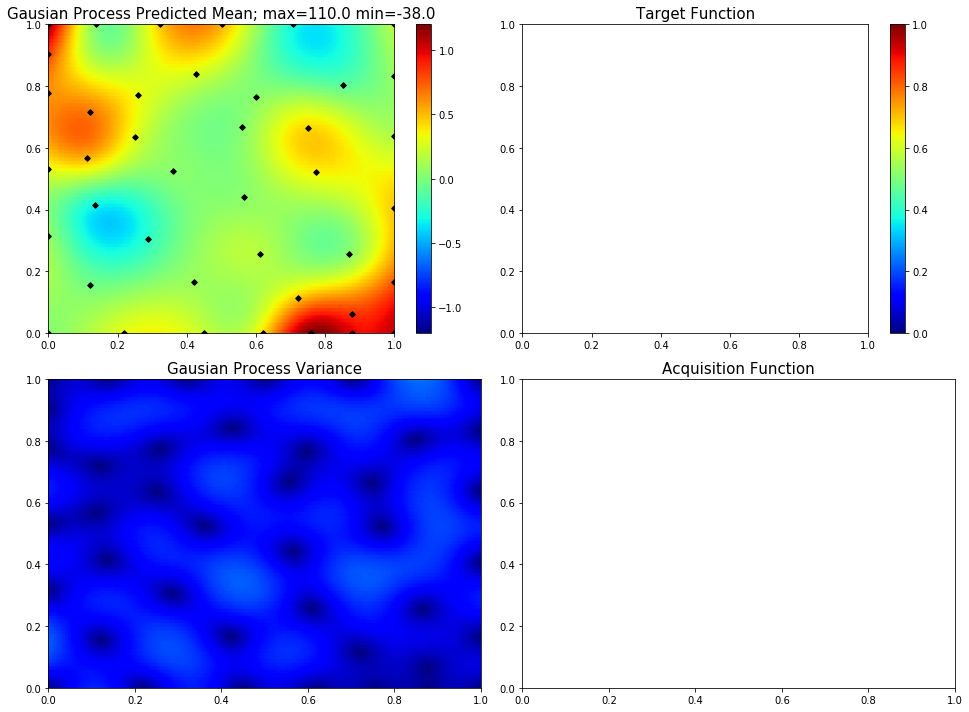

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.14986549093825352, 0.0]
64  Evaluations Remaining
|  42       |  0.02586  |  0.1499   |  0.0      |
myplot:  042


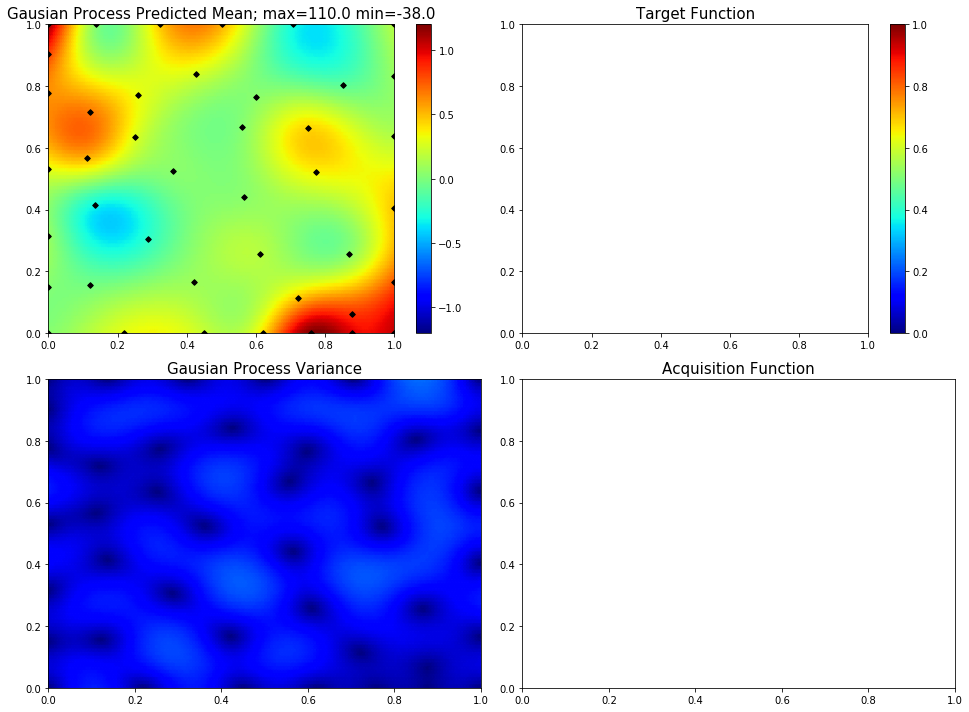

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5274786961446888, 0.9066458982470692]
63  Evaluations Remaining
|  43       |  0.1817   |  0.5275   |  0.9066   |
myplot:  043


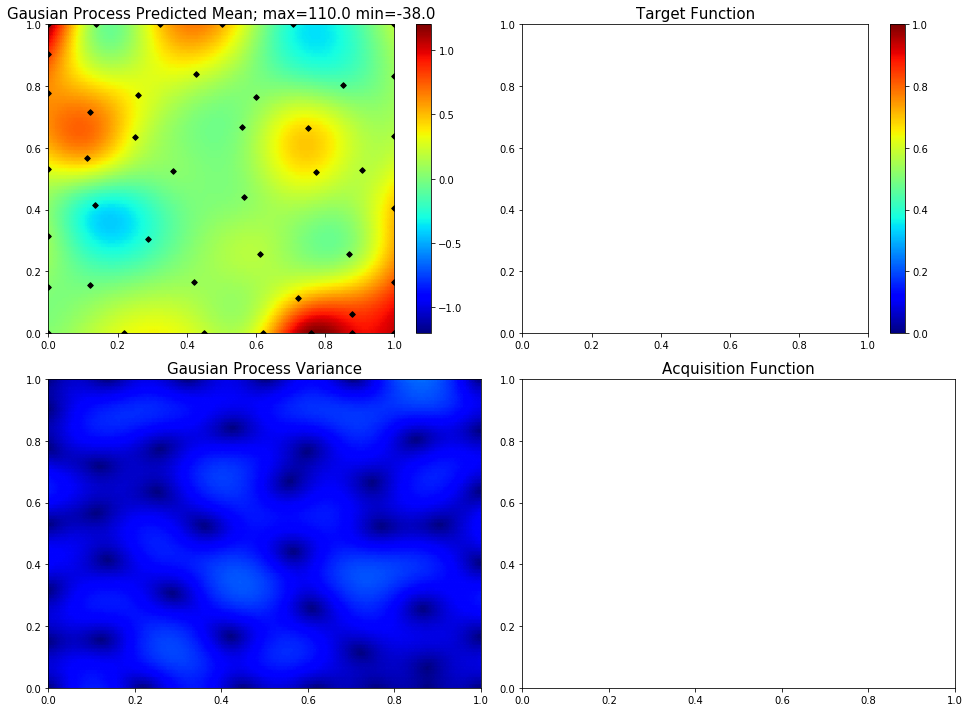

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.33486550912530116, 0.45208435880705194]
62  Evaluations Remaining
|  44       |  0.5307   |  0.3349   |  0.4521   |
myplot:  044


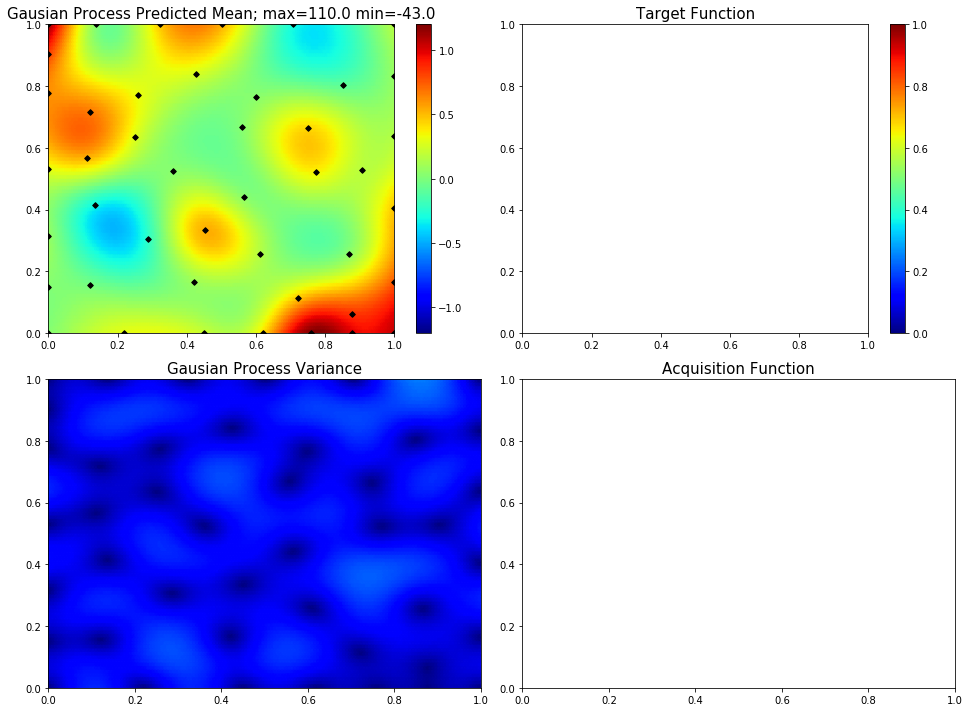

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.8707530246602281]
61  Evaluations Remaining
|  45       | -0.3093   |  1.0      |  0.8708   |
myplot:  045


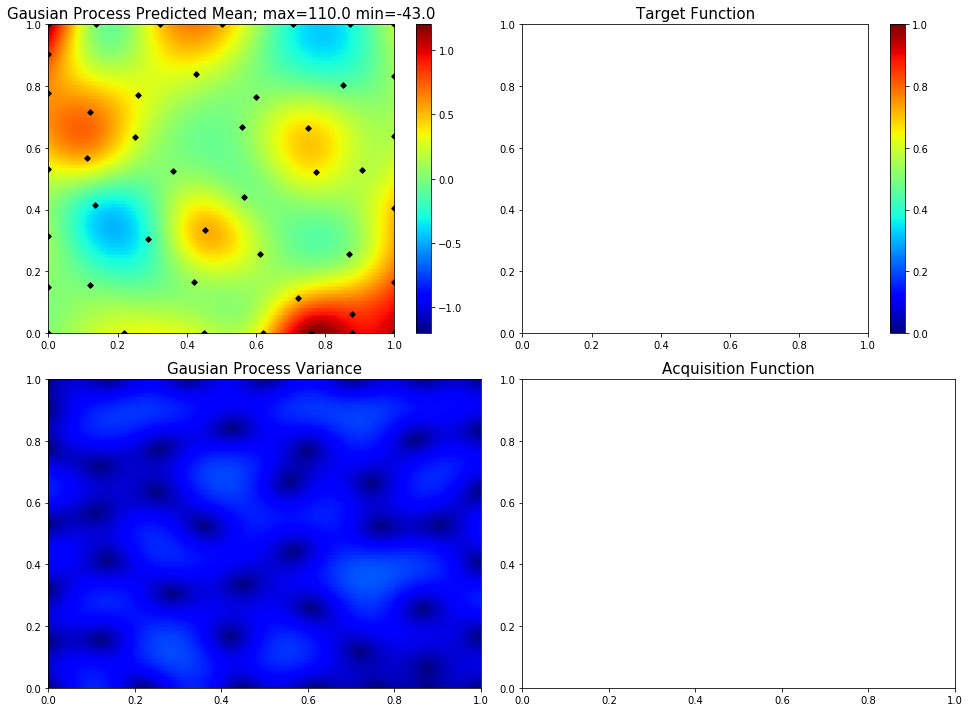

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6533286173303561, 0.0]
60  Evaluations Remaining
|  46       |  0.5359   |  0.6533   |  0.0      |
myplot:  046


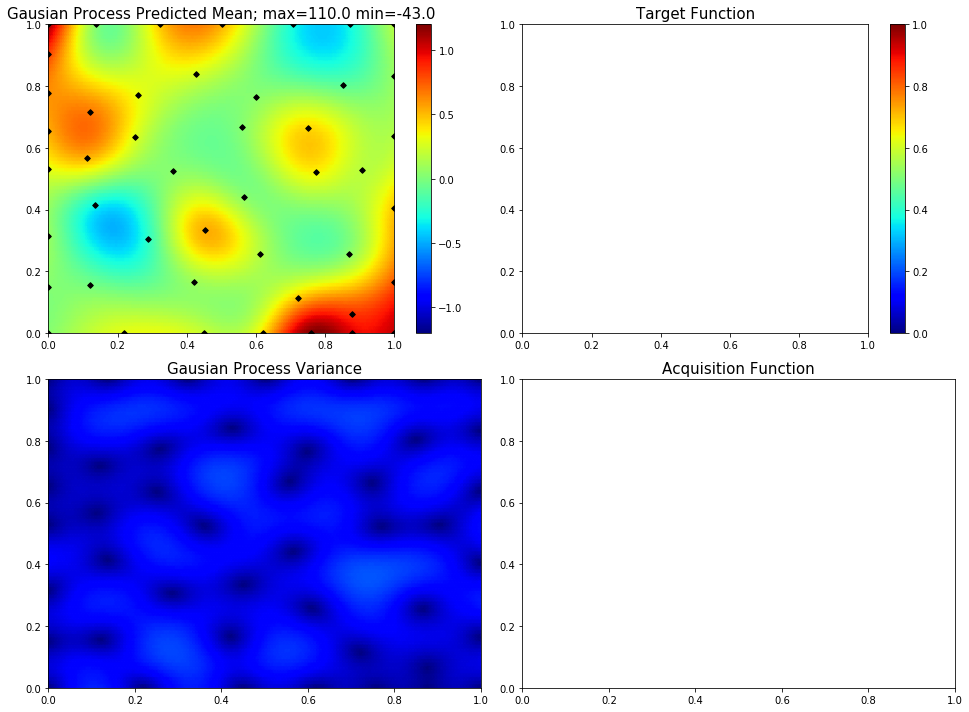

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3692507411759837, 0.7423665135184766]
59  Evaluations Remaining
|  47       | -0.4716   |  0.3693   |  0.7424   |
myplot:  047


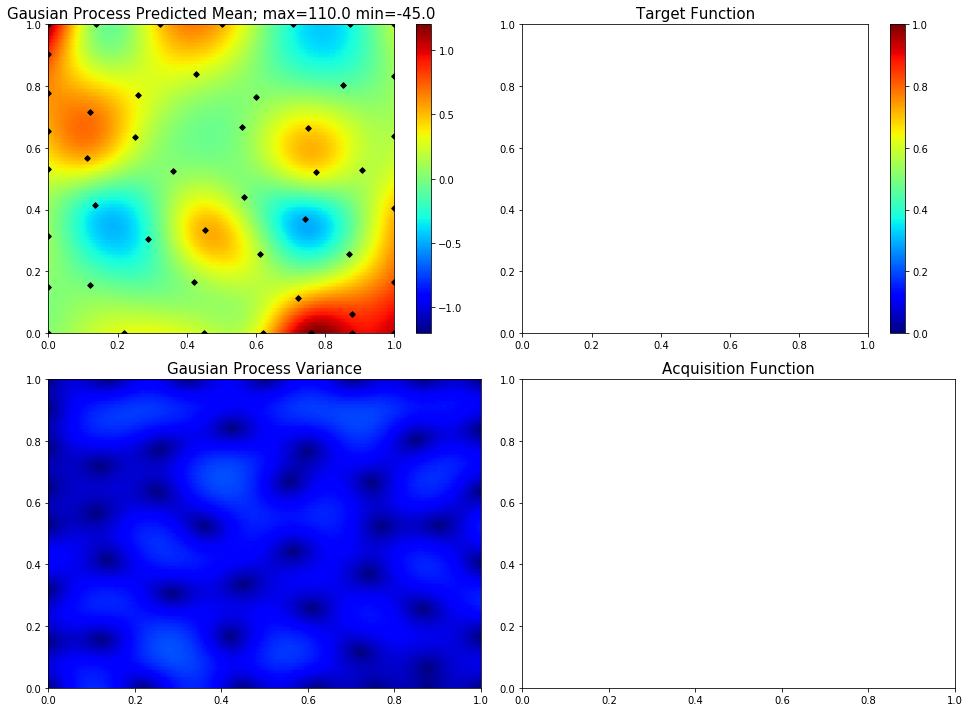

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2848298152313304, 1.0]
58  Evaluations Remaining
|  48       |  0.7629   |  0.2848   |  1.0      |
myplot:  048


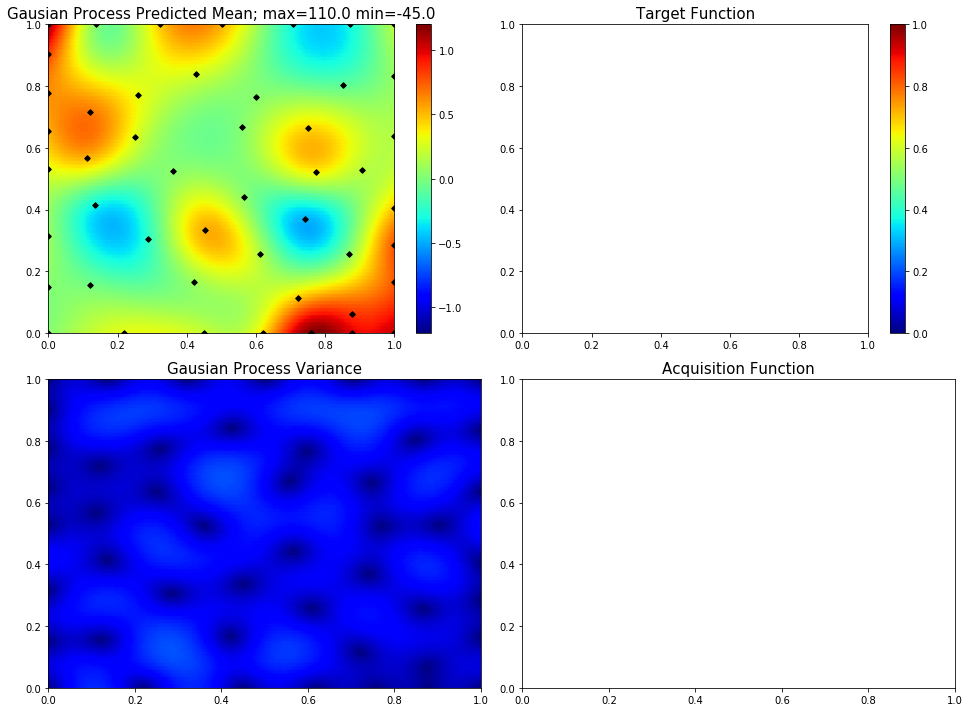

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.09962500545930211, 0.29188509347520963]
57  Evaluations Remaining
|  49       |  0.06197  |  0.09963  |  0.2919   |
myplot:  049


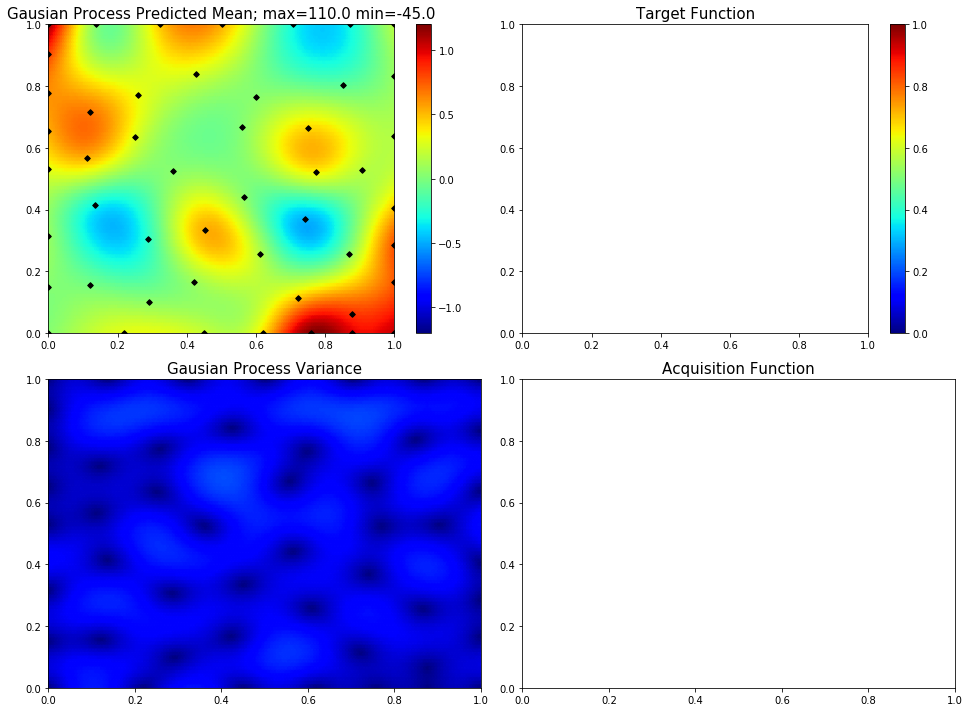

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6873264884326622, 0.39920673232480014]
56  Evaluations Remaining
|  50       |  0.1002   |  0.6873   |  0.3992   |
myplot:  050


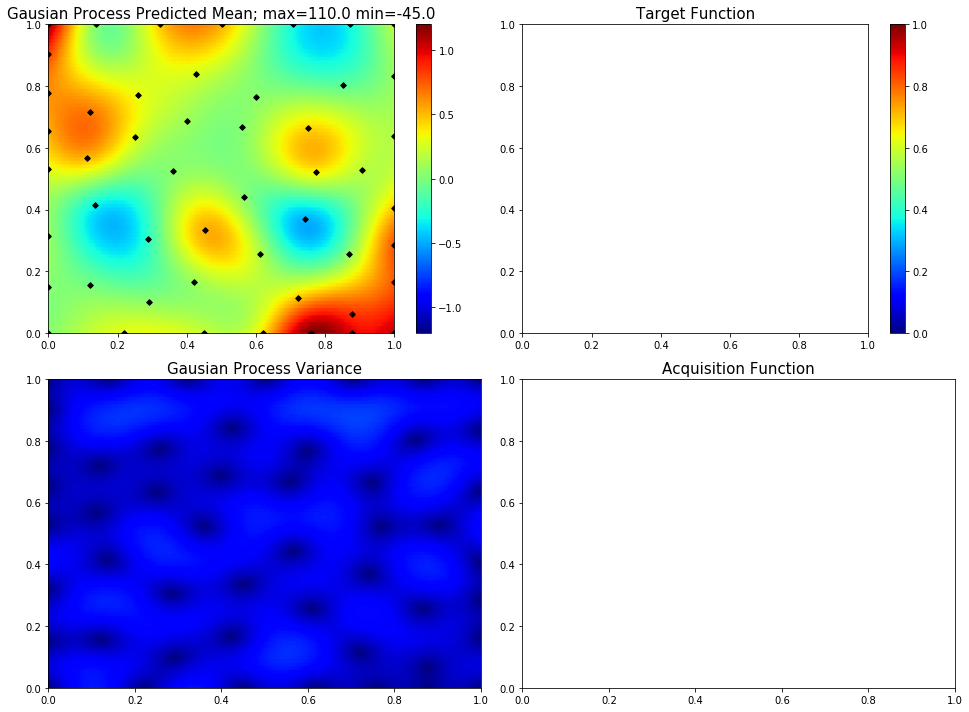

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.853857017075473, 0.1307568001881867]
55  Evaluations Remaining
|  51       |  0.09502  |  0.8539   |  0.1308   |
myplot:  051


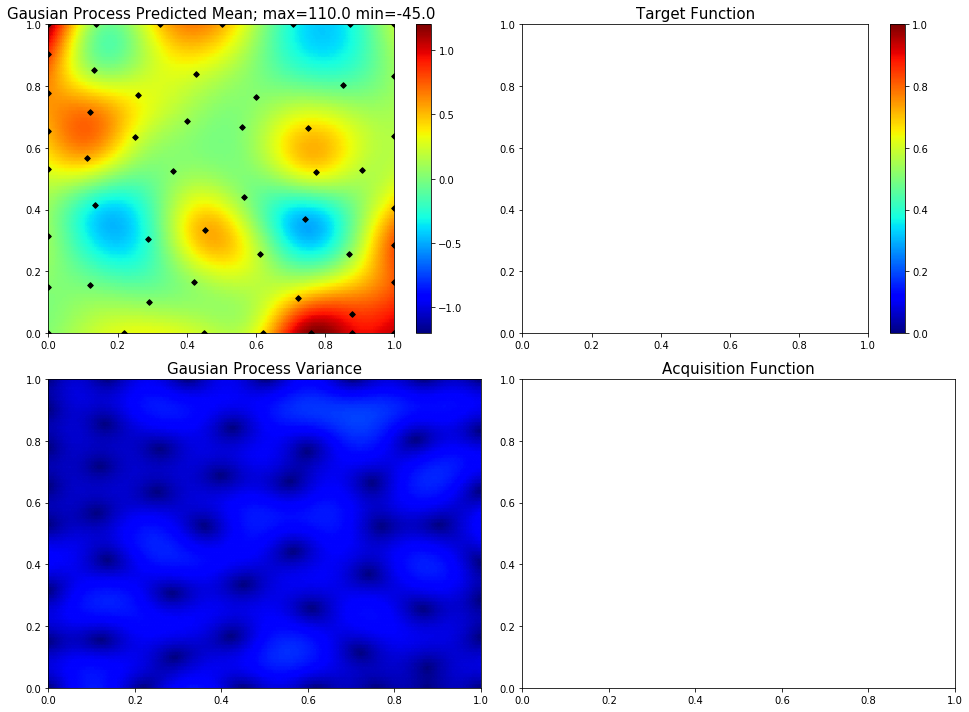

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6630446454991461, 0.8747488178851343]
54  Evaluations Remaining
|  52       |  0.1907   |  0.663    |  0.8747   |
myplot:  052


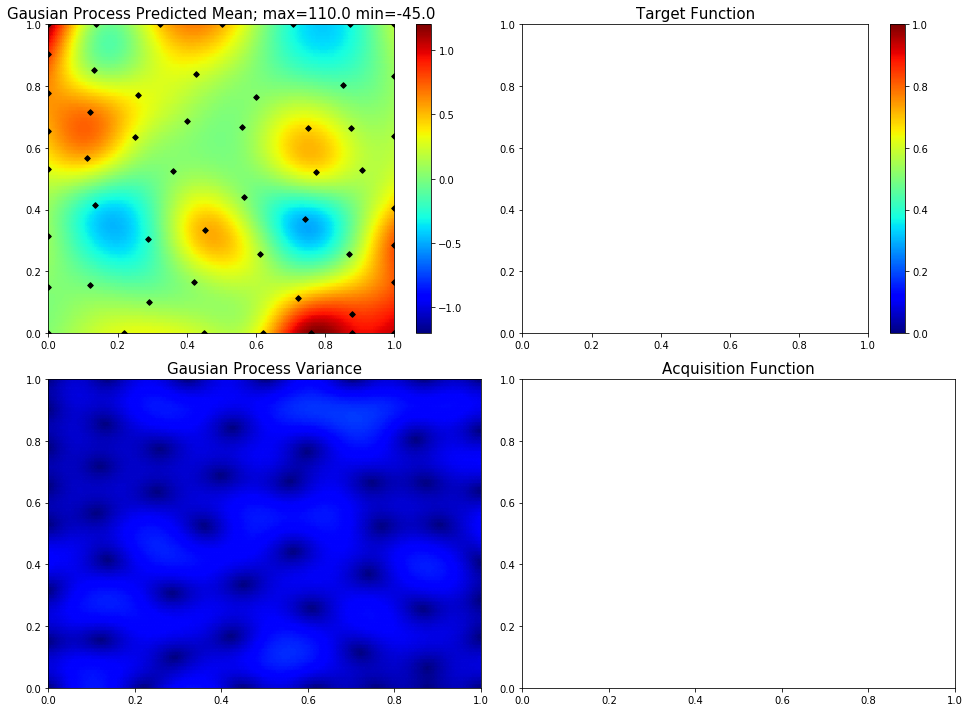

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.12306765490401637, 0.5608547717385624]
53  Evaluations Remaining
|  53       |  0.2351   |  0.1231   |  0.5609   |
myplot:  053


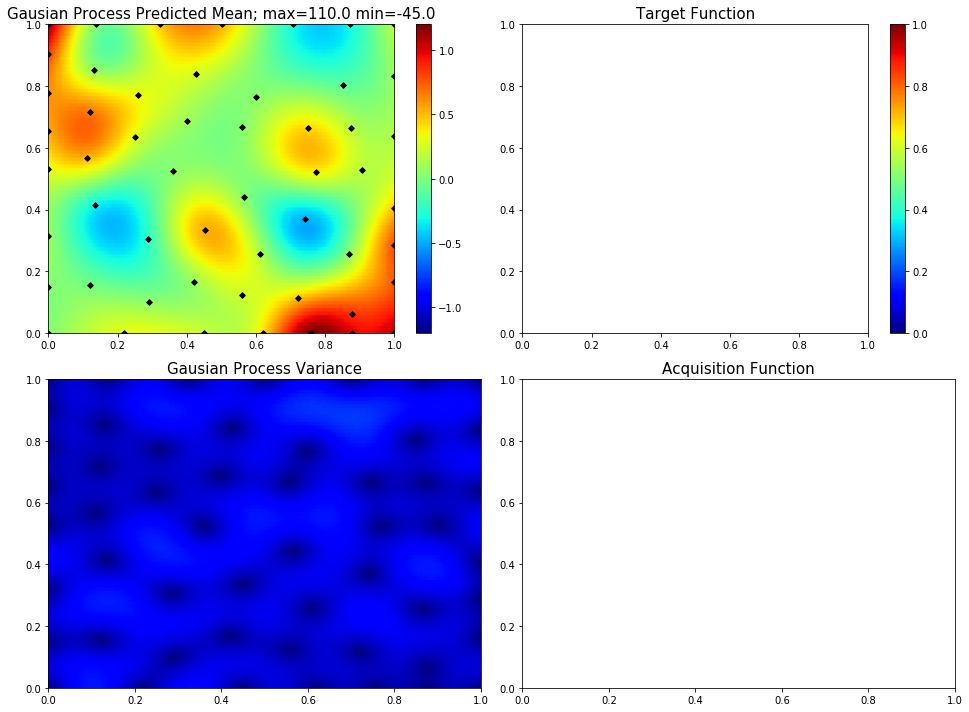

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9105993154912282, 0.5793295915169656]
52  Evaluations Remaining
|  54       |  0.3099   |  0.9106   |  0.5793   |
myplot:  054


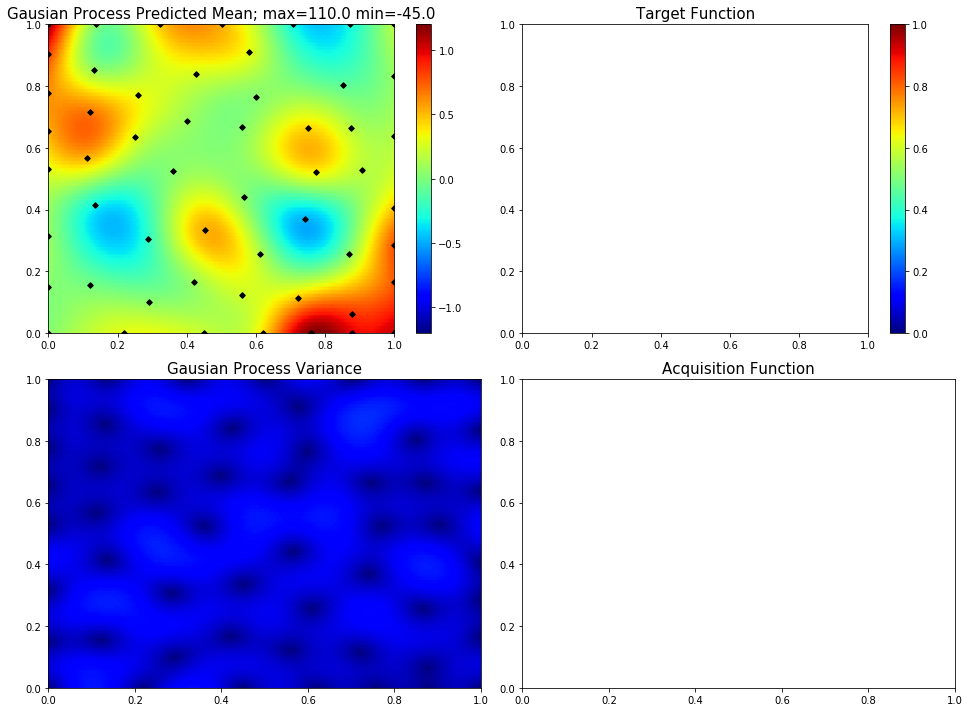

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.06758801153148272, 1.0]
51  Evaluations Remaining
|  55       |  0.9529   |  0.06759  |  1.0      |
myplot:  055


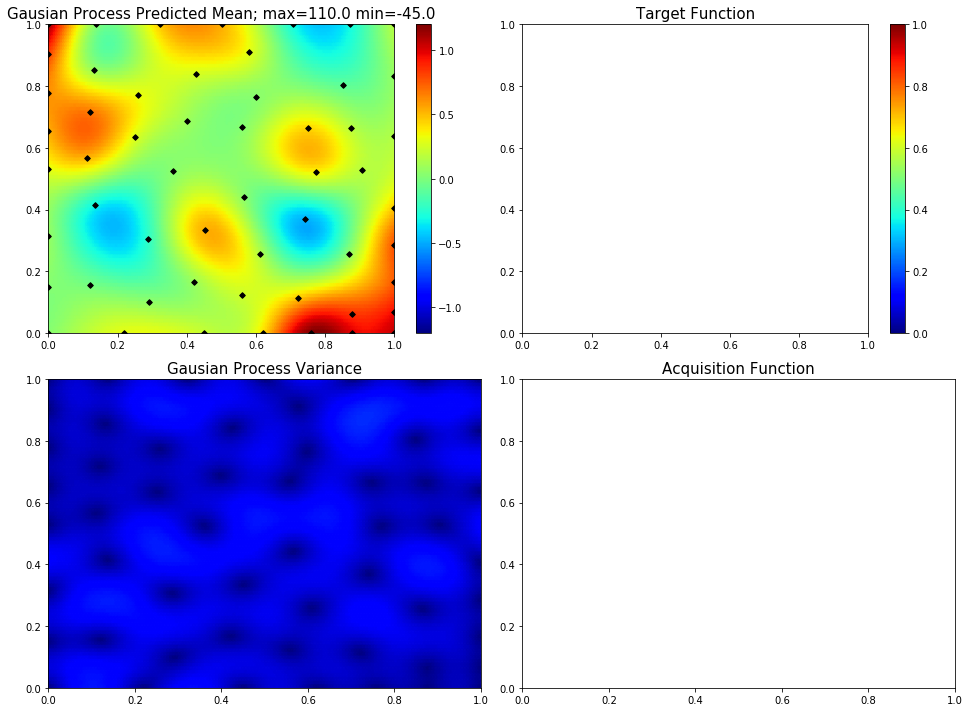

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5689295237690494, 0.6590260005321504]
50  Evaluations Remaining
|  56       |  0.0536   |  0.5689   |  0.659    |
myplot:  056


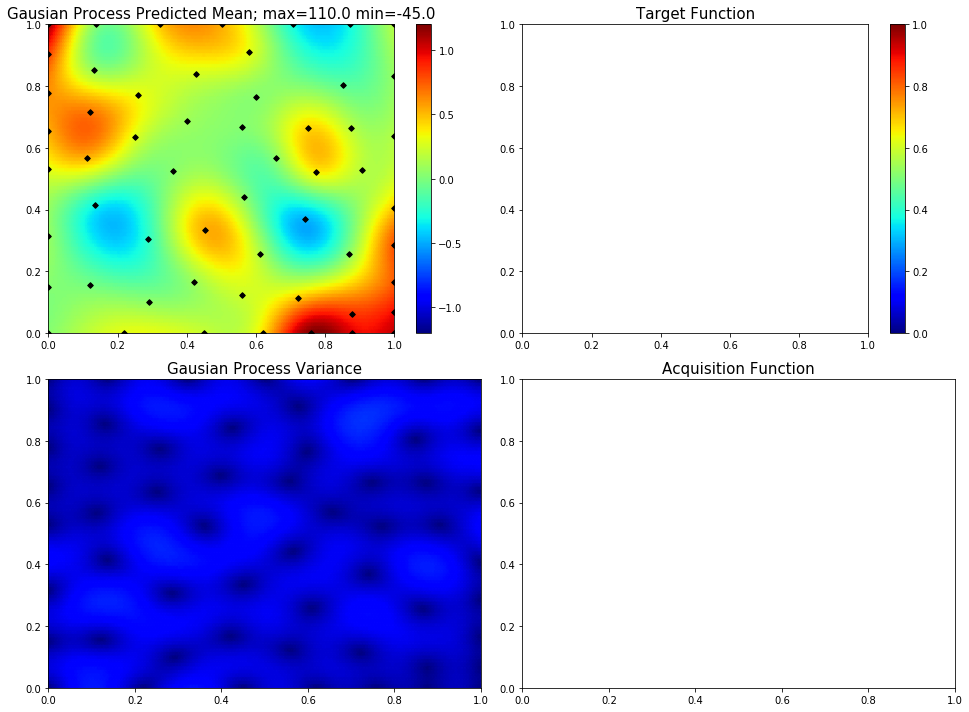

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.3335307820285317]
49  Evaluations Remaining
|  57       |  0.1605   |  0.0      |  0.3335   |
myplot:  057


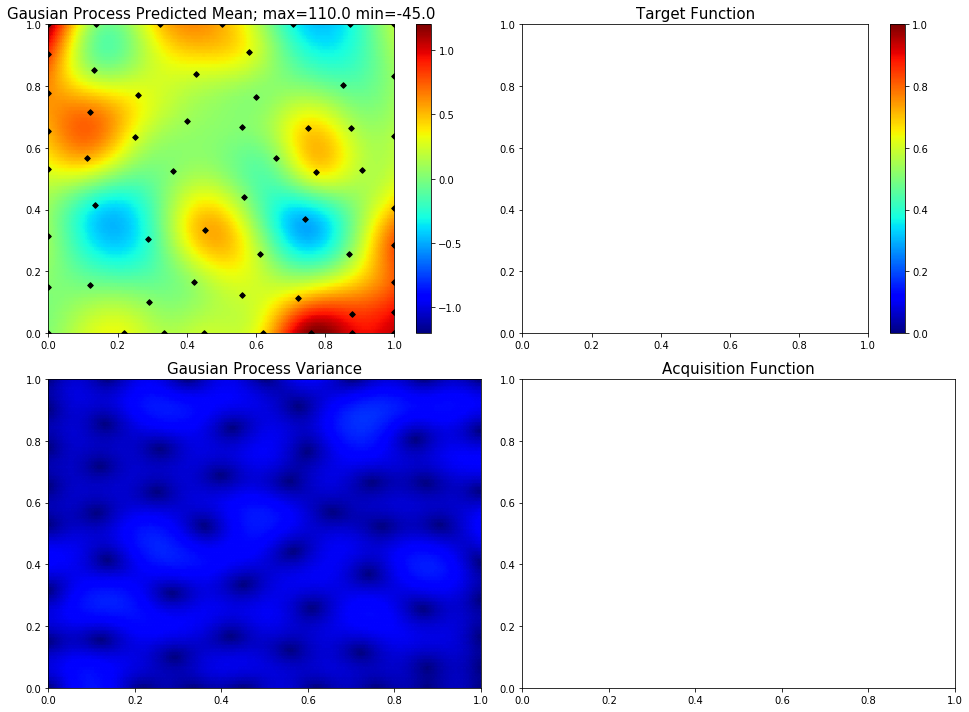

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.900126520818226, 0.30654760899807165]
48  Evaluations Remaining
|  58       |  0.3002   |  0.9001   |  0.3065   |
myplot:  058


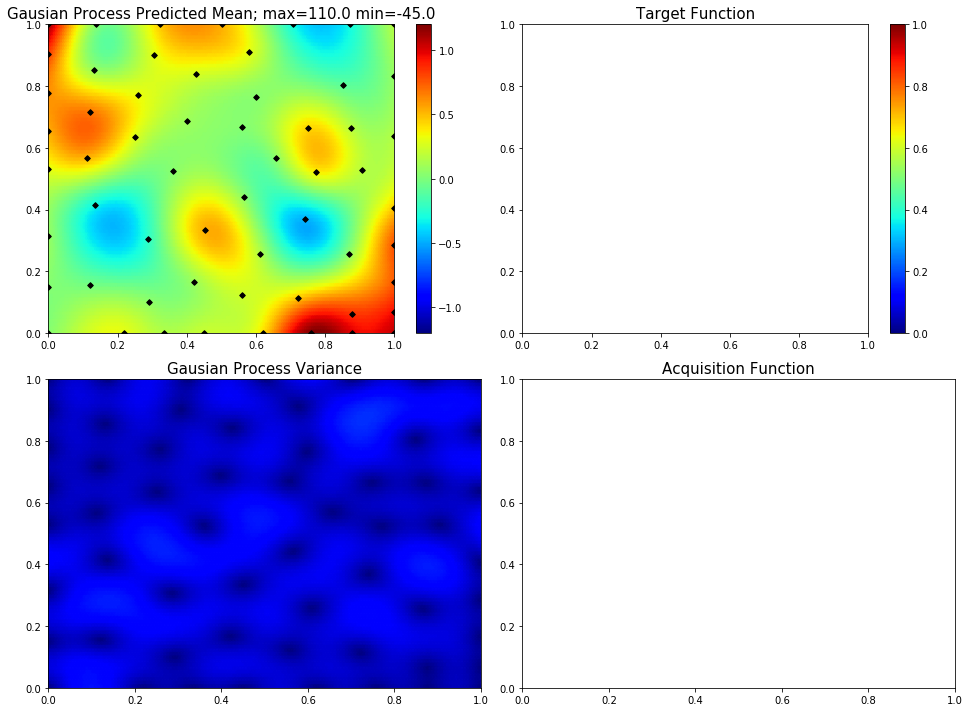

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.03439158466618359, 0.8026506738074697]
47  Evaluations Remaining
|  59       |  1.218    |  0.03439  |  0.8027   |
myplot:  059


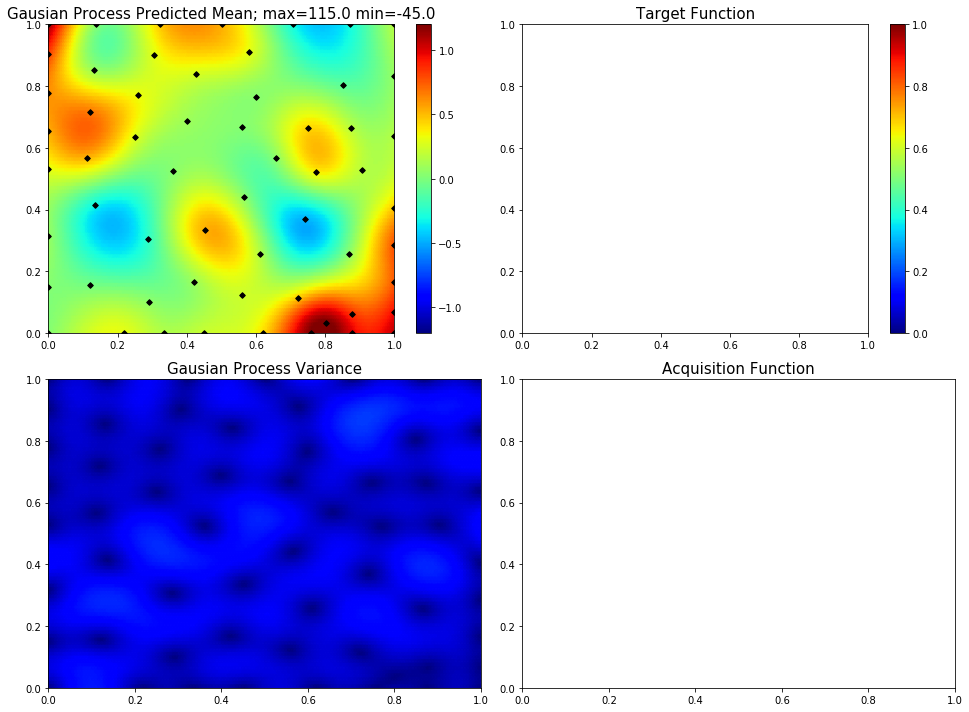

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0010109333082406469, 0.8149729077755158]
46  Evaluations Remaining
|  60       |  1.17     |  0.001011 |  0.815    |
myplot:  060


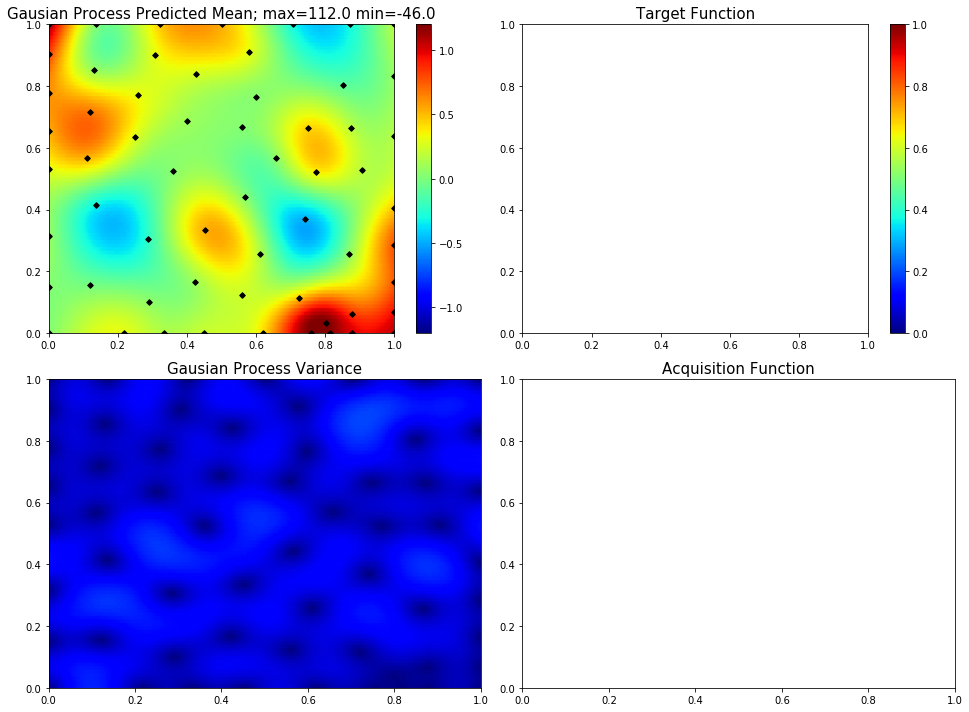

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.961313155704109, 0.41684403937676034]
45  Evaluations Remaining
|  61       |  0.8112   |  0.9613   |  0.4168   |
myplot:  061


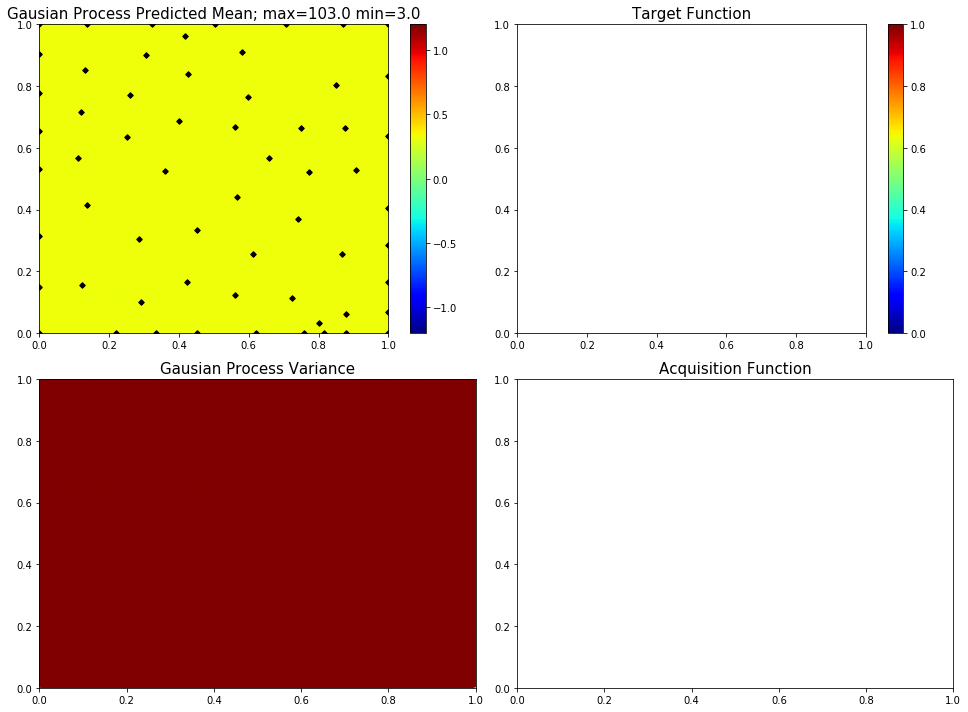

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8477074330253275, 0.7157408681489053]
44  Evaluations Remaining
|  62       | -0.217    |  0.8477   |  0.7157   |
myplot:  062


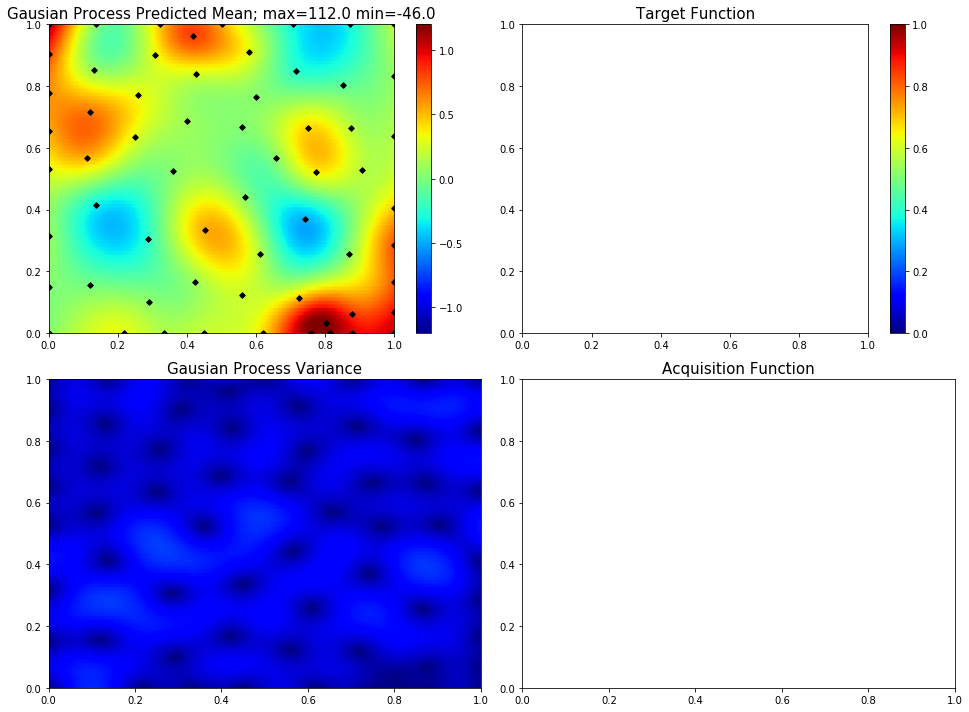

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.10642066016386126]
43  Evaluations Remaining
|  63       |  0.3687   |  0.0      |  0.1064   |
myplot:  063


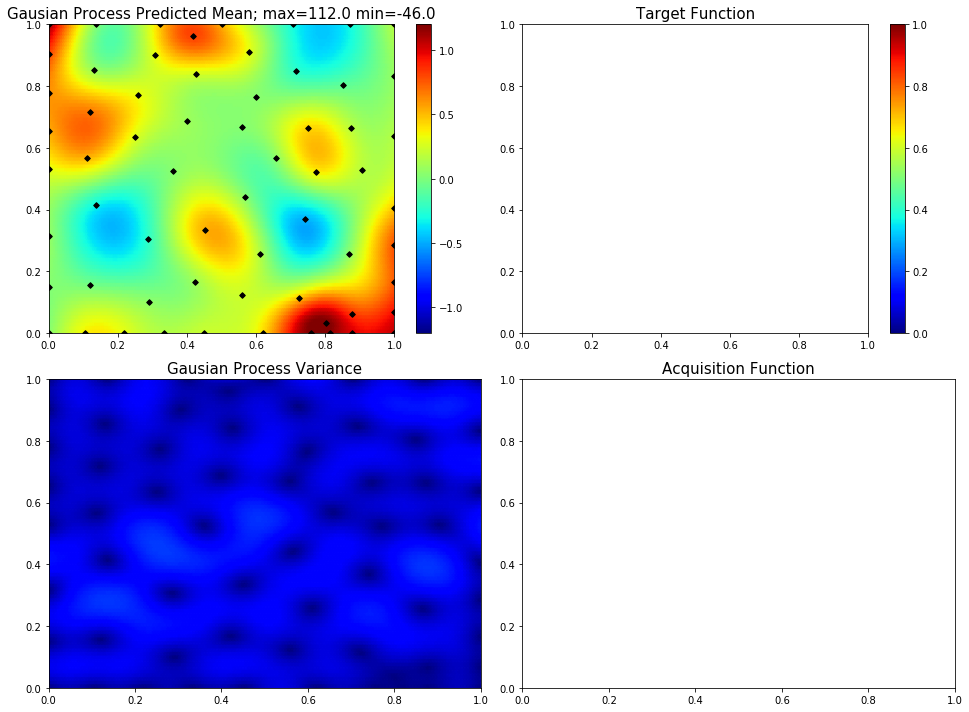

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3806360789578063, 0.9083430540004797]
42  Evaluations Remaining
|  64       |  0.1539   |  0.3806   |  0.9083   |
myplot:  064


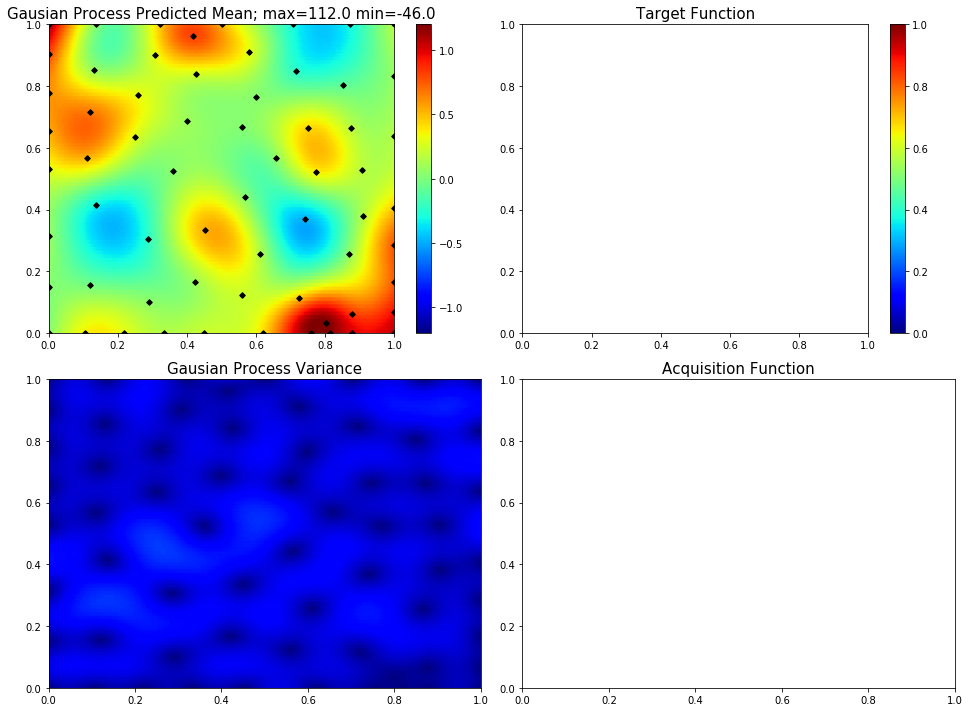

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.03594653687467272, 0.7315444012414603]
41  Evaluations Remaining
|  65       |  0.8701   |  0.03595  |  0.7315   |
myplot:  065


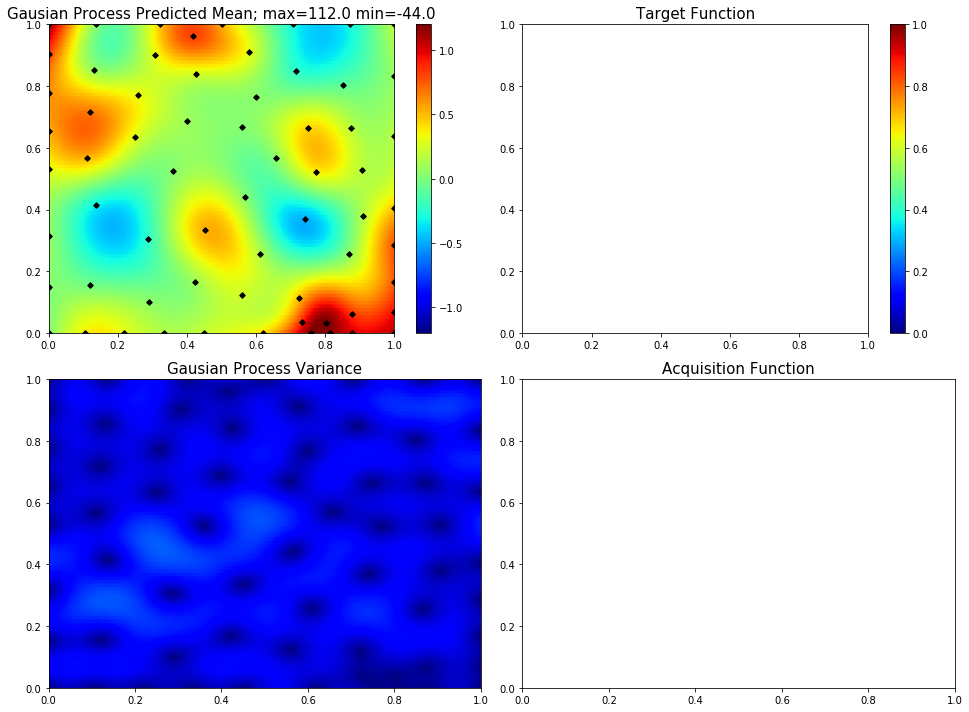

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.535165201846548, 0.4812191708492191]
40  Evaluations Remaining
|  66       |  0.02291  |  0.5352   |  0.4812   |
myplot:  066


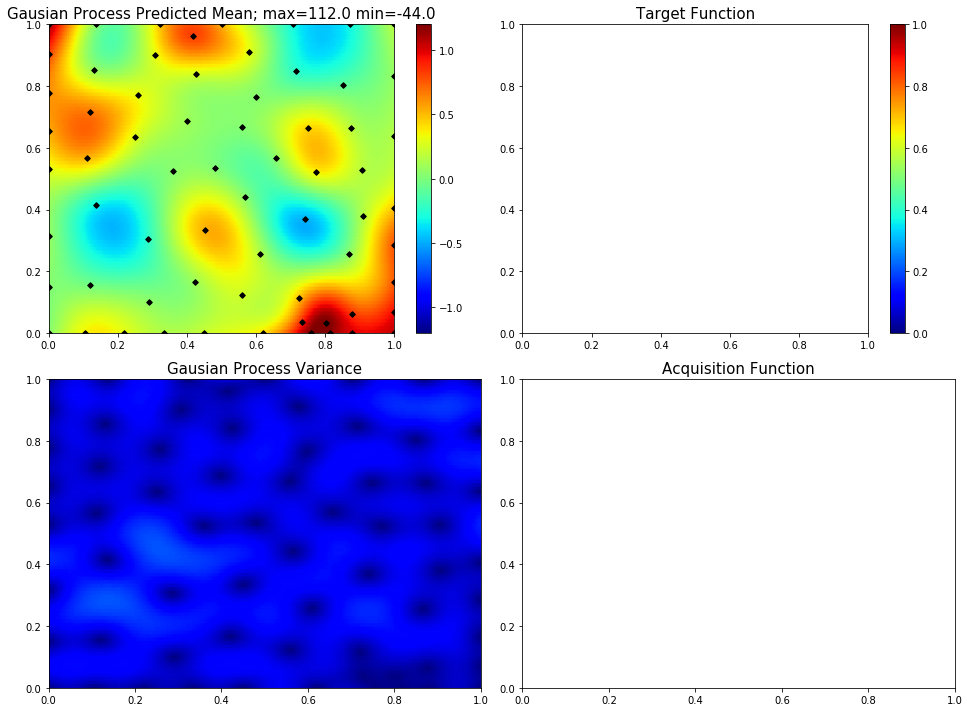

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.40935469003636893, 0.38703541395335533]
39  Evaluations Remaining
|  67       |  0.08602  |  0.4094   |  0.387    |
myplot:  067


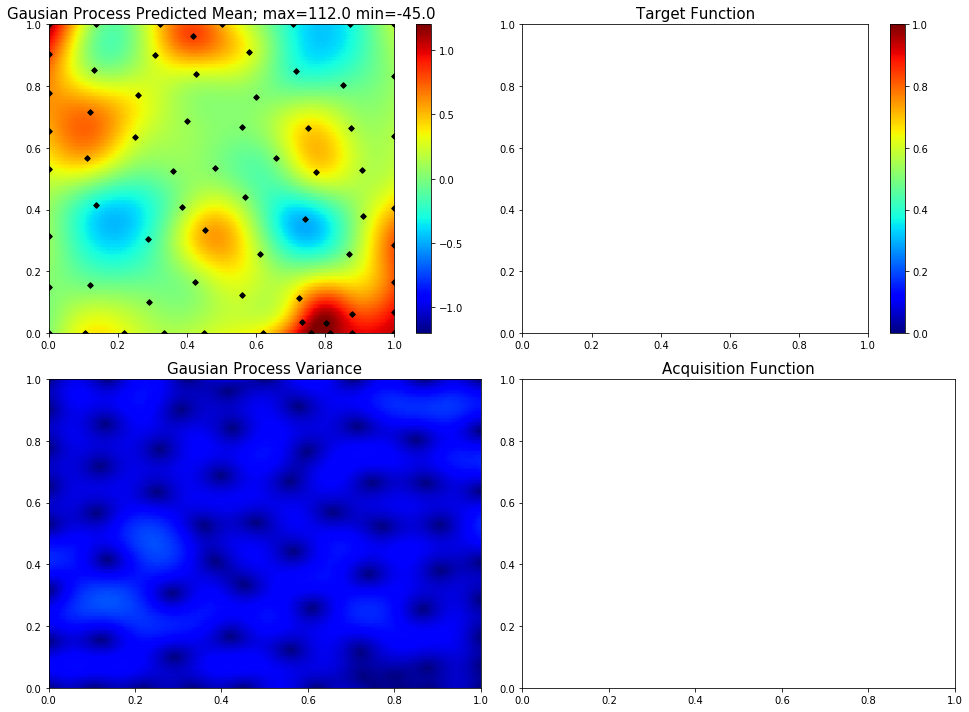

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.12155501656370676, 0.8150776552211982]
38  Evaluations Remaining
|  68       |  0.6459   |  0.1216   |  0.8151   |
myplot:  068


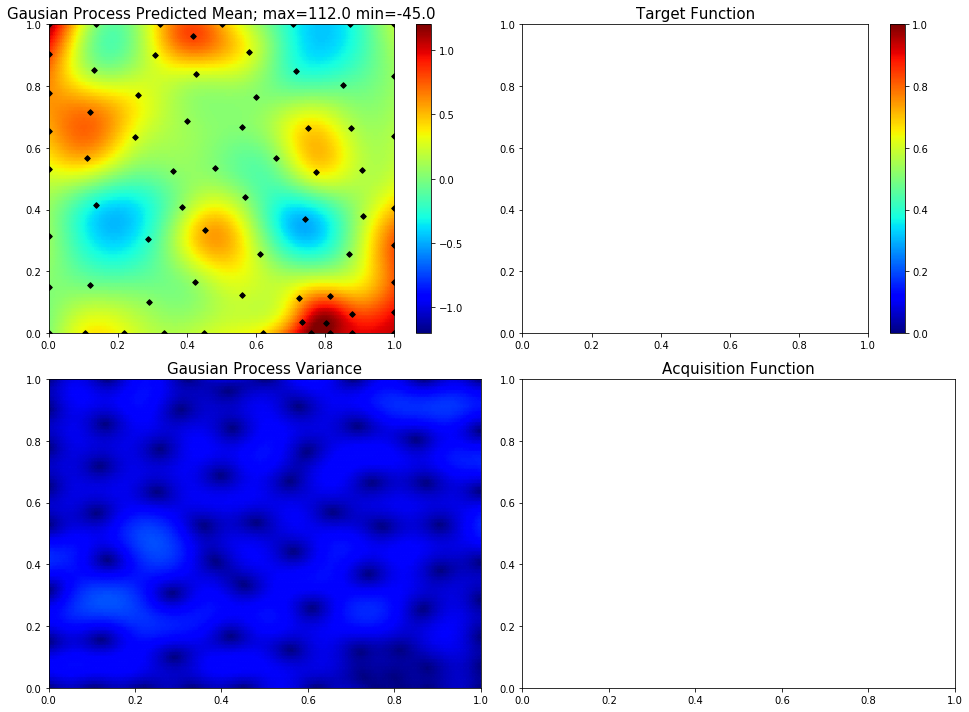

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.24808771305011562, 0.5067676114148764]
37  Evaluations Remaining
|  69       |  0.311    |  0.2481   |  0.5068   |
myplot:  069


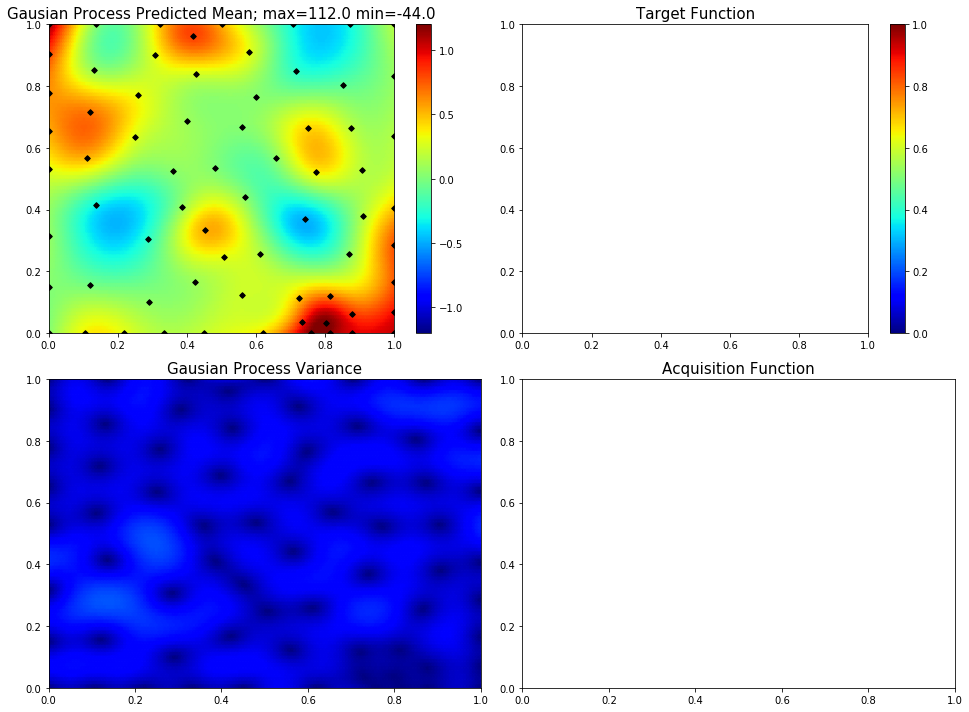

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5126646939879229, 0.22508180369542735]
36  Evaluations Remaining
|  70       |  0.1917   |  0.5127   |  0.2251   |
myplot:  070


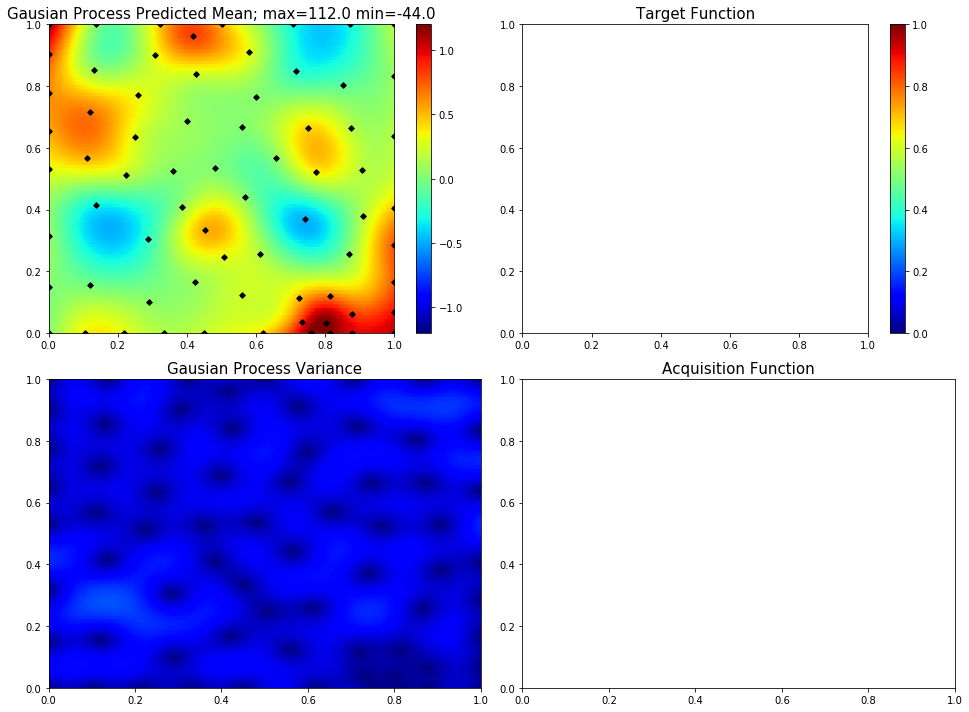

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9708871242836424, 0.03859787177291905]
35  Evaluations Remaining
|  71       |  0.6993   |  0.9709   |  0.0386   |
myplot:  071


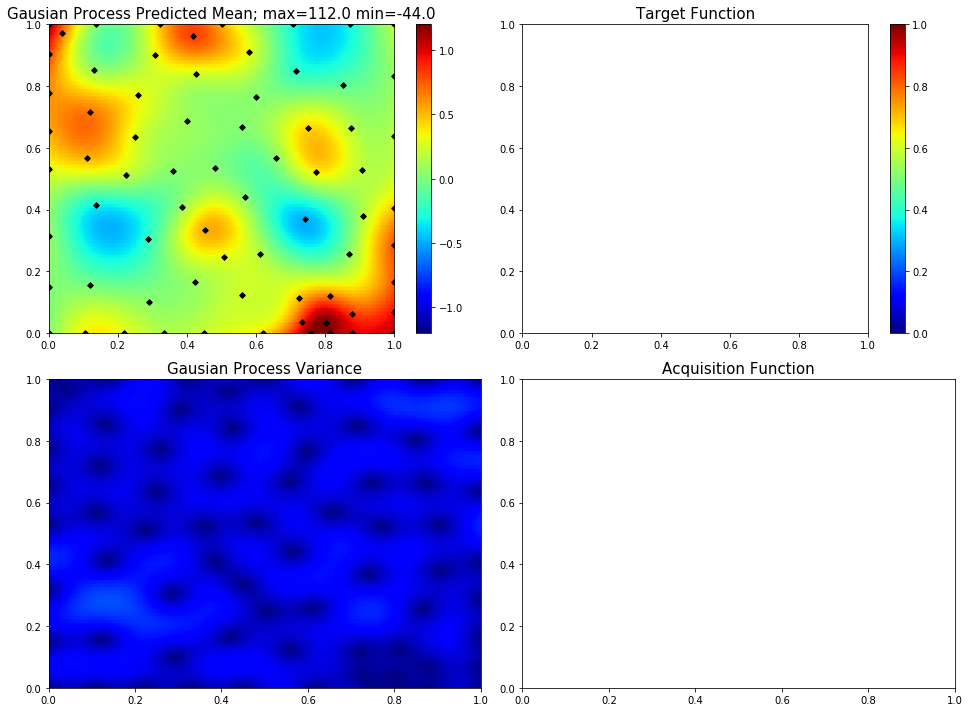

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.9505569560171356]
34  Evaluations Remaining
|  72       |  1.114    |  0.0      |  0.9506   |
myplot:  072


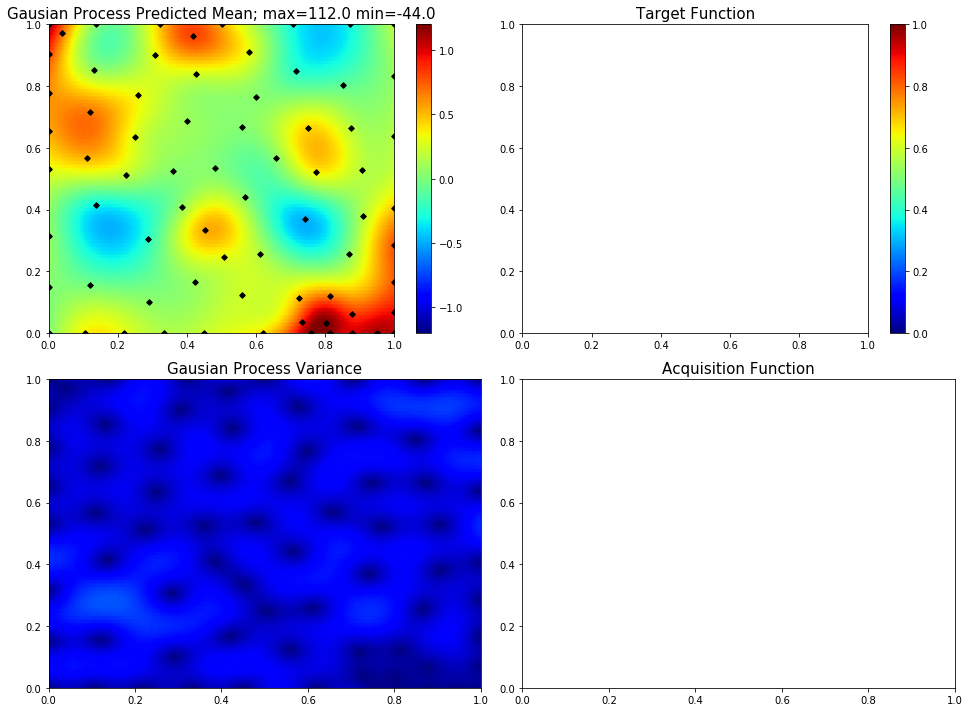

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5202807511715496, 1.0]
33  Evaluations Remaining
|  73       |  0.2736   |  0.5203   |  1.0      |
myplot:  073


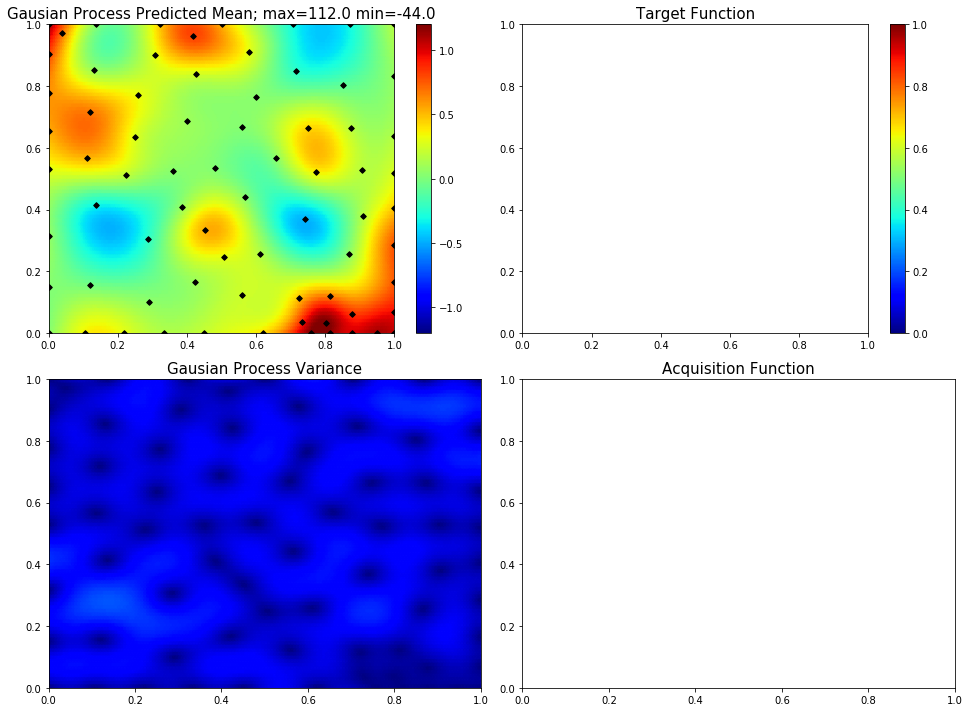

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4231971696553818, 0.0]
32  Evaluations Remaining
|  74       |  0.1718   |  0.4232   |  0.0      |
myplot:  074


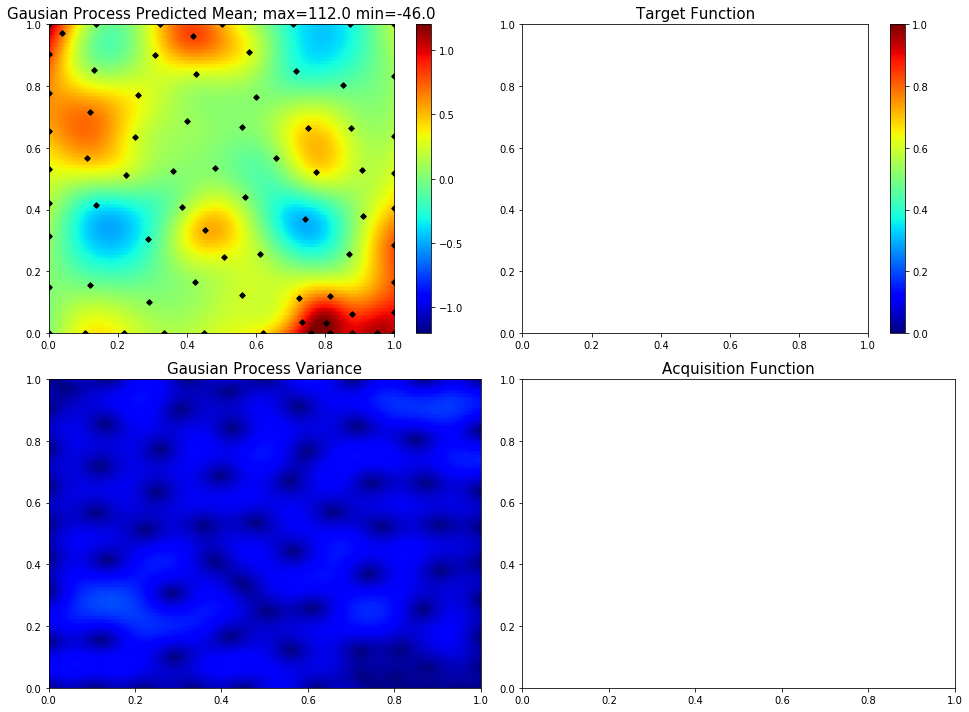

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.643868728413103, 0.14935945412223905]
31  Evaluations Remaining
|  75       |  0.8141   |  0.6439   |  0.1494   |
myplot:  075


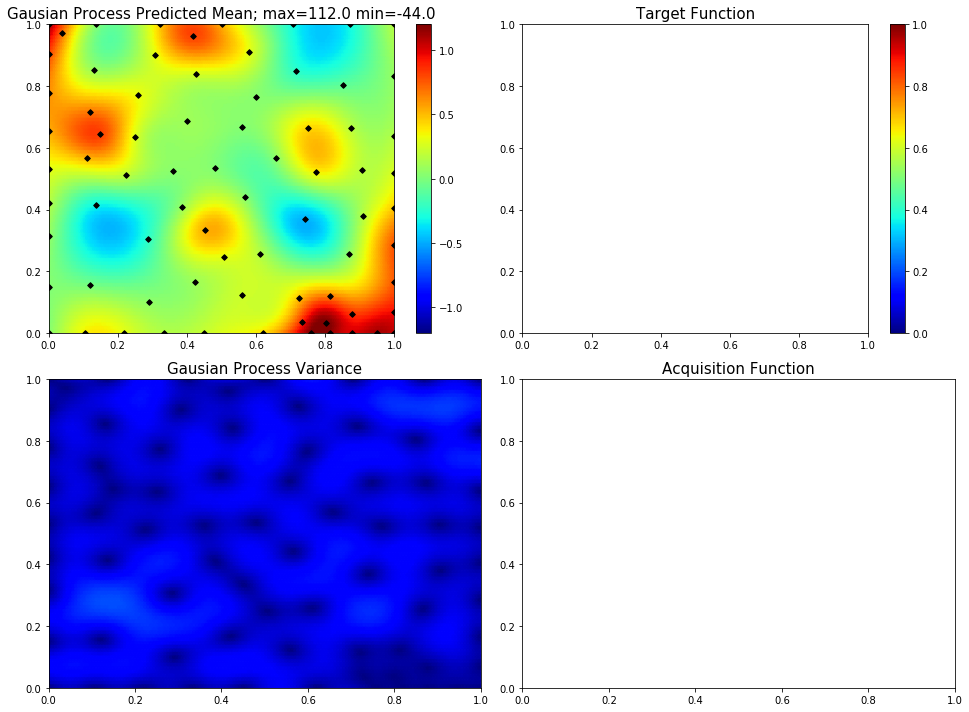

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.4103424934964174]
30  Evaluations Remaining
|  76       |  0.6628   |  1.0      |  0.4103   |
myplot:  076


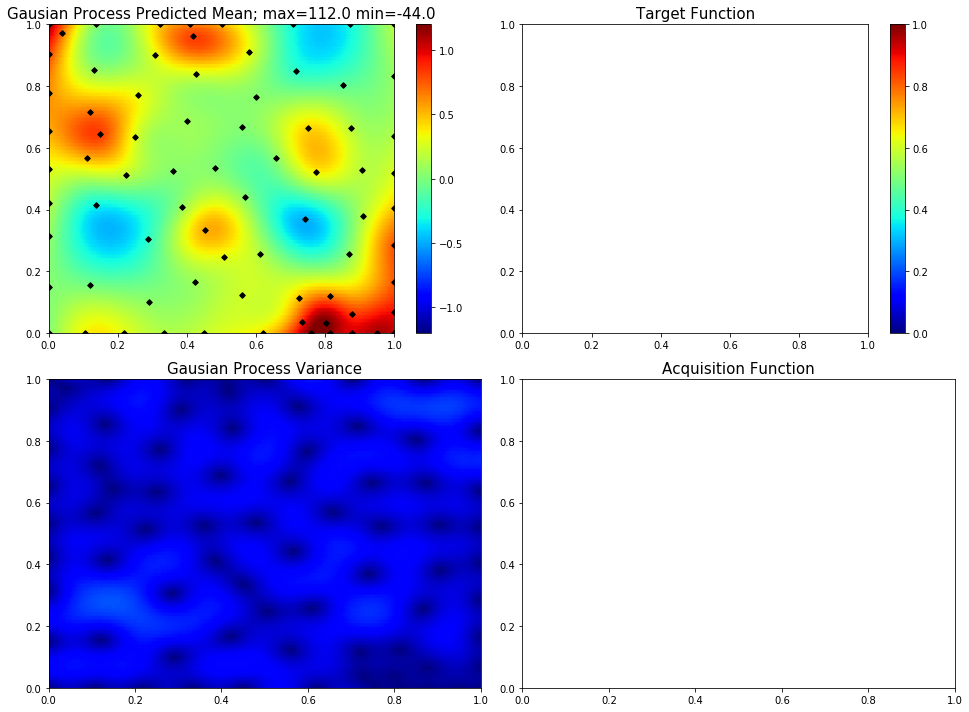

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6510608399789216, 0.07672220921106643]
29  Evaluations Remaining
|  77       |  0.5711   |  0.6511   |  0.07672  |
myplot:  077


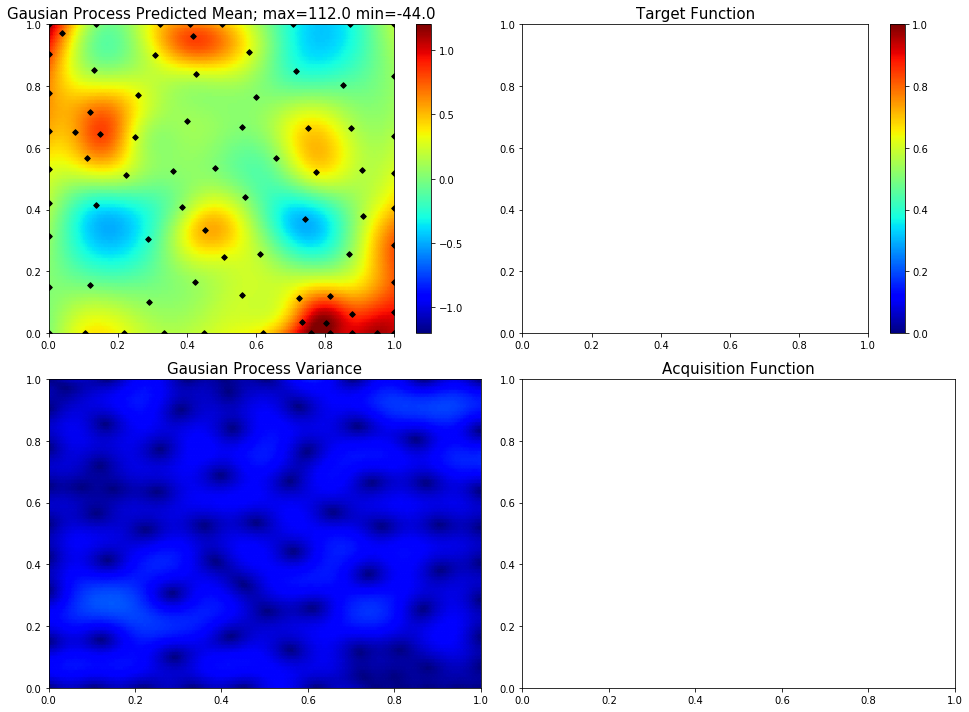

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9129033102109025, 0.4880911824767671]
28  Evaluations Remaining
|  78       |  0.7486   |  0.9129   |  0.4881   |
myplot:  078


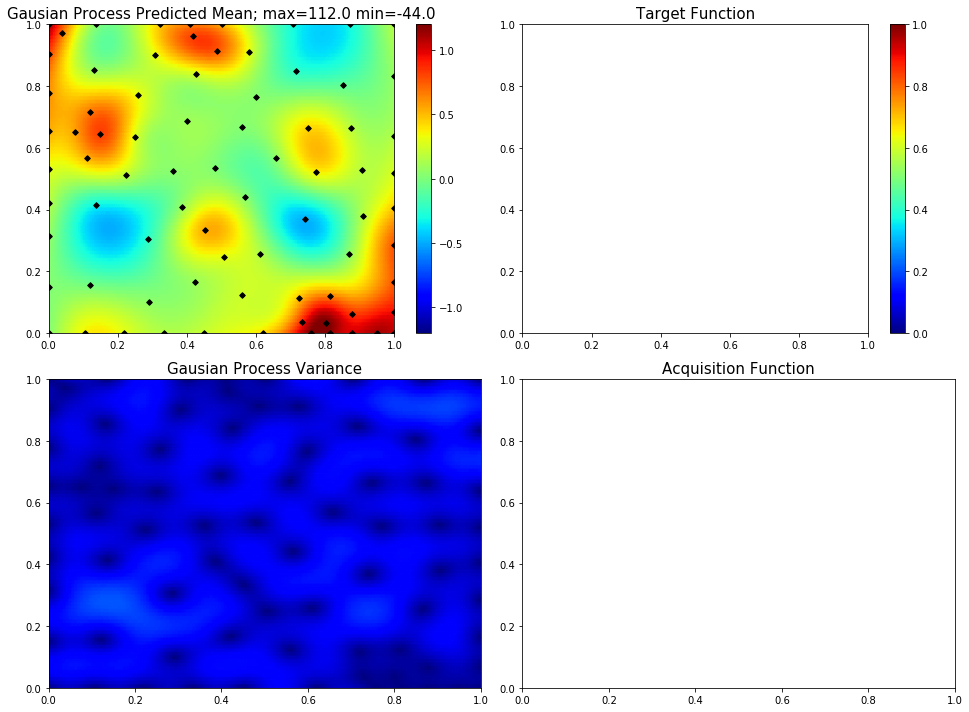

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.14908929489137748, 0.9335282171374514]
27  Evaluations Remaining
|  79       |  0.6731   |  0.1491   |  0.9335   |
myplot:  079


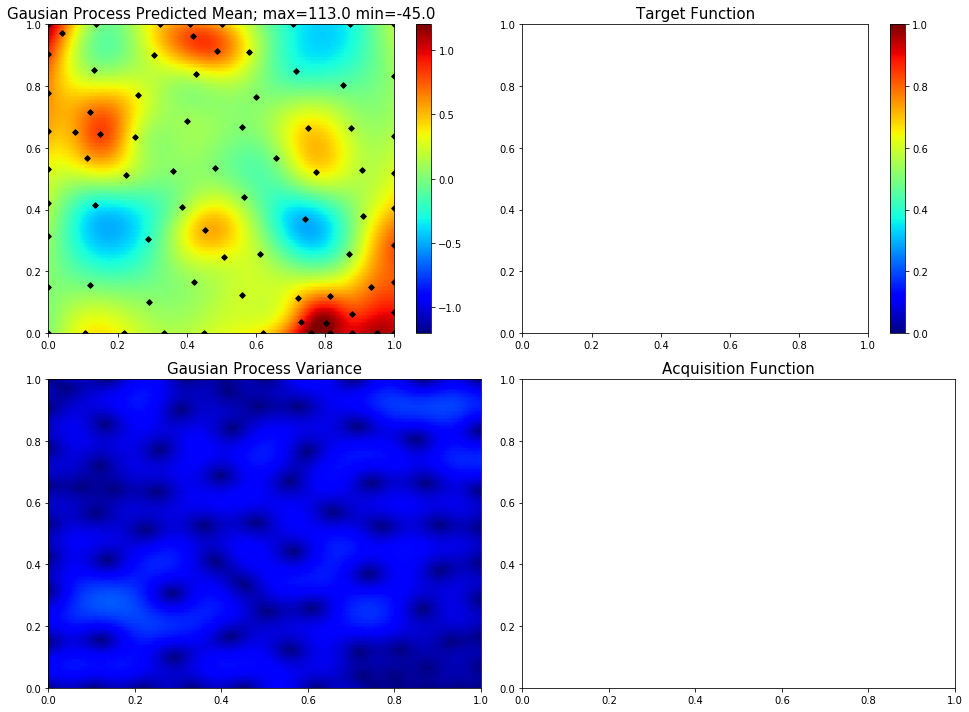

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.34322978112070335, 0.5388754230375362]
26  Evaluations Remaining
|  80       |  0.4696   |  0.3432   |  0.5389   |
myplot:  080


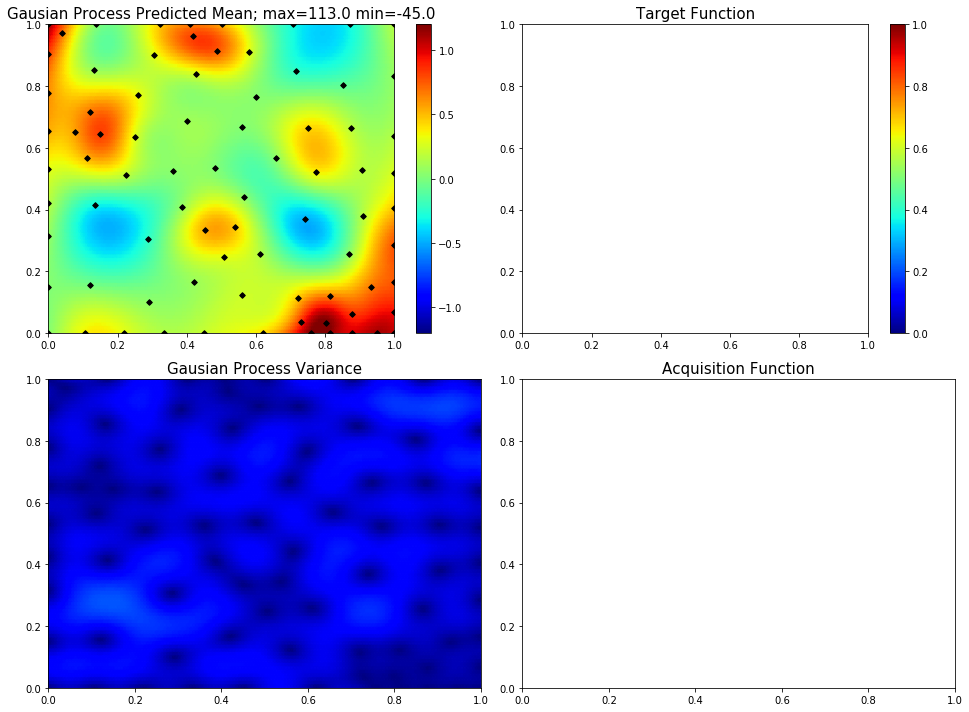

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9137469052910694, 0.9425158020862353]
25  Evaluations Remaining
|  81       | -0.02715  |  0.9137   |  0.9425   |
myplot:  081


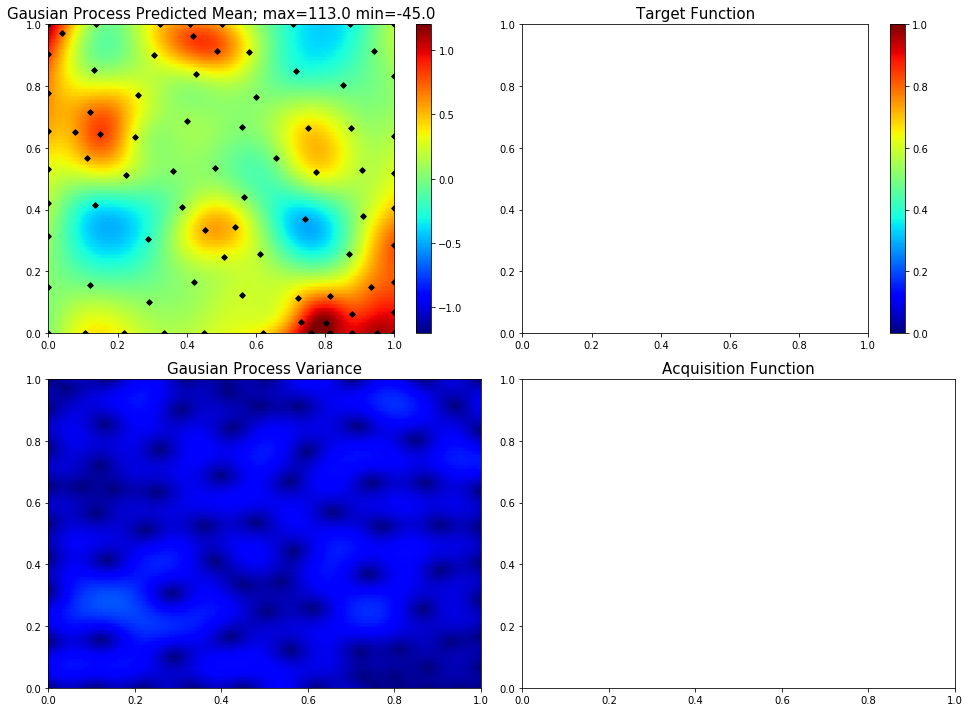

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9653424474723188, 0.0]
24  Evaluations Remaining
|  82       |  1.025    |  0.9653   |  0.0      |
myplot:  082


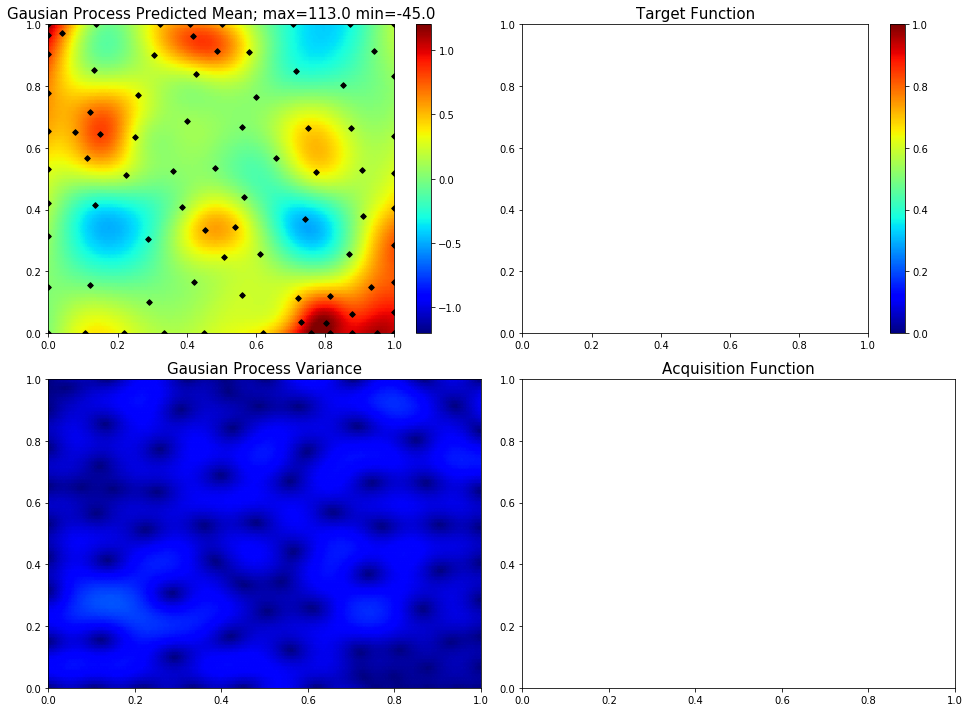

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.01429187261238321, 0.7823976570588794]
23  Evaluations Remaining
|  83       |  1.337    |  0.01429  |  0.7824   |
myplot:  083


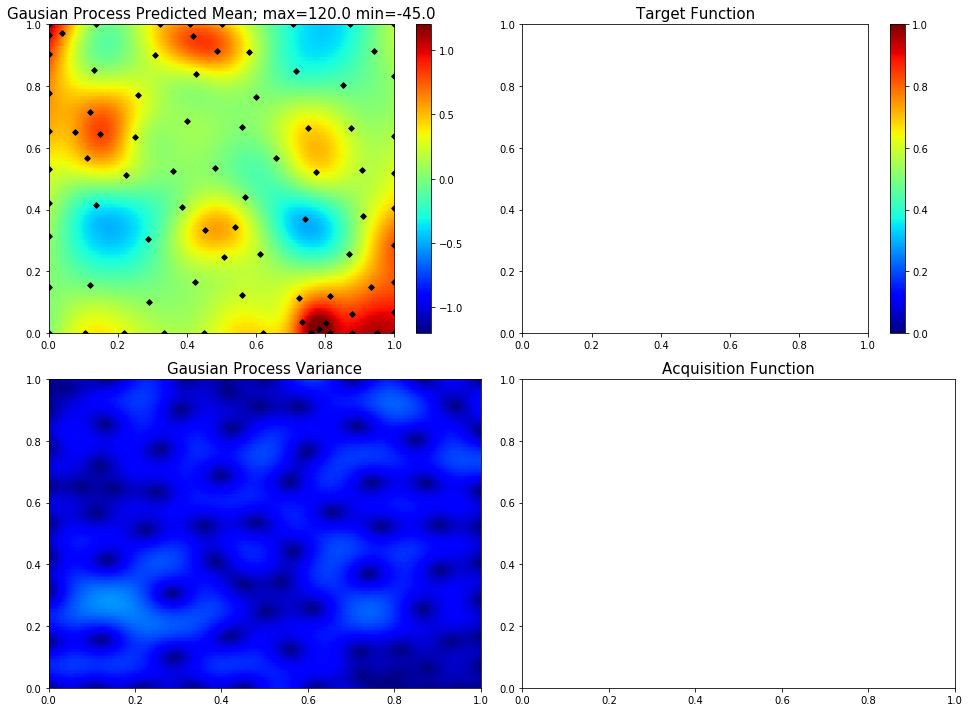

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.27100556150094396, 0.1291305083405873]
22  Evaluations Remaining
|  84       | -0.892    |  0.271    |  0.1291   |
myplot:  084


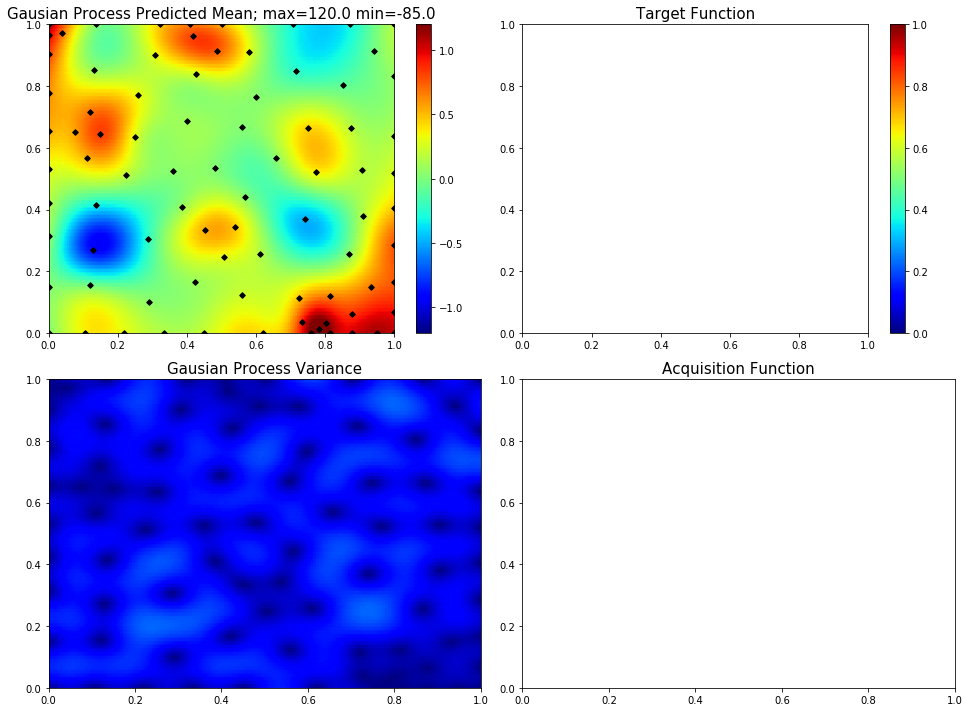

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.06918754272314913, 0.1618753727523777]
21  Evaluations Remaining
|  85       |  0.4925   |  0.06919  |  0.1619   |
myplot:  085


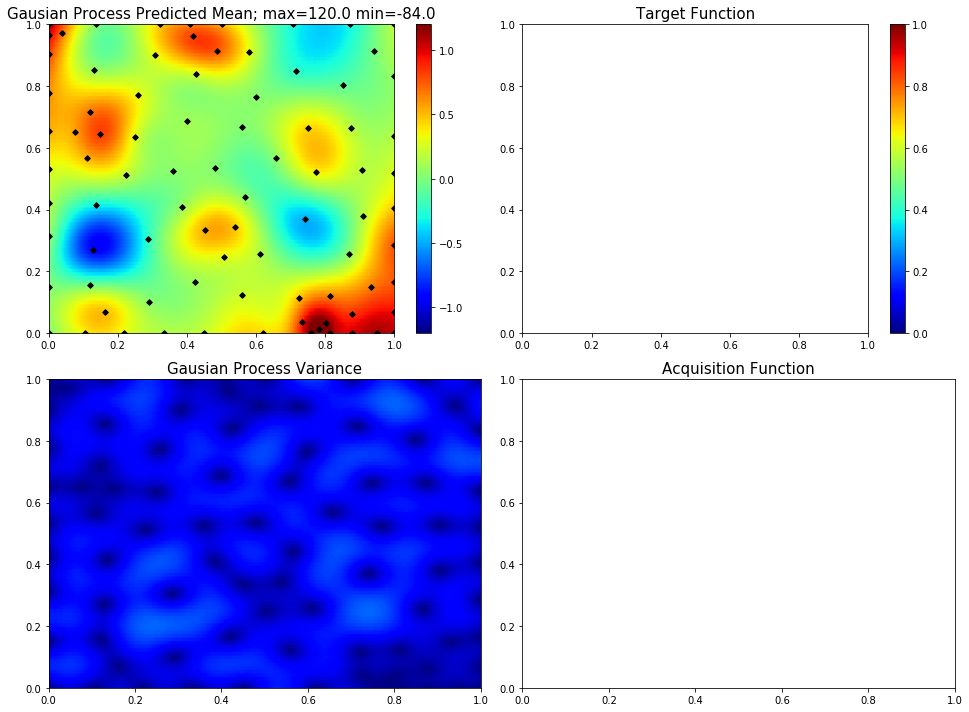

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2604061706899917, 0.3821862080236567]
20  Evaluations Remaining
|  86       |  0.2471   |  0.2604   |  0.3822   |
myplot:  086


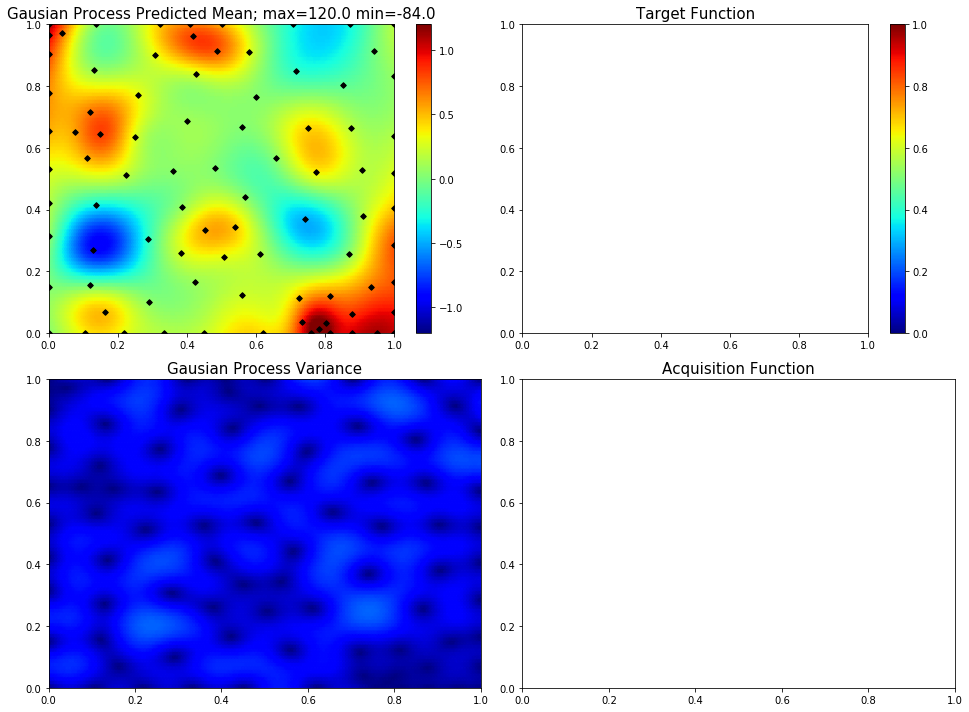

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.7845308621029459]
19  Evaluations Remaining
|  87       |  1.359    |  0.0      |  0.7845   |
myplot:  087


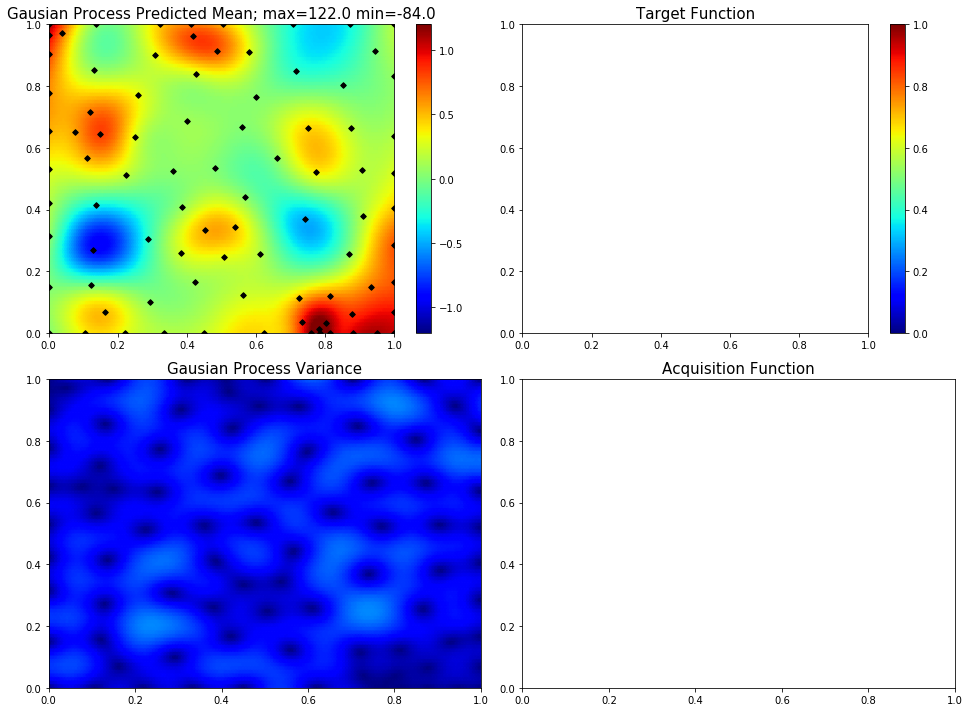

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0030238089236624965, 0.7887765268717312]
18  Evaluations Remaining
|  88       |  1.237    |  0.003024 |  0.7888   |
myplot:  088


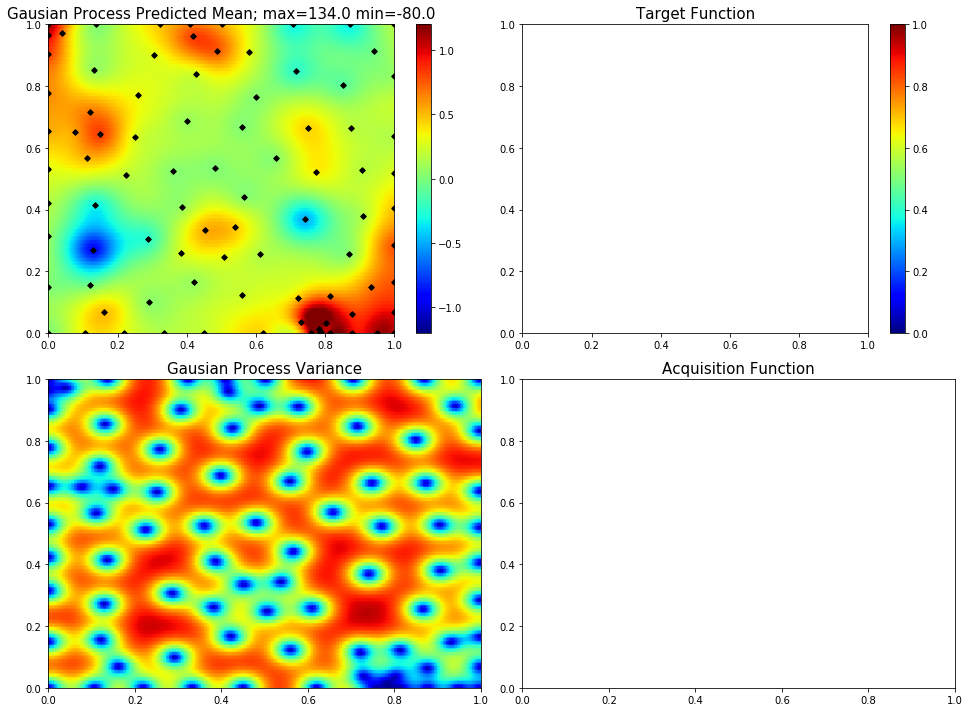

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.232804907206595, 0.7366817808553057]
17  Evaluations Remaining
|  89       | -0.1416   |  0.2328   |  0.7367   |
myplot:  089


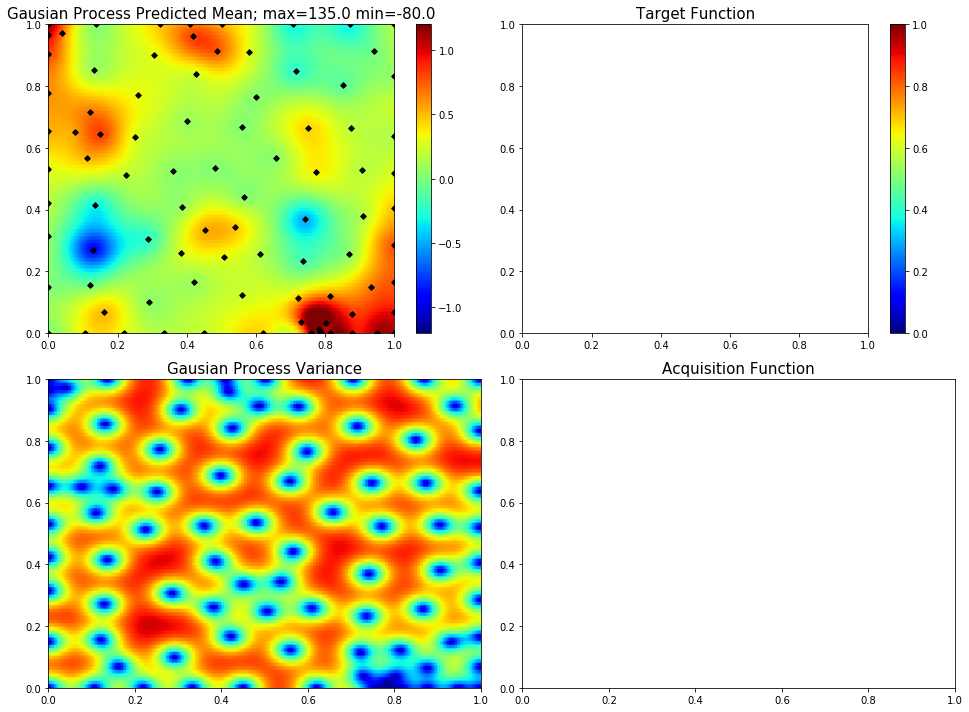

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7344201583909538, 1.0]
16  Evaluations Remaining
|  90       |  0.09376  |  0.7344   |  1.0      |
myplot:  090


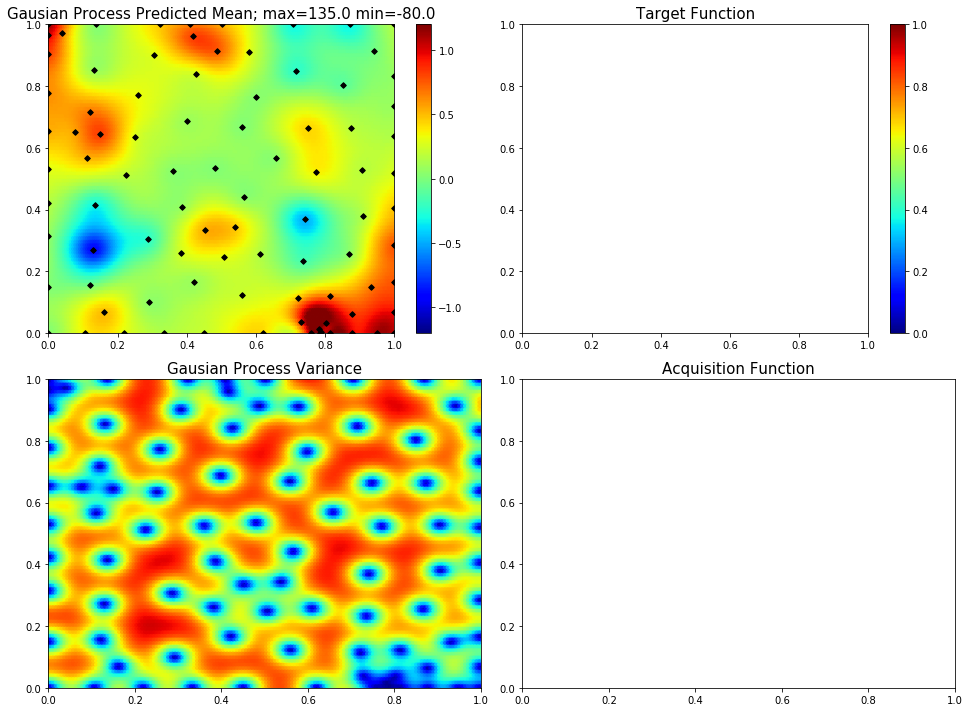

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7621359392676391, 0.49134797243912337]
15  Evaluations Remaining
|  91       |  0.109    |  0.7621   |  0.4913   |
myplot:  091


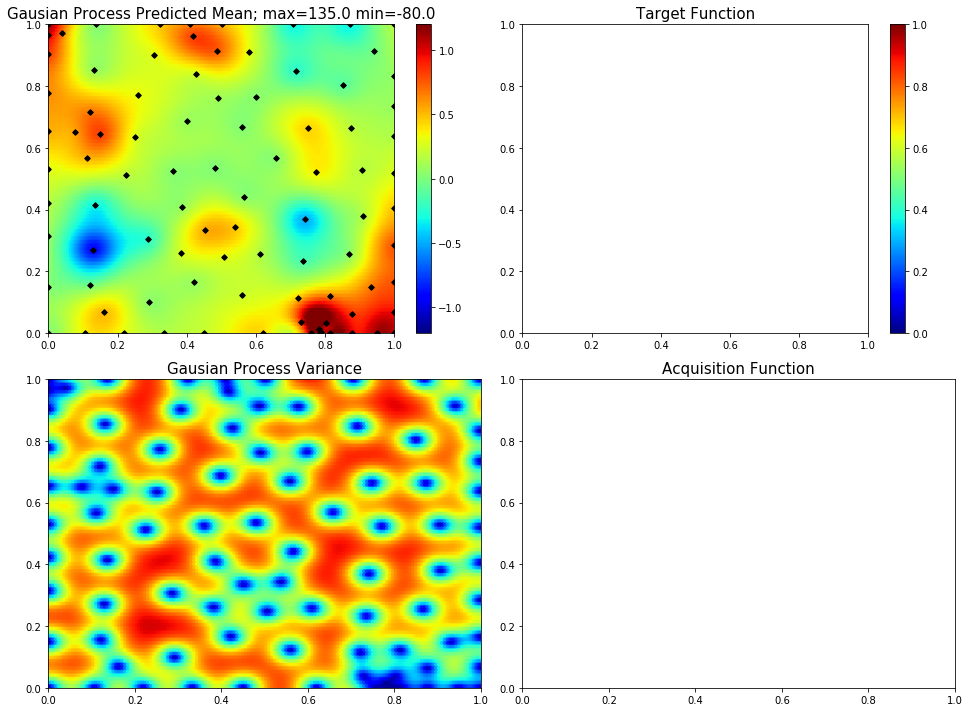

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.19383099072654897, 0.24402892810003607]
14  Evaluations Remaining
|  92       | -0.1019   |  0.1938   |  0.244    |
myplot:  092


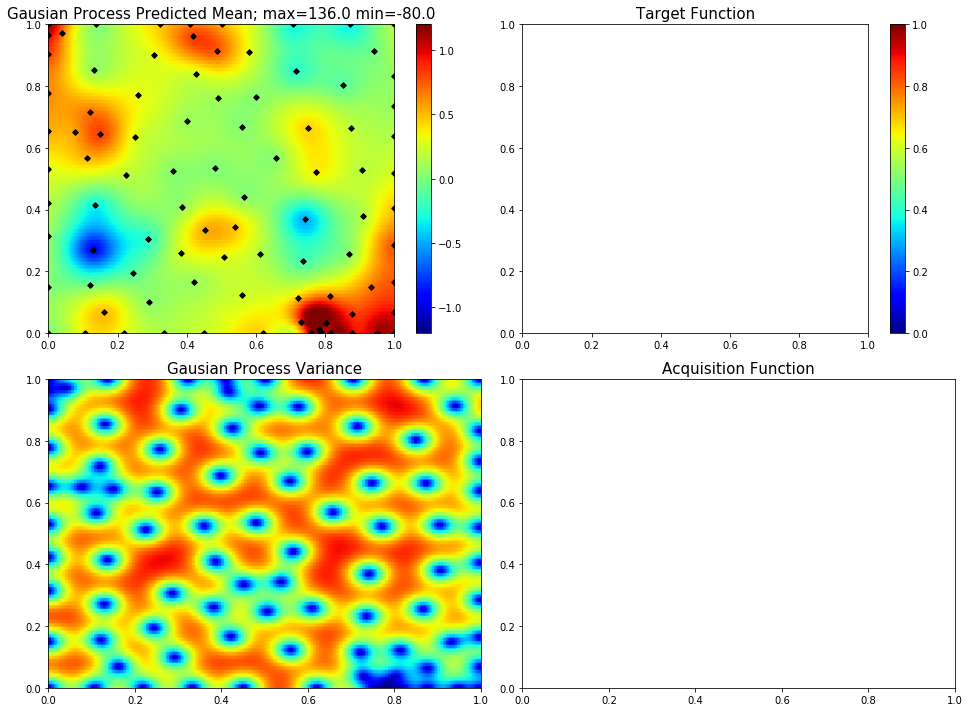

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9403789316445501, 0.21918758375805386]
13  Evaluations Remaining
|  93       | -0.213    |  0.9404   |  0.2192   |
myplot:  093


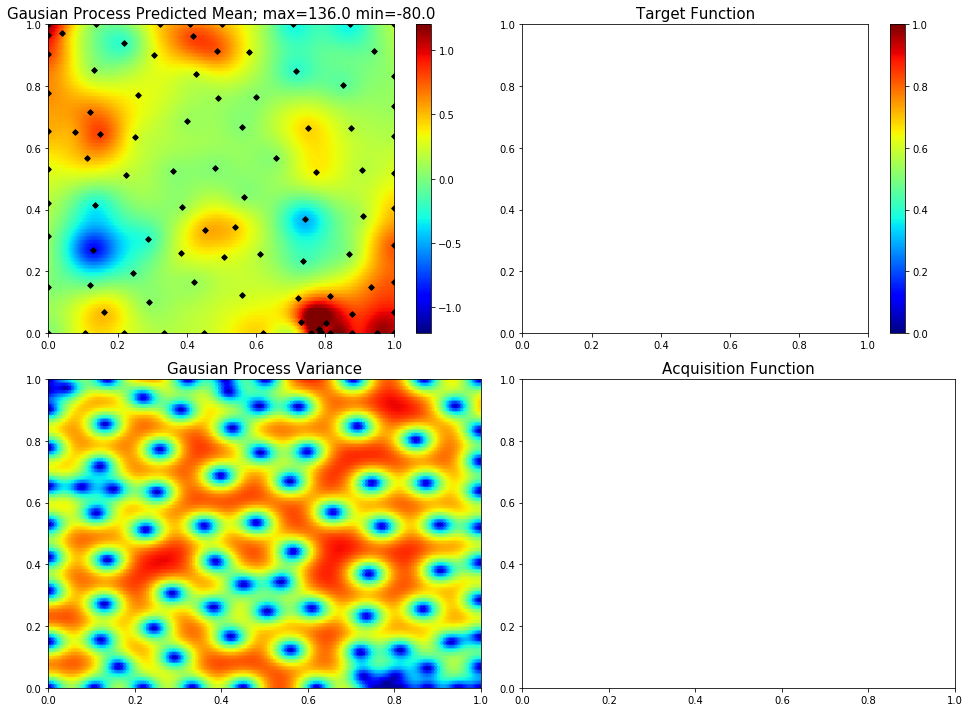

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.41881776497371775, 0.27108633975282564]
12  Evaluations Remaining
|  94       | -0.06646  |  0.4188   |  0.2711   |
myplot:  094


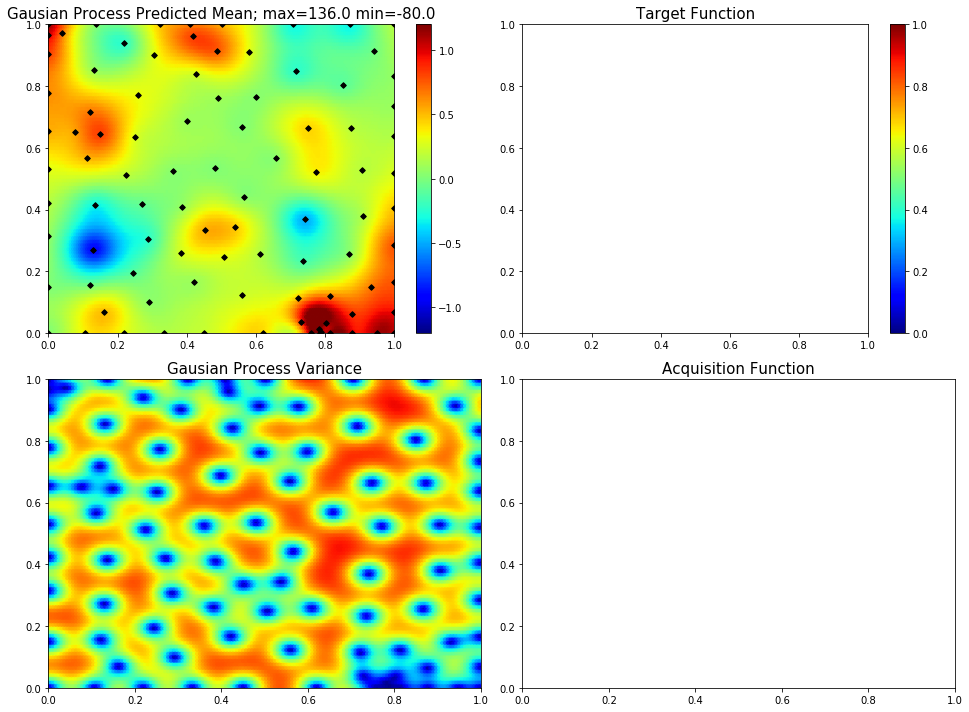

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.5389133669703745]
11  Evaluations Remaining
|  95       |  0.3471   |  0.0      |  0.5389   |
myplot:  095


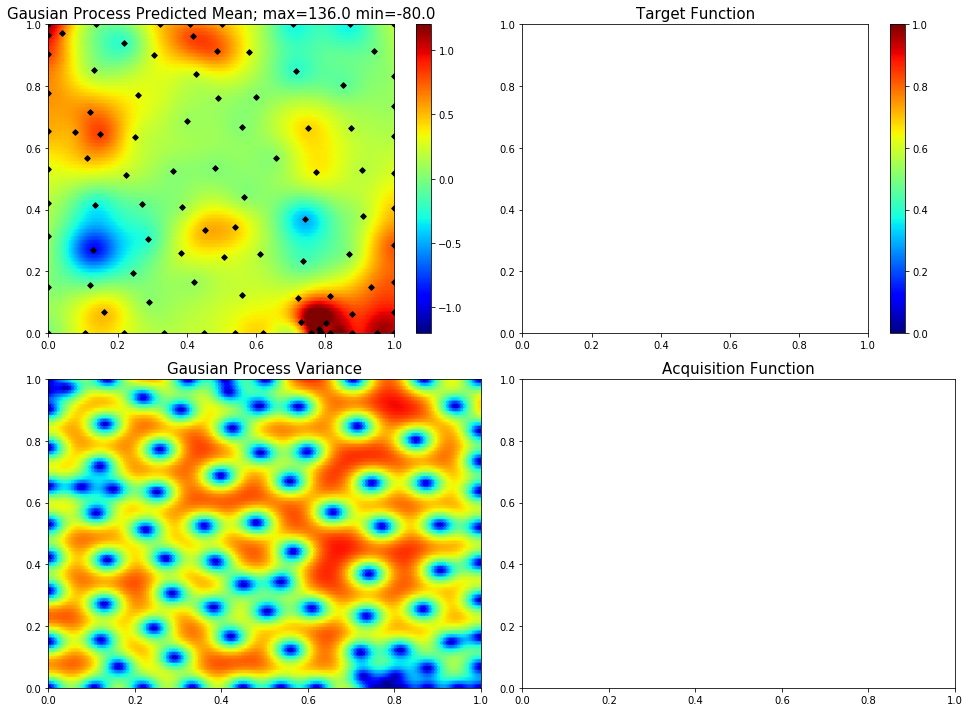

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.5964870829933232]
10  Evaluations Remaining
|  96       |  0.2871   |  1.0      |  0.5965   |
myplot:  096


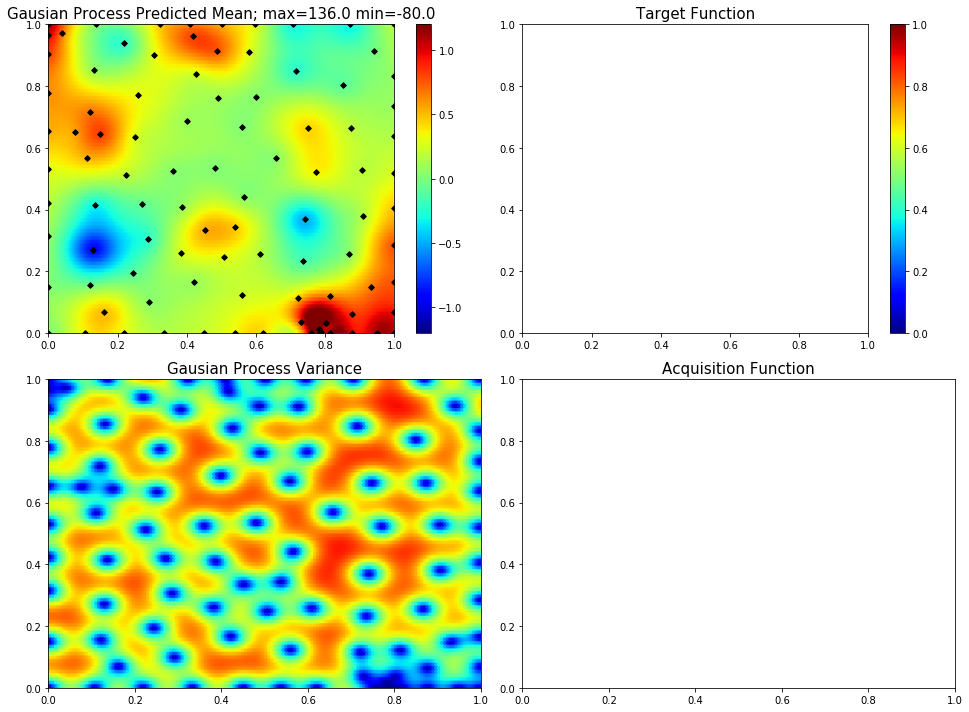

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7348051079674418, 0.7003979627108459]
9  Evaluations Remaining
|  97       |  0.07728  |  0.7348   |  0.7004   |
myplot:  097


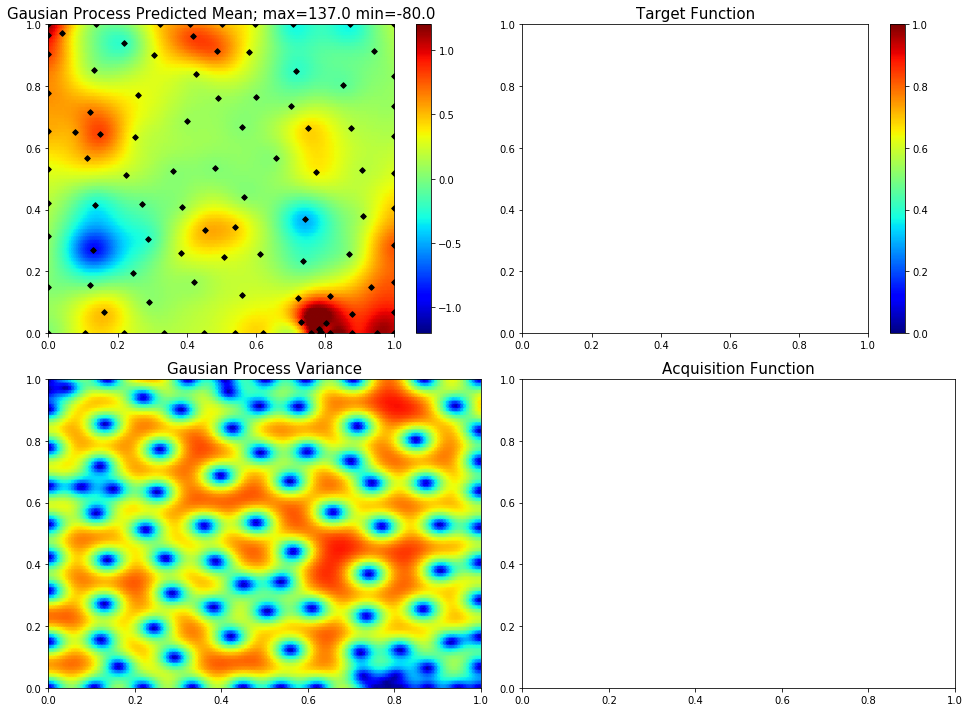

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7816404018826594, 0.348019260198065]
8  Evaluations Remaining
|  98       |  0.2047   |  0.7816   |  0.348    |
myplot:  098


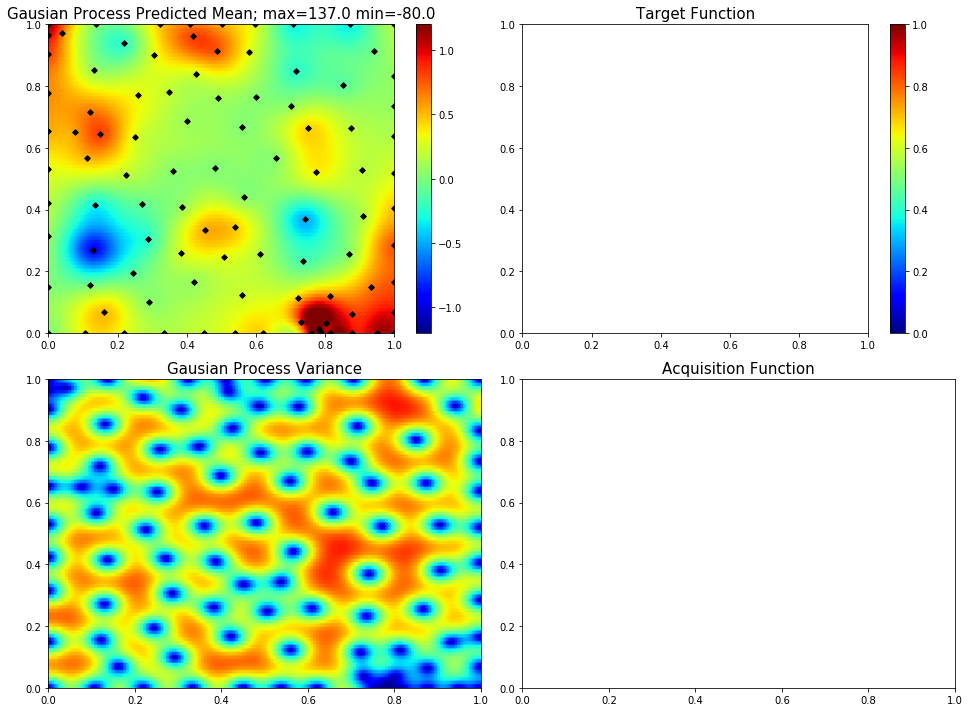

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7111258079870596, 0.19789020433491297]
7  Evaluations Remaining
|  99       |  0.5301   |  0.7111   |  0.1979   |
myplot:  099


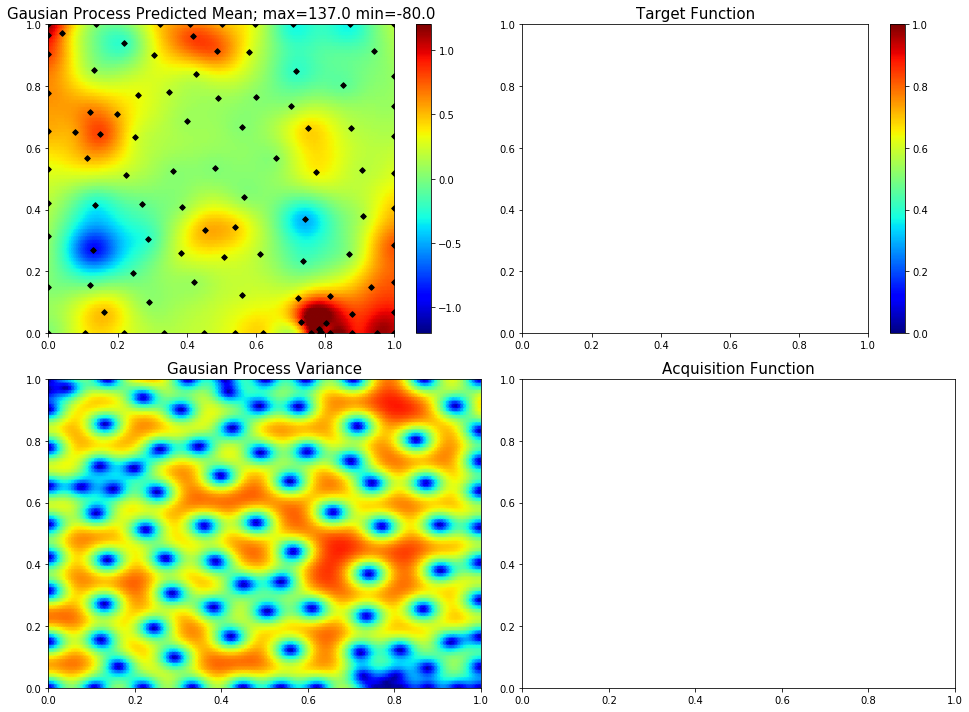

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4633550371962614, 0.6761935738914596]
6  Evaluations Remaining
|  100      |  0.02656  |  0.4634   |  0.6762   |
myplot:  100


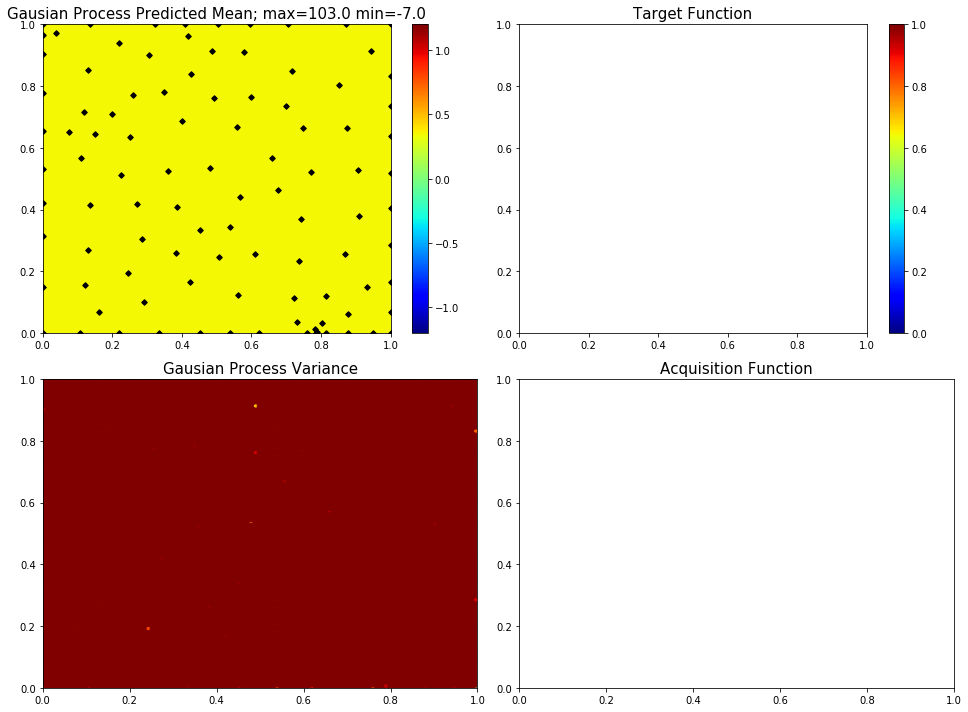

In [11]:
# Turn interactive plotting off
plt.ioff()
#policy =  [ [0.9991712478009906, 0.026881743252439638], [0.19702391566063626, 0.8142634903489118], [0.02287582405055888, 0.6499711714347374], [0.9944402045090077, 0.017507068898582667], [0.7295230492436623, 0.9926887775501024] ]

for i in range(95):
    bo.maximize(init_points=0, n_iter=1, acq='ucb', kappa=used_kappa)
    print("myplot: ", "{:03}".format(len(bo.space)) )
    plot_2d("{:03}".format(len(bo.space)))
    
    
    #invRL_score = invRL(policy)
    #if (i % 20 == 1 ): 
        #test_score = testHolePolicy(policy)
        #print("diff = ", invRL_score*90.0 - test_score)
    if (i==53):
        used_kappa = 8
    if (i==75):
        used_kappa = 7
    if (i==80):
        used_kappa = 5
    if (i==88):
        used_kappa = 3
        

In [12]:
def myRandom():
    return rand.random() # return round(rand.random(), 2)# TODO: remove this round thig # TODO run it more 

def GetRandPolicy():
    policy=[]
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()]) 
    return policy


evolution = []
policies = []
maxReward= 0.0
nbTestedPolicy = 0


In [16]:
for _ in range(50000):
    if (nbTestedPolicy % 1000 == 0 ):
        print('nbTestedPolicy',nbTestedPolicy)
    nbTestedPolicy += 1
    
    policy = {}
    policy['nwemer'] = GetRandPolicy()
    with suppress_stdout():
        potentialReward = invRL(policy['nwemer'])
    if np.sum(potentialReward)<maxReward*0.9: continue
    print(policy)
        

    policy['AvgReward'] = np.mean(potentialReward)
    policy['maxRewards'] = np.max(potentialReward)
    policy['totRewards'] = np.sum(potentialReward)
    policy['Rewards'] = potentialReward
    policies.append(policy)



    policies.sort(key=lambda r: -r['totRewards'])
    evolution.append(policies[0]['AvgReward'])
    maxReward=policies[0]['totRewards']
    print("##################################################################")
    clear_output()
    
    print('totRewards',round(policies[0]['totRewards']))
    print('rewards',policies[0]['AvgReward'])
    print('maxRewards',round(policies[0]['maxRewards']))
    print('nbTestedPolicy',nbTestedPolicy)
    
    
    if len(policies)>10: 
        policies = policies[0:9]
    print(policies)
    print("##################################################################")
    print(evolution)

totRewards 449.0
rewards 89.73296297453747
maxRewards 121.0
nbTestedPolicy 88372
[{'nwemer': [[0.017363777900124777, 0.8479028716329575], [0.7961740200410486, 0.0384155626867467], [0.0007479541597428817, 0.784541637169782], [0.6168483799846353, 0.12921609525220837], [0.07021082750169359, 0.8135289568164947]], 'AvgReward': 89.73296297453747, 'maxRewards': 121.43312305252813, 'totRewards': 448.6648148726874, 'Rewards': [array([103.92131992]), array([50.61972508]), array([121.43312305]), array([65.84038114]), array([106.85026568])]}, {'nwemer': [[0.0014498060608478802, 0.7901454626026162], [0.6791898353834519, 0.0912706440317113], [0.02393225621723486, 0.772009761068695], [0.897451024460483, 0.019135270067331032], [0.07942440232028156, 0.8954976621776467]], 'AvgReward': 87.42532980901503, 'maxRewards': 132.4497759577981, 'totRewards': 437.1266490450751, 'Rewards': [array([110.64556605]), array([57.93555217]), array([132.44977596]), array([65.27908943]), array([70.81666544])]}, {'nwemer': 

nbTestedPolicy 89000
nbTestedPolicy 90000
nbTestedPolicy 91000
nbTestedPolicy 92000
nbTestedPolicy 93000
nbTestedPolicy 94000
nbTestedPolicy 95000
nbTestedPolicy 96000
nbTestedPolicy 97000
nbTestedPolicy 98000
nbTestedPolicy 99000


In [14]:
print('totRewards',policies[0]['totRewards'])
print('rewards',policies[0]['AvgReward'])
print('maxRewards',policies[0]['maxRewards'])
print('nbTestedPolicy',nbTestedPolicy)
policies[0]

totRewards 204.43962407875455
rewards 40.88792481575091
maxRewards 78.07926724852922
nbTestedPolicy 50000


{'nwemer': [[0.31328663818396973, 0.9776861325195532],
  [0.07206449061138168, 0.011854559756869415],
  [0.015001307755673127, 0.7824223824506427],
  [0.3448629245009954, 0.07300768816008919],
  [0.04056924624498471, 0.27620473268585843]],
 'AvgReward': 40.88792481575091,
 'maxRewards': 78.07926724852922,
 'totRewards': 204.43962407875455,
 'Rewards': [array([31.59008921]),
  array([31.59008921]),
  array([78.07926725]),
  array([31.59008921]),
  array([31.59008921])]}

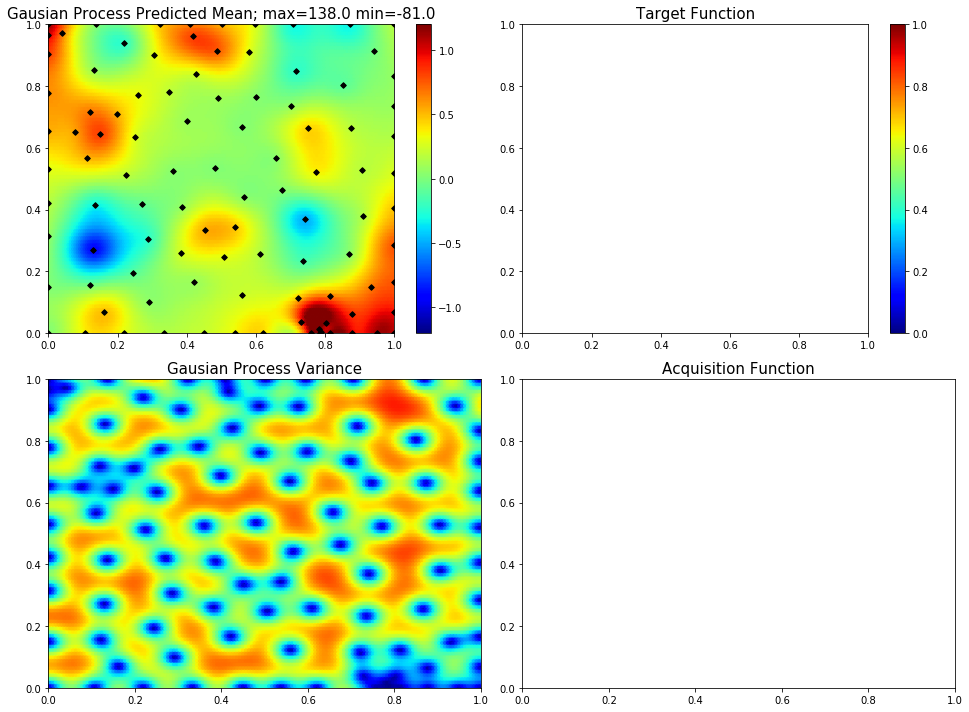

{'x': 0.5944871904530954, 'y': 0.8162948943649466}

In [57]:
plot_2d()

In [58]:

util = UtilityFunction( kind='ucb', kappa=10, xi=0.0)
print( bo.suggest(util) )

util = UtilityFunction( kind='ucb', kappa=5, xi=0.0)
print( bo.suggest(util) )


util = UtilityFunction( kind='ucb', kappa=1, xi=0.0)
print( bo.suggest(util) )


util = UtilityFunction( kind='ucb', kappa=0, xi=0.0)
print( bo.suggest(util) )

{'x': 0.9132779322727965, 'y': 0.8054447413579816}
{'x': 0.44675276000881486, 'y': 0.831669257766683}
{'x': 0.057503582136057316, 'y': 0.7729895135750687}
{'x': 0.0430189250379722, 'y': 0.7736421899044135}


In [56]:
envSeqDec = ChallengeSeqDecEnvironment()

#policy =  [ [0.9991712478009906, 0.026881743252439638], [0.19702391566063626, 0.8142634903489118], [0.02287582405055888, 0.6499711714347374], [0.9944402045090077, 0.017507068898582667], [0.7295230492436623, 0.9926887775501024] ]
policy = [[0.31328663818396973, 0.9776861325195532],
  [0.07206449061138168, 0.011854559756869415],
  [0.015001307755673127, 0.7824223824506427],
  [0.3448629245009954, 0.07300768816008919],
  [0.04056924624498471, 0.27620473268585843]]
policy= [[0.017363777900124777, 0.8479028716329575], [0.7961740200410486, 0.0384155626867467], [0.0007479541597428817, 0.784541637169782], [0.6168483799846353, 0.12921609525220837], [0.07021082750169359, 0.8135289568164947]]
policy=[[0.0014498060608478802, 0.7901454626026162], [0.6791898353834519, 0.0912706440317113], [0.02393225621723486, 0.772009761068695], [0.897451024460483, 0.019135270067331032], [0.07942440232028156, 0.8954976621776467]]
policy=[[0.06532976733282991, 0.8687345318407067], [0.4865239879760457, 0.11761979547307863], [0.02449963006843666, 0.7640924632117153], [0.9418943242247545, 0.0012583247711476753], [0.05601557278101282, 0.7674708685872119]]
invRL_score,_ = invRL(policy)
test_score,_ = testHolePolicy(policy)
#print("diff = ", invRL_score*90.0 - test_score)

print("expected = ", np.sum(invRL_score)," found= ", np.sum(test_score)  )
#invRL_score - test_score
print("diff = ", [ abs(x - y) for x,y in zip(invRL_score,test_score) ]  )
print("diff = ", np.sum([ abs(x - y) for x,y in zip(invRL_score,test_score) ]  ) ) 

invRL y 1 :  79.0  +-  3
invRL y 2 :  16.0  +-  6
invRL y 3 :  99.0  +-  3
invRL y 4 :  80.0  +-  4
invRL y 5 :  124.0  +-  2
105  Evaluations Remaining
test y 1 :  83
104  Evaluations Remaining
test y 2 :  13
103  Evaluations Remaining
test y 3 :  86
102  Evaluations Remaining
test y 4 :  86
101  Evaluations Remaining
test y 5 :  109
expected =  399.22472103334997  found=  376.3634484586396
diff =  [array([3.66119296]), array([3.63349196]), array([13.31153901]), array([5.64714132]), array([15.22457588])]
diff =  41.47794112871123


expected =  203.93386223341972  found=  188.31119315508116
diff =  [array([5.95308709]), array([6.2444974]), array([11.48535667]), array([0.9681735]), array([4.81407559])]
diff =  29.465190256992713
